In [ ]:
# Installing roboflow library 
!pip install roboflow

  Using cached roboflow-1.2.6-py3-none-any.whl.metadata (9.7 kB)
  Using cached certifi-2025.8.3-py3-none-any.whl.metadata (2.4 kB)
  Using cached idna-3.7-py3-none-any.whl.metadata (9.9 kB)
  Using cached cycler-0.12.1-py3-none-any.whl.metadata (3.8 kB)
  Using cached kiwisolver-1.4.9-cp311-cp311-win_amd64.whl.metadata (6.4 kB)
  Using cached matplotlib-3.10.5-cp311-cp311-win_amd64.whl.metadata (11 kB)
  Using cached numpy-2.3.2-cp311-cp311-win_amd64.whl.metadata (60 kB)
INFO: pip is looking at multiple versions of roboflow to determine which version is compatible with other requirements. This could take a while.
  Using cached roboflow-1.2.5-py3-none-any.whl.metadata (9.7 kB)
  Using cached roboflow-1.2.4-py3-none-any.whl.metadata (9.7 kB)
  Using cached roboflow-1.2.1-py3-none-any.whl.metadata (9.7 kB)
INFO: pip is still looking at multiple versions of roboflow to determine which version is compatible with other requirements. This could take a while.
  Using cached roboflow-1.1.66-p

ERROR: Exception:
Traceback (most recent call last):
  File "d:\ASTC project\.venv\Lib\site-packages\pip\_internal\cli\base_command.py", line 107, in _run_wrapper
    status = _inner_run()
             ^^^^^^^^^^^^
  File "d:\ASTC project\.venv\Lib\site-packages\pip\_internal\cli\base_command.py", line 98, in _inner_run
    return self.run(options, args)
           ^^^^^^^^^^^^^^^^^^^^^^^
  File "d:\ASTC project\.venv\Lib\site-packages\pip\_internal\cli\req_command.py", line 71, in wrapper
    return func(self, options, args)
           ^^^^^^^^^^^^^^^^^^^^^^^^^
  File "d:\ASTC project\.venv\Lib\site-packages\pip\_internal\commands\install.py", line 393, in run
    requirement_set = resolver.resolve(
                      ^^^^^^^^^^^^^^^^^
  File "d:\ASTC project\.venv\Lib\site-packages\pip\_internal\resolution\resolvelib\resolver.py", line 98, in resolve
    result = self._result = resolver.resolve(
                            ^^^^^^^^^^^^^^^^^
  File "d:\ASTC project\.venv\Lib\site-p

In [1]:
import torch

print(torch.cuda.is_available())  # Returns True if CUDA is available, else False

True


In [ ]:
from roboflow import Roboflow
rf = Roboflow(api_key="Kl0zacUMgzHFXKRFAFtJ")
project = rf.workspace("project-saocp").project("pothole-2-mhkce")
version = project.version(3)
dataset = version.download("yolov11")

# Downloading the dataset from roboflow universe using api key 
                

loading Roboflow workspace...
loading Roboflow project...



Extracting Dataset Version Zip to Pothole-2-3 in yolov11:: 100%|██████████| 22896/22896 [00:05<00:00, 4316.96it/s]


16 August 2025

In [ ]:
from roboflow import Roboflow
rf = Roboflow(api_key="Kl0zacUMgzHFXKRFAFtJ")
project = rf.workspace("smartathon").project("new-pothole-detection")
version = project.version(2)
dataset = version.download("yolov11")
# Downloading the dataset from roboflow universe using api key 

loading Roboflow workspace...
loading Roboflow project...



Extracting Dataset Version Zip to New-pothole-detection-2 in yolov11:: 100%|██████████| 18492/18492 [00:04<00:00, 4536.93it/s]


In [3]:
!pip install ultralytics 


  Using cached opencv_python-4.12.0.88-cp37-abi3-win_amd64.whl.metadata (19 kB)
  Using cached scipy-1.16.1-cp311-cp311-win_amd64.whl.metadata (60 kB)
  Using cached py_cpuinfo-9.0.0-py3-none-any.whl.metadata (794 bytes)
  Using cached pandas-2.3.1-cp311-cp311-win_amd64.whl.metadata (19 kB)
  Using cached numpy-2.2.6-cp311-cp311-win_amd64.whl.metadata (60 kB)
  Using cached pytz-2025.2-py2.py3-none-any.whl.metadata (22 kB)
  Using cached tzdata-2025.2-py2.py3-none-any.whl.metadata (1.4 kB)
  Using cached sympy-1.14.0-py3-none-any.whl.metadata (12 kB)
  Using cached networkx-3.5-py3-none-any.whl.metadata (6.3 kB)
  Using cached jinja2-3.1.6-py3-none-any.whl.metadata (2.9 kB)
  Using cached fsspec-2025.7.0-py3-none-any.whl.metadata (12 kB)
  Using cached mpmath-1.3.0-py3-none-any.whl.metadata (8.6 kB)
  Using cached MarkupSafe-3.0.2-cp311-cp311-win_amd64.whl.metadata (4.1 kB)
   ---------------------------------------- 0.0/1.0 MB ? eta -:--:--
   ---------------------------------------- 

In [ ]:
!pip install opencv-python 
# !pip install os

ERROR: Could not find a version that satisfies the requirement os (from versions: none)
ERROR: No matching distribution found for os


17 August 2025


In [19]:
import cv2
import os
# Using opencv and yolo dimensions for annotation 
# Paths
images_folder = r"D:\ASTC project\New-pothole-detection-2\train\images"
labels_folder = r"D:\ASTC project\New-pothole-detection-2\train\labels"
output_folder = "annotated_images"
os.makedirs(output_folder, exist_ok=True)

# Loop through images
for img_file in os.listdir(images_folder):
    if not img_file.lower().endswith((".jpg", ".png", ".jpeg")):
        continue

    img_path = os.path.join(images_folder, img_file)
    label_path = os.path.join(labels_folder, os.path.splitext(img_file)[0] + ".txt")

    img = cv2.imread(img_path)
    if img is None:
        print(f"{img_file} not found")
        continue

    h, w, _ = img.shape
    with open(label_path, "r") as f:
        for line in f:
            parts = line.strip().split()
            if len(parts) > 5:
                continue 
            class_id, x_center, y_center, bw, bh = map(float, line.split())
            class_id = int(class_id)

            xmin = int((x_center - bw / 2) * w)
            xmax = int((x_center + bw / 2) * w)
            ymin = int((y_center - bh / 2) * h)
            ymax = int((y_center + bh / 2) * h)

            cv2.rectangle(img, (xmin, ymin), (xmax, ymax), (255, 0, 0), 2)
            cv2.putText(img,"",(xmin, ymin - 5), cv2.FONT_HERSHEY_SIMPLEX,
                        0.7, (0, 255, 0), 2)
# saving each file into output folder

    out_path = os.path.join(output_folder, img_file)
    cv2.imwrite(out_path, img)

18 August 2025

In [1]:
import cv2
import os
# Using opencv and yolo dimensions for annotation 
# Paths
images_folder = r"D:\ASTC project\Pothole-2-3\train\images"
labels_folder = r"D:\ASTC project\Pothole-2-3\train\labels"
output_folder = "annotated_images_Pothole-2-3"
os.makedirs(output_folder, exist_ok=True)

# Loop through images
for img_file in os.listdir(images_folder):
    if not img_file.lower().endswith((".jpg", ".png", ".jpeg")):
        continue

    img_path = os.path.join(images_folder, img_file)
    label_path = os.path.join(labels_folder, os.path.splitext(img_file)[0] + ".txt")

    img = cv2.imread(img_path)
    if img is None:
        print(f"{img_file} not found")
        continue

    h, w, _ = img.shape
    with open(label_path, "r") as f:
        for line in f:
            parts = line.strip().split()
            if len(parts) > 5:
                continue 
            class_id, x_center, y_center, bw, bh = map(float, line.split())
            class_id = int(class_id)

            xmin = int((x_center - bw / 2) * w)
            xmax = int((x_center + bw / 2) * w)
            ymin = int((y_center - bh / 2) * h)
            ymax = int((y_center + bh / 2) * h)

            cv2.rectangle(img, (xmin, ymin), (xmax, ymax), (255, 0, 0), 2)
            cv2.putText(img,"",(xmin, ymin - 5), cv2.FONT_HERSHEY_SIMPLEX,
                        0.7, (0, 255, 0), 2)
# saving each file into output folder

    out_path = os.path.join(output_folder, img_file)
    cv2.imwrite(out_path, img)

# using yolov11 model for training 

In [2]:
!nvidia-smi

Mon Aug 18 16:41:09 2025       
+-----------------------------------------------------------------------------------------+
| NVIDIA-SMI 580.97                 Driver Version: 580.97         CUDA Version: 13.0     |
+-----------------------------------------+------------------------+----------------------+
| GPU  Name                  Driver-Model | Bus-Id          Disp.A | Volatile Uncorr. ECC |
| Fan  Temp   Perf          Pwr:Usage/Cap |           Memory-Usage | GPU-Util  Compute M. |
|                                         |                        |               MIG M. |
|=========================================+========================+======================|
|   0  NVIDIA GeForce RTX 3050 ...  WDDM  |   00000000:01:00.0 Off |                  N/A |
| N/A   61C    P0             18W /   75W |       0MiB /   6144MiB |      0%      Default |
|                                         |                        |                  N/A |
+-----------------------------------------+-----

In [ ]:
# Setting up cuda and environment and installing dependencies for model training

In [1]:
import torch
print("CUDA available:", torch.cuda.is_available())
print("PyTorch CUDA version:", torch.version.cuda)
print("Device count:", torch.cuda.device_count())


CUDA available: True
PyTorch CUDA version: 12.1
Device count: 1


In [13]:
from ultralytics import YOLO
import os
os.environ["CUDA_LAUNCH_BLOCKING"] = "1"
model = YOLO("yolo11n.pt")
model.train(data="D:\ASTC project\Pothole-2-3\data.yaml",epochs = 40 ,imgsz= 640, batch = 16,name = "yolon_final")


New https://pypi.org/project/ultralytics/8.3.182 available  Update with 'pip install -U ultralytics'
Ultralytics 8.3.179  Python-3.11.9 torch-2.5.1+cu121 CUDA:0 (NVIDIA GeForce RTX 3050 6GB Laptop GPU, 6144MiB)
engine\trainer: agnostic_nms=False, amp=True, augment=False, auto_augment=randaugment, batch=16, bgr=0.0, box=7.5, cache=False, cfg=None, classes=None, close_mosaic=10, cls=0.5, conf=None, copy_paste=0.0, copy_paste_mode=flip, cos_lr=False, cutmix=0.0, data=D:\ASTC project\Pothole-2-3\data.yaml, degrees=0.0, deterministic=True, device=None, dfl=1.5, dnn=False, dropout=0.0, dynamic=False, embed=None, epochs=40, erasing=0.4, exist_ok=False, fliplr=0.5, flipud=0.0, format=torchscript, fraction=1.0, freeze=None, half=False, hsv_h=0.015, hsv_s=0.7, hsv_v=0.4, imgsz=640, int8=False, iou=0.7, keras=False, kobj=1.0, line_width=None, lr0=0.01, lrf=0.01, mask_ratio=4, max_det=300, mixup=0.0, mode=train, model=yolo11n.pt, momentum=0.937, mosaic=1.0, multi_scale=False, name=yolon_final, nbs

train: Scanning D:\ASTC project\Pothole-2-3\train\labels.cache... 1116 images, 1 backgrounds, 0 corrupt: 100%|██████████| 1116/1116 [00:00<?, ?it/s]

WARNING Box and segment counts should be equal, but got len(segments) = 7, len(boxes) = 2688. To resolve this only boxes will be used and all segments will be removed. To avoid this please supply either a detect or segment dataset, not a detect-segment mixed dataset.


val: Fast image access  (ping: 0.30.0 ms, read: 86.19.3 MB/s, size: 63.7 KB)


val: Scanning D:\ASTC project\Pothole-2-3\valid\labels.cache... 587 images, 1 backgrounds, 0 corrupt: 100%|██████████| 587/587 [00:00<?, ?it/s]


Plotting labels to runs\detect\yolon_final\labels.jpg... 
optimizer: 'optimizer=auto' found, ignoring 'lr0=0.01' and 'momentum=0.937' and determining best 'optimizer', 'lr0' and 'momentum' automatically... 
optimizer: AdamW(lr=0.001667, momentum=0.9) with parameter groups 81 weight(decay=0.0), 88 weight(decay=0.0005), 87 bias(decay=0.0)
Image sizes 640 train, 640 val
Using 8 dataloader workers
Logging results to runs\detect\yolon_final
Starting training for 40 epochs...

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       1/40      2.27G      2.062      3.528      1.946         63        640: 100%|██████████| 70/70 [00:34<00:00,  2.01it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 19/19 [00:09<00:00,  2.08it/s]

                   all        587       1384      0.849     0.0122     0.0584     0.0254



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       2/40      2.73G      2.091      2.925      1.943         33        640: 100%|██████████| 70/70 [00:35<00:00,  1.96it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 19/19 [00:15<00:00,  1.19it/s]


                   all        587       1384      0.223       0.13     0.0797     0.0243

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       3/40      2.73G      2.075      2.753      1.972         61        640: 100%|██████████| 70/70 [01:59<00:00,  1.70s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 19/19 [00:46<00:00,  2.43s/it]


                   all        587       1384      0.047      0.109     0.0228    0.00767

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       4/40      2.73G      2.081      2.634      1.961         47        640: 100%|██████████| 70/70 [02:08<00:00,  1.83s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 19/19 [00:50<00:00,  2.65s/it]


                   all        587       1384      0.131      0.266     0.0938      0.032

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       5/40      2.73G      1.989      2.409      1.907         50        640: 100%|██████████| 70/70 [01:52<00:00,  1.61s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 19/19 [00:44<00:00,  2.32s/it]


                   all        587       1384      0.341      0.305       0.23     0.0848

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       6/40      2.73G      1.976      2.362      1.893         27        640: 100%|██████████| 70/70 [02:17<00:00,  1.96s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 19/19 [00:23<00:00,  1.22s/it]


                   all        587       1384      0.372       0.27      0.245     0.0985

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       7/40      2.73G      1.968       2.32      1.863         38        640: 100%|██████████| 70/70 [02:04<00:00,  1.78s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 19/19 [00:34<00:00,  1.79s/it]

                   all        587       1384      0.483      0.242      0.245     0.0903



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       8/40      2.73G       1.91       2.22      1.846         56        640: 100%|██████████| 70/70 [02:04<00:00,  1.78s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 19/19 [00:35<00:00,  1.87s/it]


                   all        587       1384      0.628      0.406      0.463      0.183

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       9/40      2.73G      1.858      2.127      1.808         28        640: 100%|██████████| 70/70 [01:27<00:00,  1.25s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 19/19 [00:21<00:00,  1.13s/it]


                   all        587       1384      0.359      0.319      0.302      0.121

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      10/40      2.73G      1.856      2.095      1.799         45        640: 100%|██████████| 70/70 [01:17<00:00,  1.11s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 19/19 [00:27<00:00,  1.46s/it]


                   all        587       1384      0.606      0.384       0.42      0.195

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      11/40      2.73G      1.819      2.003      1.763         26        640: 100%|██████████| 70/70 [00:33<00:00,  2.11it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 19/19 [00:03<00:00,  5.50it/s]

                   all        587       1384      0.433      0.364      0.326      0.126



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      12/40      2.73G      1.828      2.041      1.766         51        640: 100%|██████████| 70/70 [00:13<00:00,  5.34it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 19/19 [00:03<00:00,  5.42it/s]

                   all        587       1384      0.783      0.369      0.479      0.219



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      13/40      2.73G      1.806      1.923      1.723         40        640: 100%|██████████| 70/70 [00:13<00:00,  5.33it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 19/19 [00:03<00:00,  5.47it/s]

                   all        587       1384      0.472      0.434      0.403      0.187



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      14/40      2.73G      1.786      1.916      1.728         61        640: 100%|██████████| 70/70 [00:13<00:00,  5.34it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 19/19 [00:03<00:00,  5.39it/s]

                   all        587       1384      0.611      0.472      0.527      0.251



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      15/40      2.73G      1.778      1.887      1.733         50        640: 100%|██████████| 70/70 [00:13<00:00,  5.31it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 19/19 [00:03<00:00,  5.45it/s]

                   all        587       1384      0.543      0.457      0.447      0.207



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      16/40      2.73G      1.704      1.804      1.653         55        640: 100%|██████████| 70/70 [00:13<00:00,  5.32it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 19/19 [00:03<00:00,  5.55it/s]

                   all        587       1384      0.577      0.402      0.442      0.214



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      17/40      2.73G      1.684      1.781      1.661         46        640: 100%|██████████| 70/70 [00:13<00:00,  5.33it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 19/19 [00:03<00:00,  5.45it/s]

                   all        587       1384      0.541       0.53      0.514      0.236



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      18/40      2.73G      1.703      1.801      1.677         30        640: 100%|██████████| 70/70 [00:13<00:00,  5.34it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 19/19 [00:03<00:00,  5.50it/s]

                   all        587       1384      0.613      0.486      0.533      0.245



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      19/40      2.73G      1.667      1.752       1.65         46        640: 100%|██████████| 70/70 [00:13<00:00,  5.34it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 19/19 [00:03<00:00,  5.54it/s]

                   all        587       1384      0.647      0.436      0.508      0.249



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      20/40      2.73G      1.655      1.699      1.631         54        640: 100%|██████████| 70/70 [00:13<00:00,  5.04it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 19/19 [00:03<00:00,  5.31it/s]

                   all        587       1384      0.551      0.466      0.452      0.209



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      21/40      2.73G      1.632      1.687      1.631         38        640: 100%|██████████| 70/70 [00:13<00:00,  5.30it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 19/19 [00:03<00:00,  5.49it/s]

                   all        587       1384      0.578      0.502      0.513      0.239



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      22/40      2.73G      1.613      1.622      1.593         36        640: 100%|██████████| 70/70 [00:13<00:00,  5.29it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 19/19 [00:03<00:00,  5.58it/s]

                   all        587       1384      0.589      0.501      0.526      0.263



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      23/40      2.73G       1.62      1.623      1.599         49        640: 100%|██████████| 70/70 [00:13<00:00,  5.12it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 19/19 [00:03<00:00,  5.15it/s]

                   all        587       1384      0.708      0.484      0.555      0.267



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      24/40      2.73G      1.619      1.609      1.619         48        640: 100%|██████████| 70/70 [00:13<00:00,  5.24it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 19/19 [00:03<00:00,  5.21it/s]

                   all        587       1384      0.686      0.491      0.546      0.265



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      25/40      2.73G      1.582      1.563      1.571         30        640: 100%|██████████| 70/70 [00:13<00:00,  5.24it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 19/19 [00:03<00:00,  5.40it/s]

                   all        587       1384      0.647      0.547      0.603      0.305



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      26/40      2.73G      1.536      1.513      1.552         51        640: 100%|██████████| 70/70 [00:13<00:00,  5.24it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 19/19 [00:03<00:00,  5.25it/s]

                   all        587       1384      0.671      0.562       0.62      0.311



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      27/40      2.73G      1.536      1.494      1.553         54        640: 100%|██████████| 70/70 [00:13<00:00,  5.22it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 19/19 [00:03<00:00,  5.34it/s]

                   all        587       1384       0.54      0.587       0.57      0.284



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      28/40      2.73G      1.525      1.478      1.543         26        640: 100%|██████████| 70/70 [00:15<00:00,  4.43it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 19/19 [00:07<00:00,  2.47it/s]

                   all        587       1384       0.61      0.597      0.607      0.325



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      29/40      2.73G      1.521      1.421      1.531         45        640: 100%|██████████| 70/70 [00:20<00:00,  3.42it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 19/19 [00:03<00:00,  5.64it/s]

                   all        587       1384      0.697      0.467      0.541       0.29



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      30/40      2.73G      1.465      1.394      1.508         30        640: 100%|██████████| 70/70 [00:13<00:00,  5.37it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 19/19 [00:03<00:00,  5.53it/s]

                   all        587       1384      0.685      0.589      0.632       0.33


Closing dataloader mosaic

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      31/40      2.73G      1.481      1.362       1.54         23        640: 100%|██████████| 70/70 [00:16<00:00,  4.32it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 19/19 [00:04<00:00,  4.36it/s]

                   all        587       1384       0.71        0.6      0.627      0.322



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      32/40      2.73G      1.441      1.309      1.514         36        640: 100%|██████████| 70/70 [00:12<00:00,  5.39it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 19/19 [00:03<00:00,  5.62it/s]

                   all        587       1384       0.71      0.604      0.648      0.339



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      33/40      2.73G      1.432      1.274      1.513         26        640: 100%|██████████| 70/70 [00:13<00:00,  5.37it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 19/19 [00:03<00:00,  5.61it/s]

                   all        587       1384      0.733      0.596      0.667      0.359



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      34/40      2.73G       1.39      1.235      1.482         38        640: 100%|██████████| 70/70 [00:13<00:00,  5.38it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 19/19 [00:03<00:00,  5.44it/s]

                   all        587       1384      0.739      0.596      0.676      0.362



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      35/40      2.73G      1.372      1.208      1.462         27        640: 100%|██████████| 70/70 [00:13<00:00,  5.32it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 19/19 [00:03<00:00,  5.59it/s]

                   all        587       1384      0.728      0.628      0.689      0.376



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      36/40      2.73G      1.329      1.159      1.432         47        640: 100%|██████████| 70/70 [00:13<00:00,  5.34it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 19/19 [00:03<00:00,  5.55it/s]

                   all        587       1384      0.696      0.622      0.673       0.38



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      37/40      2.73G      1.312      1.126       1.42         31        640: 100%|██████████| 70/70 [00:13<00:00,  5.32it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 19/19 [00:03<00:00,  5.43it/s]

                   all        587       1384      0.723      0.568      0.658      0.372



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      38/40      2.73G      1.302      1.108      1.402         25        640: 100%|██████████| 70/70 [00:13<00:00,  5.27it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 19/19 [00:03<00:00,  5.50it/s]

                   all        587       1384      0.731      0.612      0.691       0.39



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      39/40      2.73G      1.265      1.082      1.395         30        640: 100%|██████████| 70/70 [00:13<00:00,  5.27it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 19/19 [00:03<00:00,  5.43it/s]

                   all        587       1384      0.756      0.623      0.701        0.4



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      40/40      2.73G      1.262      1.055      1.389         27        640: 100%|██████████| 70/70 [00:13<00:00,  5.30it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 19/19 [00:03<00:00,  5.24it/s]

                   all        587       1384      0.737      0.636      0.701      0.394



40 epochs completed in 0.561 hours.
Optimizer stripped from runs\detect\yolon_final\weights\last.pt, 5.5MB
Optimizer stripped from runs\detect\yolon_final\weights\best.pt, 5.5MB

Validating runs\detect\yolon_final\weights\best.pt...
Ultralytics 8.3.179  Python-3.11.9 torch-2.5.1+cu121 CUDA:0 (NVIDIA GeForce RTX 3050 6GB Laptop GPU, 6144MiB)
YOLO11n summary (fused): 100 layers, 2,582,542 parameters, 0 gradients, 6.3 GFLOPs


                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 19/19 [00:04<00:00,  4.36it/s]


                   all        587       1384      0.763      0.622      0.701        0.4
               Pothole        461       1232      0.689      0.461      0.543      0.289
        Sewage-Manhole        142        152      0.838      0.783      0.859      0.512
Speed: 0.2ms preprocess, 3.0ms inference, 0.0ms loss, 1.4ms postprocess per image
Results saved to runs\detect\yolon_final


ultralytics.utils.metrics.DetMetrics object with attributes:

ap_class_index: array([0, 1])
box: ultralytics.utils.metrics.Metric object
confusion_matrix: <ultralytics.utils.metrics.ConfusionMatrix object at 0x00000225332E35D0>
curves: ['Precision-Recall(B)', 'F1-Confidence(B)', 'Precision-Confidence(B)', 'Recall-Confidence(B)']
curves_results: [[array([          0,    0.001001,    0.002002,    0.003003,    0.004004,    0.005005,    0.006006,    0.007007,    0.008008,    0.009009,     0.01001,    0.011011,    0.012012,    0.013013,    0.014014,    0.015015,    0.016016,    0.017017,    0.018018,    0.019019,     0.02002,    0.021021,    0.022022,    0.023023,
          0.024024,    0.025025,    0.026026,    0.027027,    0.028028,    0.029029,     0.03003,    0.031031,    0.032032,    0.033033,    0.034034,    0.035035,    0.036036,    0.037037,    0.038038,    0.039039,     0.04004,    0.041041,    0.042042,    0.043043,    0.044044,    0.045045,    0.046046,    0.047047,
          0.0

In [3]:
from ultralytics import YOLO


inference_nano_model= YOLO(r"D:\ASTC project\runs\detect\yolon_final\weights\best.pt")

In [18]:
import os 
Test_data = r"D:\ASTC project\Data_to_be_predicted"
for files in os.listdir(Test_data):
    image_path = os.path.join(Test_data,files)
    result = inference_nano_model.predict(image_path ,save_dir = "D:\ASTC project\nano_model_1_POthole2-3",conf = 0.25 ,save=True,device= "cuda")


image 1/1 D:\ASTC project\Data_to_be_predicted\image1.jpg: 448x640 1 Pothole, 46.7ms
Speed: 3.8ms preprocess, 46.7ms inference, 2.0ms postprocess per image at shape (1, 3, 448, 640)
Results saved to runs\detect\predict

image 1/1 D:\ASTC project\Data_to_be_predicted\image2.jpg: 448x640 5 Potholes, 47.0ms
Speed: 3.9ms preprocess, 47.0ms inference, 1.6ms postprocess per image at shape (1, 3, 448, 640)
Results saved to runs\detect\predict

image 1/1 D:\ASTC project\Data_to_be_predicted\image3 (1).png: 448x640 20 Potholes, 46.7ms
Speed: 3.8ms preprocess, 46.7ms inference, 1.6ms postprocess per image at shape (1, 3, 448, 640)
Results saved to runs\detect\predict

image 1/1 D:\ASTC project\Data_to_be_predicted\image4.jpg: 448x640 7 Potholes, 46.6ms
Speed: 3.7ms preprocess, 46.6ms inference, 2.2ms postprocess per image at shape (1, 3, 448, 640)
Results saved to runs\detect\predict

image 1/1 D:\ASTC project\Data_to_be_predicted\image5.jpg: 448x640 9 Potholes, 6.9ms
Speed: 1.0ms preprocess, 6

Displaying output for image: 1


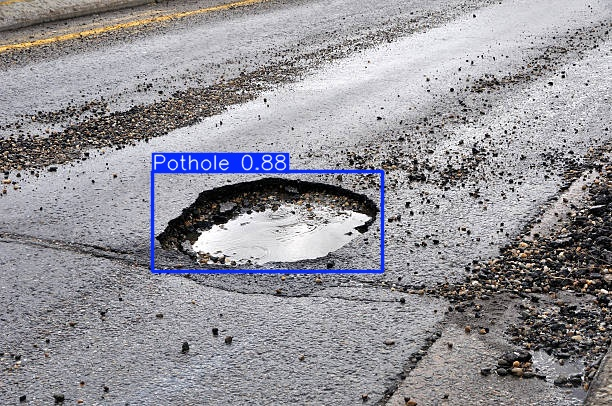

Potholes detected: 9
Displaying output for image: 2


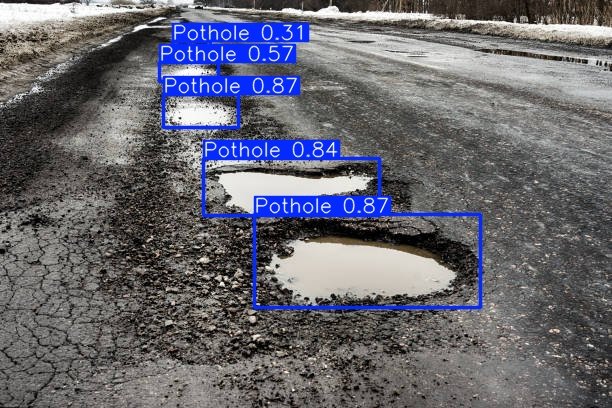

Potholes detected: 9
Displaying output for image: 3


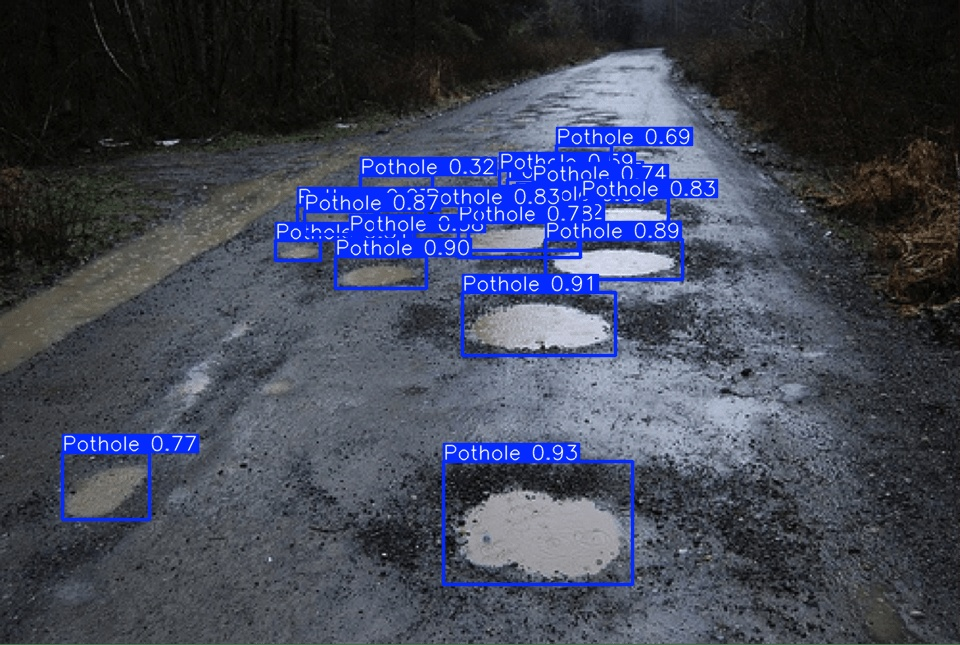

Potholes detected: 9
Displaying output for image: 4


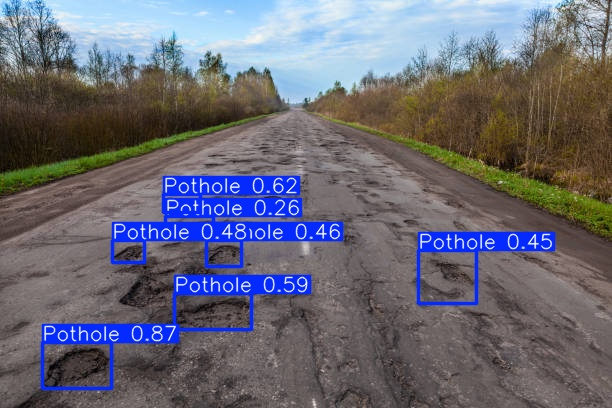

Potholes detected: 9
Displaying output for image: 5


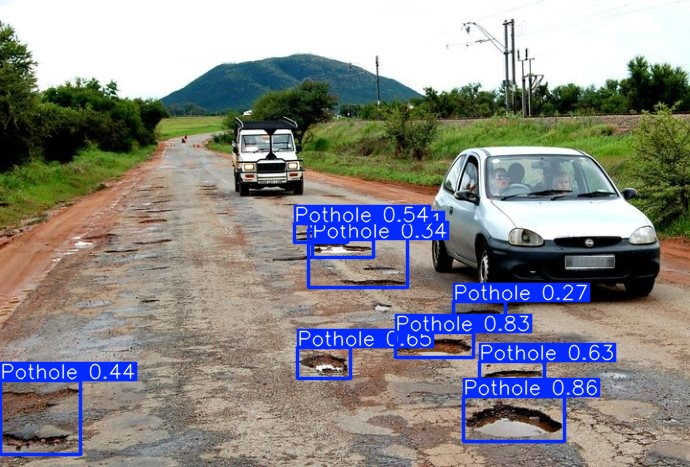

Potholes detected: 9


In [19]:
import os
from IPython.display import Image, display
pred_dir = "runs/detect/predict"
for i in range(len(os.listdir(pred_dir))):
    print("Displaying output for image:", i+1)
    output_img = os.listdir(pred_dir)[i] 
    display(Image(filename=os.path.join(pred_dir, output_img)))
    boxes = result[0].boxes
    print("Potholes detected:", len(boxes))

19 August 2025

In [20]:
import torch
print(torch.cuda.is_available())
print(torch.cuda.get_device_name(0))


True
NVIDIA GeForce RTX 3050 6GB Laptop GPU


In [2]:
from ultralytics import YOLO
# import os
# os.environ["CUDA_LAUNCH_BLOCKING"] = "1"

model = YOLO("yolo11s.pt")
model.train(data="D:\ASTC project\Pothole-2-3\data.yaml",epochs = 20 ,imgsz= 640, batch =8,workers =4 ,name = "yolos_final")


New https://pypi.org/project/ultralytics/8.3.182 available  Update with 'pip install -U ultralytics'
Ultralytics 8.3.179  Python-3.11.9 torch-2.5.1+cu121 CUDA:0 (NVIDIA GeForce RTX 3050 6GB Laptop GPU, 6144MiB)
engine\trainer: agnostic_nms=False, amp=True, augment=False, auto_augment=randaugment, batch=8, bgr=0.0, box=7.5, cache=False, cfg=None, classes=None, close_mosaic=10, cls=0.5, conf=None, copy_paste=0.0, copy_paste_mode=flip, cos_lr=False, cutmix=0.0, data=D:\ASTC project\Pothole-2-3\data.yaml, degrees=0.0, deterministic=True, device=None, dfl=1.5, dnn=False, dropout=0.0, dynamic=False, embed=None, epochs=20, erasing=0.4, exist_ok=False, fliplr=0.5, flipud=0.0, format=torchscript, fraction=1.0, freeze=None, half=False, hsv_h=0.015, hsv_s=0.7, hsv_v=0.4, imgsz=640, int8=False, iou=0.7, keras=False, kobj=1.0, line_width=None, lr0=0.01, lrf=0.01, mask_ratio=4, max_det=300, mixup=0.0, mode=train, model=yolo11s.pt, momentum=0.937, mosaic=1.0, multi_scale=False, name=yolos_final4, nbs

train: Scanning D:\ASTC project\Pothole-2-3\train\labels.cache... 1116 images, 1 backgrounds, 0 corrupt: 100%|██████████| 1116/1116 [00:00<?, ?it/s]

WARNING Box and segment counts should be equal, but got len(segments) = 7, len(boxes) = 2688. To resolve this only boxes will be used and all segments will be removed. To avoid this please supply either a detect or segment dataset, not a detect-segment mixed dataset.


val: Fast image access  (ping: 0.10.0 ms, read: 152.020.5 MB/s, size: 63.7 KB)


val: Scanning D:\ASTC project\Pothole-2-3\valid\labels.cache... 587 images, 1 backgrounds, 0 corrupt: 100%|██████████| 587/587 [00:00<?, ?it/s]


Plotting labels to runs\detect\yolos_final4\labels.jpg... 
optimizer: 'optimizer=auto' found, ignoring 'lr0=0.01' and 'momentum=0.937' and determining best 'optimizer', 'lr0' and 'momentum' automatically... 
optimizer: AdamW(lr=0.001667, momentum=0.9) with parameter groups 81 weight(decay=0.0), 88 weight(decay=0.0005), 87 bias(decay=0.0)
Image sizes 640 train, 640 val
Using 4 dataloader workers
Logging results to runs\detect\yolos_final4
Starting training for 20 epochs...

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       1/20      2.11G       2.09       3.49      2.039          9        640: 100%|██████████| 140/140 [00:29<00:00,  4.82it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 37/37 [00:06<00:00,  5.95it/s]


                   all        587       1384     0.0204      0.106    0.00909    0.00258

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       2/20      2.49G      2.206       2.82      2.126         16        640: 100%|██████████| 140/140 [00:25<00:00,  5.50it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 37/37 [00:06<00:00,  5.72it/s]


                   all        587       1384      0.191      0.113      0.079     0.0295

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       3/20      2.49G      2.215      2.768      2.125         13        640: 100%|██████████| 140/140 [00:25<00:00,  5.45it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 37/37 [00:05<00:00,  6.59it/s]


                   all        587       1384      0.134      0.165     0.0563     0.0227

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       4/20      2.49G      2.163       2.72      2.079         17        640: 100%|██████████| 140/140 [00:25<00:00,  5.46it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 37/37 [00:05<00:00,  6.63it/s]


                   all        587       1384      0.238      0.265      0.179     0.0639

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       5/20      2.49G      2.117      2.592      2.015         17        640: 100%|██████████| 140/140 [00:25<00:00,  5.44it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 37/37 [00:05<00:00,  6.65it/s]


                   all        587       1384      0.329      0.255      0.196      0.071

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       6/20      2.49G      2.082      2.501      1.994         18        640: 100%|██████████| 140/140 [00:26<00:00,  5.38it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 37/37 [00:05<00:00,  6.41it/s]


                   all        587       1384      0.379      0.233      0.223     0.0811

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       7/20      2.49G      2.027        2.4      1.942          8        640: 100%|██████████| 140/140 [00:26<00:00,  5.35it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 37/37 [00:05<00:00,  6.54it/s]

                   all        587       1384      0.551      0.224      0.254      0.101



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       8/20      2.49G      1.963      2.326      1.916         11        640: 100%|██████████| 140/140 [00:26<00:00,  5.37it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 37/37 [00:05<00:00,  6.48it/s]


                   all        587       1384      0.683      0.254      0.327       0.12

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       9/20      2.49G      1.955      2.236      1.892         12        640: 100%|██████████| 140/140 [00:26<00:00,  5.34it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 37/37 [00:05<00:00,  6.59it/s]

                   all        587       1384      0.792      0.248      0.405      0.174



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      10/20      2.49G      1.892      2.197      1.859          7        640: 100%|██████████| 140/140 [00:25<00:00,  5.41it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 37/37 [00:05<00:00,  6.69it/s]

                   all        587       1384       0.52      0.383      0.411      0.174


Closing dataloader mosaic

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      11/20      2.49G      1.907      2.206      1.903          8        640: 100%|██████████| 140/140 [00:25<00:00,  5.46it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 37/37 [00:05<00:00,  6.77it/s]

                   all        587       1384      0.428      0.405      0.376      0.157



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      12/20      2.49G      1.868       2.07      1.909          9        640: 100%|██████████| 140/140 [00:25<00:00,  5.47it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 37/37 [00:05<00:00,  6.75it/s]

                   all        587       1384      0.574      0.448       0.48      0.216



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      13/20      2.49G      1.829          2      1.867          9        640: 100%|██████████| 140/140 [00:25<00:00,  5.45it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 37/37 [00:05<00:00,  6.68it/s]

                   all        587       1384      0.549      0.438      0.453      0.197



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      14/20      2.49G      1.788      1.959      1.853         12        640: 100%|██████████| 140/140 [00:25<00:00,  5.39it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 37/37 [00:05<00:00,  6.62it/s]

                   all        587       1384      0.616      0.441      0.504       0.24



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      15/20      2.49G      1.746      1.831      1.815          4        640: 100%|██████████| 140/140 [00:25<00:00,  5.39it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 37/37 [00:05<00:00,  6.71it/s]

                   all        587       1384      0.595       0.46      0.519      0.226



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      16/20      2.49G      1.742      1.811      1.784          6        640: 100%|██████████| 140/140 [00:25<00:00,  5.40it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 37/37 [00:05<00:00,  6.73it/s]

                   all        587       1384      0.582      0.519      0.574      0.269



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      17/20      2.49G      1.678      1.697      1.748          5        640: 100%|██████████| 140/140 [00:25<00:00,  5.43it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 37/37 [00:05<00:00,  6.71it/s]

                   all        587       1384      0.608      0.506      0.559      0.281



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      18/20      2.49G       1.66      1.688       1.74          5        640: 100%|██████████| 140/140 [00:25<00:00,  5.42it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 37/37 [00:05<00:00,  6.70it/s]

                   all        587       1384      0.671      0.498      0.579      0.297



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      19/20      2.49G      1.611      1.589      1.695          5        640: 100%|██████████| 140/140 [00:25<00:00,  5.39it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 37/37 [00:05<00:00,  6.55it/s]

                   all        587       1384      0.634      0.556      0.602      0.315



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      20/20      2.49G      1.591      1.549      1.688         21        640: 100%|██████████| 140/140 [00:25<00:00,  5.39it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 37/37 [00:05<00:00,  6.48it/s]

                   all        587       1384      0.676      0.539      0.616      0.321



20 epochs completed in 0.192 hours.
Optimizer stripped from runs\detect\yolos_final4\weights\last.pt, 19.2MB
Optimizer stripped from runs\detect\yolos_final4\weights\best.pt, 19.2MB

Validating runs\detect\yolos_final4\weights\best.pt...
Ultralytics 8.3.179  Python-3.11.9 torch-2.5.1+cu121 CUDA:0 (NVIDIA GeForce RTX 3050 6GB Laptop GPU, 6144MiB)
YOLO11s summary (fused): 100 layers, 9,413,574 parameters, 0 gradients, 21.3 GFLOPs


                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 37/37 [00:05<00:00,  6.59it/s]


                   all        587       1384      0.676      0.538      0.616      0.321
               Pothole        461       1232      0.595      0.333      0.423      0.206
        Sewage-Manhole        142        152      0.756      0.743      0.809      0.436
Speed: 0.2ms preprocess, 5.8ms inference, 0.0ms loss, 1.2ms postprocess per image
Results saved to runs\detect\yolos_final4


ultralytics.utils.metrics.DetMetrics object with attributes:

ap_class_index: array([0, 1])
box: ultralytics.utils.metrics.Metric object
confusion_matrix: <ultralytics.utils.metrics.ConfusionMatrix object at 0x00000260B1C62450>
curves: ['Precision-Recall(B)', 'F1-Confidence(B)', 'Precision-Confidence(B)', 'Recall-Confidence(B)']
curves_results: [[array([          0,    0.001001,    0.002002,    0.003003,    0.004004,    0.005005,    0.006006,    0.007007,    0.008008,    0.009009,     0.01001,    0.011011,    0.012012,    0.013013,    0.014014,    0.015015,    0.016016,    0.017017,    0.018018,    0.019019,     0.02002,    0.021021,    0.022022,    0.023023,
          0.024024,    0.025025,    0.026026,    0.027027,    0.028028,    0.029029,     0.03003,    0.031031,    0.032032,    0.033033,    0.034034,    0.035035,    0.036036,    0.037037,    0.038038,    0.039039,     0.04004,    0.041041,    0.042042,    0.043043,    0.044044,    0.045045,    0.046046,    0.047047,
          0.0

In [15]:
inference_small_model = YOLO(r"D:\ASTC project\runs\detect\yolos_final4\weights\best.pt")


In [24]:
import os 
Test_data = r"D:\ASTC project\Data_to_be_predicted"
for files in os.listdir(Test_data):
    image_path = os.path.join(Test_data,files)
    result = inference_small_model.predict(image_path ,save_dir = "D:\ASTC project\small_model_1_POthole2-3",conf = 0.25 ,save=True,device= "cuda")


image 1/1 D:\ASTC project\Data_to_be_predicted\image1.jpg: 448x640 2 Potholes, 118.8ms
Speed: 4.6ms preprocess, 118.8ms inference, 4.4ms postprocess per image at shape (1, 3, 448, 640)
Results saved to runs\detect\predict2

image 1/1 D:\ASTC project\Data_to_be_predicted\image2.jpg: 448x640 5 Potholes, 118.7ms
Speed: 3.6ms preprocess, 118.7ms inference, 1.7ms postprocess per image at shape (1, 3, 448, 640)
Results saved to runs\detect\predict2

image 1/1 D:\ASTC project\Data_to_be_predicted\image3 (1).png: 448x640 17 Potholes, 14.6ms
Speed: 3.8ms preprocess, 14.6ms inference, 1.3ms postprocess per image at shape (1, 3, 448, 640)
Results saved to runs\detect\predict2

image 1/1 D:\ASTC project\Data_to_be_predicted\image4.jpg: 448x640 7 Potholes, 8.0ms
Speed: 1.0ms preprocess, 8.0ms inference, 1.3ms postprocess per image at shape (1, 3, 448, 640)
Results saved to runs\detect\predict2

image 1/1 D:\ASTC project\Data_to_be_predicted\image5.jpg: 448x640 8 Potholes, 7.8ms
Speed: 1.3ms prepro

Displaying output for image: 1


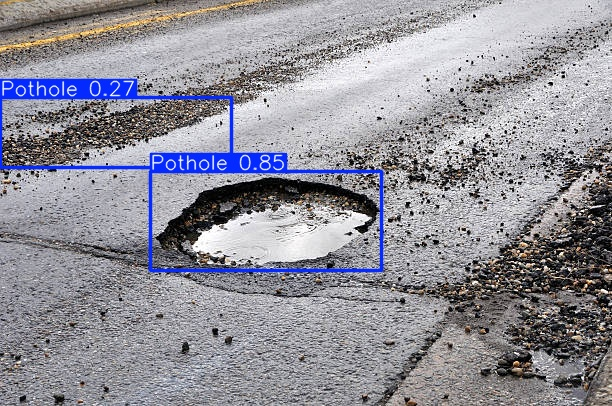

Potholes detected: 8
Displaying output for image: 2


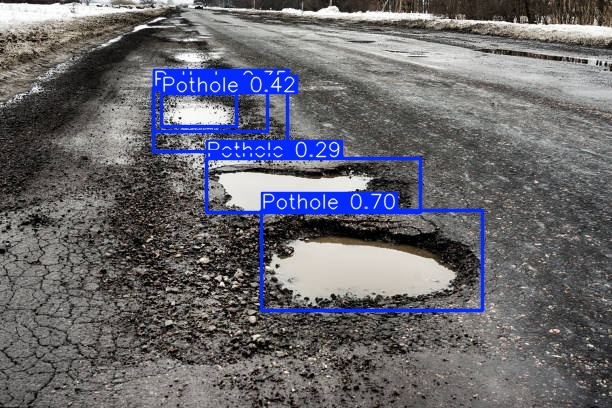

Potholes detected: 8
Displaying output for image: 3


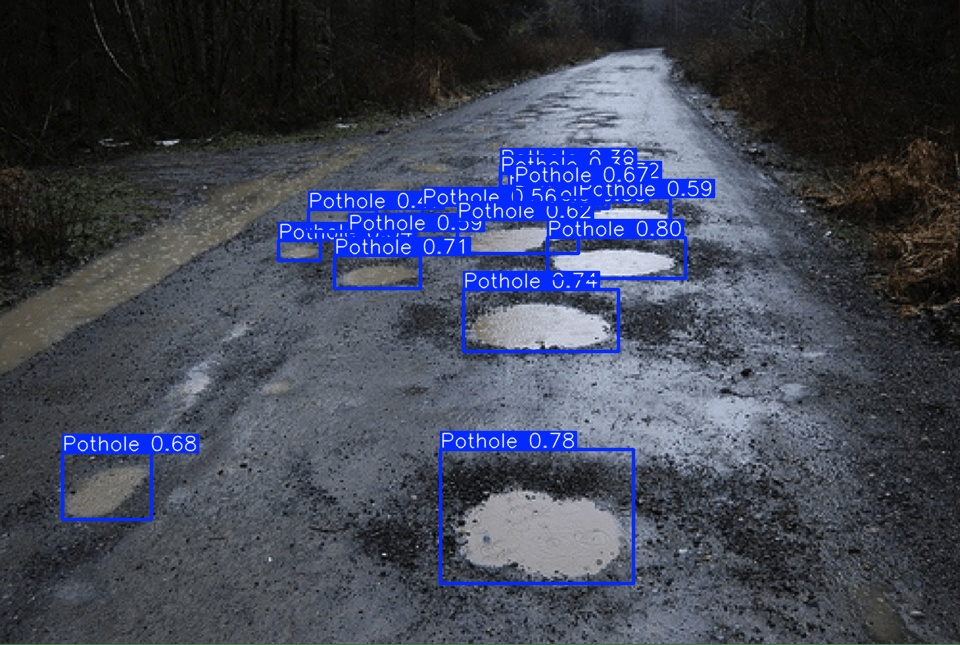

Potholes detected: 8
Displaying output for image: 4


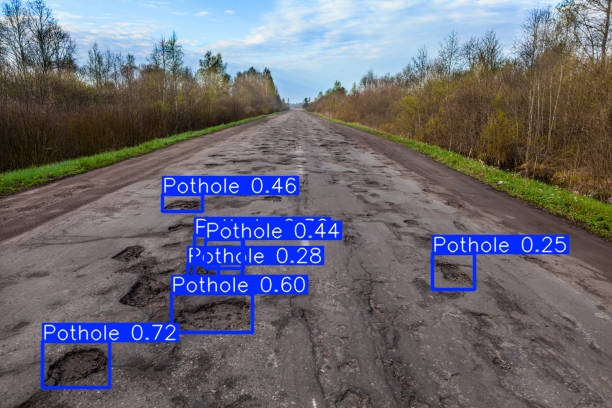

Potholes detected: 8
Displaying output for image: 5


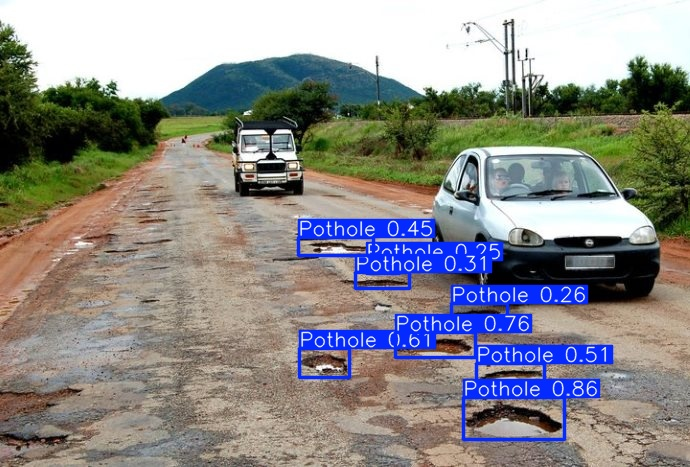

Potholes detected: 8


In [25]:
import os
from IPython.display import Image, display
pred_dir = "runs/detect/predict2"
for i in range(len(os.listdir(pred_dir))):
    print("Displaying output for image:", i+1)
    output_img = os.listdir(pred_dir)[i] 
    display(Image(filename=os.path.join(pred_dir, output_img)))
    boxes = result[0].boxes
    print("Potholes detected:", len(boxes))

In [ ]:
from ultralytics import YOLO
model = YOLO("yolo11m.pt")
model.train(data="D:\ASTC project\Pothole-2-3\data.yaml",epochs = 15,imgsz= 640, batch = 8,workers =4 ,name = "yoloM_final")


New https://pypi.org/project/ultralytics/8.3.182 available  Update with 'pip install -U ultralytics'
Ultralytics 8.3.179  Python-3.11.9 torch-2.5.1+cu121 CUDA:0 (NVIDIA GeForce RTX 3050 6GB Laptop GPU, 6144MiB)
engine\trainer: agnostic_nms=False, amp=True, augment=False, auto_augment=randaugment, batch=8, bgr=0.0, box=7.5, cache=False, cfg=None, classes=None, close_mosaic=10, cls=0.5, conf=None, copy_paste=0.0, copy_paste_mode=flip, cos_lr=False, cutmix=0.0, data=D:\ASTC project\Pothole-2-3\data.yaml, degrees=0.0, deterministic=True, device=None, dfl=1.5, dnn=False, dropout=0.0, dynamic=False, embed=None, epochs=15, erasing=0.4, exist_ok=False, fliplr=0.5, flipud=0.0, format=torchscript, fraction=1.0, freeze=None, half=False, hsv_h=0.015, hsv_s=0.7, hsv_v=0.4, imgsz=640, int8=False, iou=0.7, keras=False, kobj=1.0, line_width=None, lr0=0.01, lrf=0.01, mask_ratio=4, max_det=300, mixup=0.0, mode=train, model=yolo11m.pt, momentum=0.937, mosaic=1.0, multi_scale=False, name=yoloM_final3, nbs

train: Scanning D:\ASTC project\Pothole-2-3\train\labels.cache... 1116 images, 1 backgrounds, 0 corrupt: 100%|██████████| 1116/1116 [00:00<?, ?it/s]

WARNING Box and segment counts should be equal, but got len(segments) = 7, len(boxes) = 2688. To resolve this only boxes will be used and all segments will be removed. To avoid this please supply either a detect or segment dataset, not a detect-segment mixed dataset.


val: Fast image access  (ping: 0.10.0 ms, read: 165.216.2 MB/s, size: 63.7 KB)


val: Scanning D:\ASTC project\Pothole-2-3\valid\labels.cache... 587 images, 1 backgrounds, 0 corrupt: 100%|██████████| 587/587 [00:00<?, ?it/s]


Plotting labels to runs\detect\yoloM_final3\labels.jpg... 
optimizer: 'optimizer=auto' found, ignoring 'lr0=0.01' and 'momentum=0.937' and determining best 'optimizer', 'lr0' and 'momentum' automatically... 
optimizer: AdamW(lr=0.001667, momentum=0.9) with parameter groups 106 weight(decay=0.0), 113 weight(decay=0.0005), 112 bias(decay=0.0)
Image sizes 640 train, 640 val
Using 4 dataloader workers
Logging results to runs\detect\yoloM_final3
Starting training for 15 epochs...

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       1/15      4.22G      2.217      3.182      2.175          9        640: 100%|██████████| 140/140 [00:54<00:00,  2.57it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 37/37 [00:11<00:00,  3.13it/s]

                   all        587       1384     0.0264     0.0634    0.00722    0.00221



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       2/15      4.39G      2.415      3.143      2.312         16        640: 100%|██████████| 140/140 [00:51<00:00,  2.70it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 37/37 [00:10<00:00,  3.46it/s]

                   all        587       1384     0.0206     0.0718    0.00446    0.00132



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       3/15      4.39G      2.431      3.164      2.369         13        640: 100%|██████████| 140/140 [00:51<00:00,  2.71it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 37/37 [00:11<00:00,  3.26it/s]

                   all        587       1384     0.0771      0.133      0.017    0.00449



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       4/15      4.39G      2.324       3.07      2.247         17        640: 100%|██████████| 140/140 [00:51<00:00,  2.70it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 37/37 [00:10<00:00,  3.52it/s]

                   all        587       1384     0.0554     0.0825     0.0254     0.0073



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       5/15      4.38G       2.28      2.982      2.211         17        640: 100%|██████████| 140/140 [00:51<00:00,  2.69it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 37/37 [00:10<00:00,  3.64it/s]

                   all        587       1384      0.194      0.103     0.0864     0.0276


Closing dataloader mosaic

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       6/15      4.38G      2.269      2.953      2.301          4        640: 100%|██████████| 140/140 [00:51<00:00,  2.71it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 37/37 [00:10<00:00,  3.67it/s]

                   all        587       1384      0.309      0.181      0.127     0.0433



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       7/15      4.39G      2.231      2.836      2.238          7        640: 100%|██████████| 140/140 [00:51<00:00,  2.71it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 37/37 [00:10<00:00,  3.68it/s]

                   all        587       1384       0.21      0.201       0.13     0.0511



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       8/15      4.39G      2.161      2.685      2.217          7        640: 100%|██████████| 140/140 [00:51<00:00,  2.72it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 37/37 [00:10<00:00,  3.64it/s]

                   all        587       1384       0.23      0.286      0.199     0.0777



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       9/15      4.39G      2.072      2.543       2.13          4        640: 100%|██████████| 140/140 [00:51<00:00,  2.72it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 37/37 [00:10<00:00,  3.66it/s]

                   all        587       1384      0.297      0.251      0.227     0.0904



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      10/15      4.39G      2.045       2.46      2.108          7        640: 100%|██████████| 140/140 [00:51<00:00,  2.71it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 37/37 [00:10<00:00,  3.70it/s]

                   all        587       1384      0.355      0.325      0.277      0.117



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      11/15      4.39G      2.021      2.371      2.048          9        640: 100%|██████████| 140/140 [00:51<00:00,  2.72it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 37/37 [00:09<00:00,  3.72it/s]

                   all        587       1384      0.359      0.275       0.29      0.125



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      12/15      4.39G       1.96      2.287      2.007          9        640: 100%|██████████| 140/140 [00:51<00:00,  2.71it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 37/37 [00:10<00:00,  3.70it/s]

                   all        587       1384       0.29      0.373      0.277      0.117



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      13/15      4.39G      1.925       2.22      2.002          9        640: 100%|██████████| 140/140 [00:51<00:00,  2.72it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 37/37 [00:09<00:00,  3.70it/s]

                   all        587       1384      0.327      0.406        0.3      0.139



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      14/15      4.39G      1.861      2.132       1.94         12        640: 100%|██████████| 140/140 [00:52<00:00,  2.66it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 37/37 [00:12<00:00,  2.96it/s]

                   all        587       1384      0.317      0.397      0.334      0.158



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      15/15      4.39G      1.851      2.061      1.931          4        640: 100%|██████████| 140/140 [00:52<00:00,  2.68it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 37/37 [00:10<00:00,  3.68it/s]

                   all        587       1384      0.357      0.463      0.372       0.18



15 epochs completed in 0.278 hours.
Optimizer stripped from runs\detect\yoloM_final3\weights\last.pt, 40.5MB
Optimizer stripped from runs\detect\yoloM_final3\weights\best.pt, 40.5MB

Validating runs\detect\yoloM_final3\weights\best.pt...
Ultralytics 8.3.179  Python-3.11.9 torch-2.5.1+cu121 CUDA:0 (NVIDIA GeForce RTX 3050 6GB Laptop GPU, 6144MiB)
YOLO11m summary (fused): 125 layers, 20,031,574 parameters, 0 gradients, 67.7 GFLOPs


                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 37/37 [00:10<00:00,  3.42it/s]


                   all        587       1384      0.354      0.464      0.371       0.18
               Pothole        461       1232      0.377      0.282      0.284       0.13
        Sewage-Manhole        142        152       0.33      0.645      0.459      0.229
Speed: 0.3ms preprocess, 12.9ms inference, 0.0ms loss, 1.4ms postprocess per image
Results saved to runs\detect\yoloM_final3


ultralytics.utils.metrics.DetMetrics object with attributes:

ap_class_index: array([0, 1])
box: ultralytics.utils.metrics.Metric object
confusion_matrix: <ultralytics.utils.metrics.ConfusionMatrix object at 0x0000021CD6FE8610>
curves: ['Precision-Recall(B)', 'F1-Confidence(B)', 'Precision-Confidence(B)', 'Recall-Confidence(B)']
curves_results: [[array([          0,    0.001001,    0.002002,    0.003003,    0.004004,    0.005005,    0.006006,    0.007007,    0.008008,    0.009009,     0.01001,    0.011011,    0.012012,    0.013013,    0.014014,    0.015015,    0.016016,    0.017017,    0.018018,    0.019019,     0.02002,    0.021021,    0.022022,    0.023023,
          0.024024,    0.025025,    0.026026,    0.027027,    0.028028,    0.029029,     0.03003,    0.031031,    0.032032,    0.033033,    0.034034,    0.035035,    0.036036,    0.037037,    0.038038,    0.039039,     0.04004,    0.041041,    0.042042,    0.043043,    0.044044,    0.045045,    0.046046,    0.047047,
          0.0

In [1]:
from ultralytics import YOLO
inference_medium_model = YOLO(r"D:\ASTC project\runs\detect\yoloM_final3\weights\best.pt")

In [35]:
import os 
Test_data = r"D:\ASTC project\Data_to_be_predicted"
for files in os.listdir(Test_data):
    image_path = os.path.join(Test_data,files)
    result = inference_medium_model.predict(image_path ,save_dir = "D:\ASTC project\nano_model_1_POthole2-3",conf = 0.25 ,save=True,device= "cuda")


image 1/1 D:\ASTC project\Data_to_be_predicted\image1.jpg: 448x640 1 Pothole, 227.0ms
Speed: 4.3ms preprocess, 227.0ms inference, 1.5ms postprocess per image at shape (1, 3, 448, 640)
Results saved to runs\detect\predict3

image 1/1 D:\ASTC project\Data_to_be_predicted\image2.jpg: 448x640 3 Potholes, 17.0ms
Speed: 1.0ms preprocess, 17.0ms inference, 1.3ms postprocess per image at shape (1, 3, 448, 640)
Results saved to runs\detect\predict3

image 1/1 D:\ASTC project\Data_to_be_predicted\image3 (1).png: 448x640 14 Potholes, 17.4ms
Speed: 1.2ms preprocess, 17.4ms inference, 1.4ms postprocess per image at shape (1, 3, 448, 640)
Results saved to runs\detect\predict3

image 1/1 D:\ASTC project\Data_to_be_predicted\image4.jpg: 448x640 1 Pothole, 17.0ms
Speed: 1.2ms preprocess, 17.0ms inference, 1.5ms postprocess per image at shape (1, 3, 448, 640)
Results saved to runs\detect\predict3

image 1/1 D:\ASTC project\Data_to_be_predicted\image5.jpg: 448x640 5 Potholes, 17.4ms
Speed: 1.5ms preproc

Displaying output for image: 1


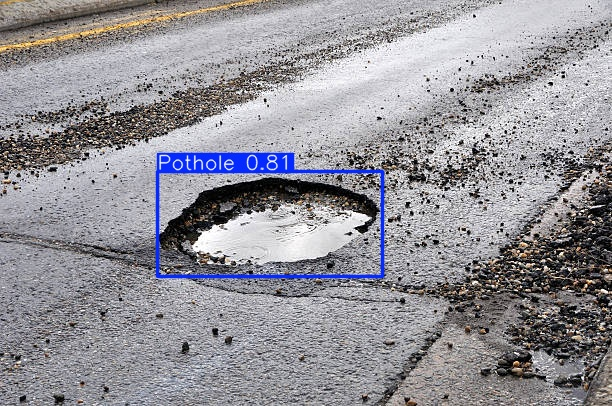

Potholes detected: 5
Displaying output for image: 2


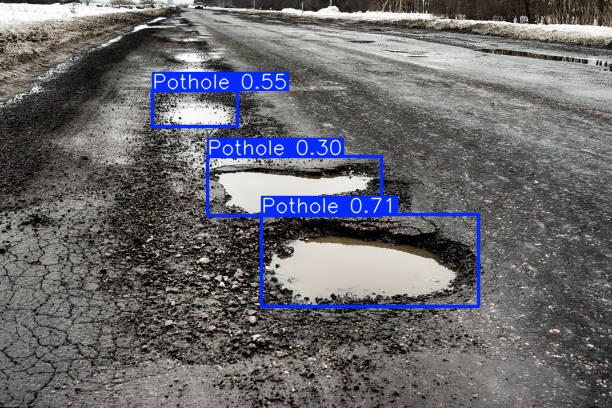

Potholes detected: 5
Displaying output for image: 3


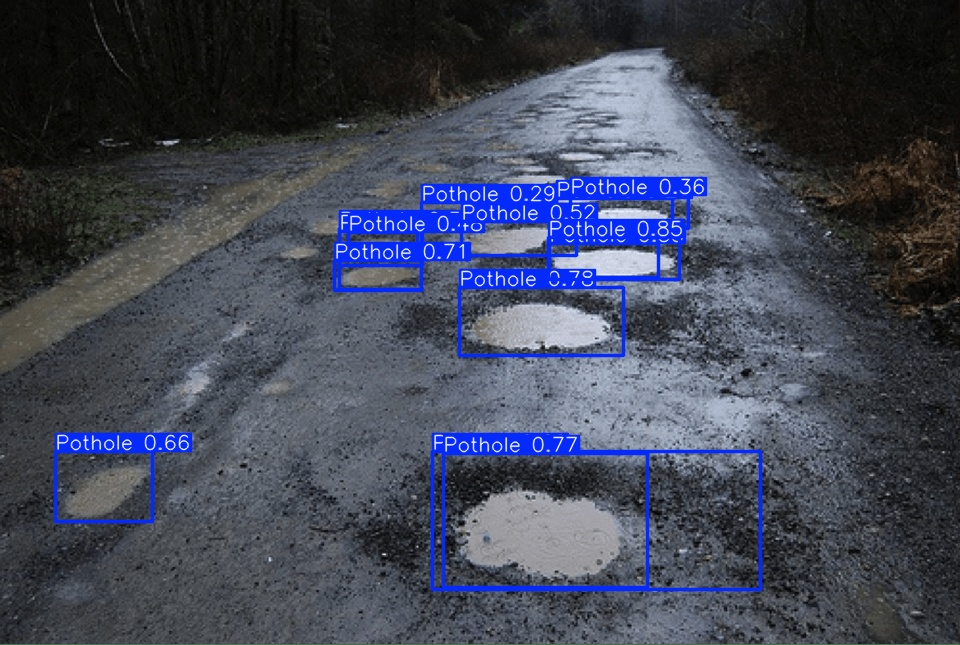

Potholes detected: 5
Displaying output for image: 4


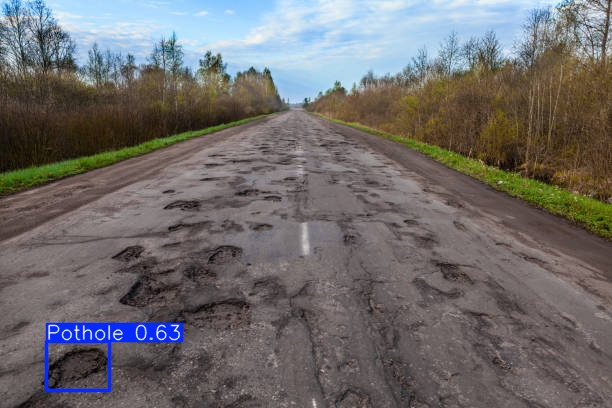

Potholes detected: 5
Displaying output for image: 5


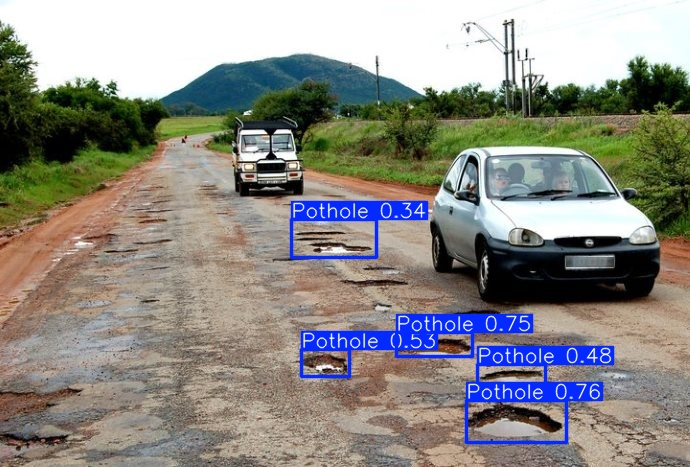

Potholes detected: 5


In [36]:
import os
from IPython.display import Image, display
pred_dir = "runs/detect/predict3"
for i in range(len(os.listdir(pred_dir))):
    print("Displaying output for image:", i+1)
    output_img = os.listdir(pred_dir)[i] 
    display(Image(filename=os.path.join(pred_dir, output_img)))
    boxes = result[0].boxes
    print("Potholes detected:", len(boxes))

In [6]:
import torch, gc

gc.collect()
torch.cuda.empty_cache()


In [2]:
# Training on dataset New pothole detection-2 
from ultralytics import YOLO
model = YOLO("yolo11n.pt")
model.train(data = r"D:\ASTC project\New-pothole-detection-2\data.yaml" ,epochs =40 , verbose = False ,imgsz = 640 , batch = 16 ,name = "New_yolon_1",workers=4)


New https://pypi.org/project/ultralytics/8.3.182 available  Update with 'pip install -U ultralytics'
Ultralytics 8.3.179  Python-3.11.9 torch-2.5.1+cu121 CUDA:0 (NVIDIA GeForce RTX 3050 6GB Laptop GPU, 6144MiB)
engine\trainer: agnostic_nms=False, amp=True, augment=False, auto_augment=randaugment, batch=16, bgr=0.0, box=7.5, cache=False, cfg=None, classes=None, close_mosaic=10, cls=0.5, conf=None, copy_paste=0.0, copy_paste_mode=flip, cos_lr=False, cutmix=0.0, data=D:\ASTC project\New-pothole-detection-2\data.yaml, degrees=0.0, deterministic=True, device=None, dfl=1.5, dnn=False, dropout=0.0, dynamic=False, embed=None, epochs=40, erasing=0.4, exist_ok=False, fliplr=0.5, flipud=0.0, format=torchscript, fraction=1.0, freeze=None, half=False, hsv_h=0.015, hsv_s=0.7, hsv_v=0.4, imgsz=640, int8=False, iou=0.7, keras=False, kobj=1.0, line_width=None, lr0=0.01, lrf=0.01, mask_ratio=4, max_det=300, mixup=0.0, mode=train, model=yolo11n.pt, momentum=0.937, mosaic=1.0, multi_scale=False, name=New_

train: Scanning D:\ASTC project\New-pothole-detection-2\train\labels... 6091 images, 4 backgrounds, 0 corrupt: 100%|██████████| 6091/6091 [00:02<00:00, 2475.44it/s]


train: New cache created: D:\ASTC project\New-pothole-detection-2\train\labels.cache
WARNING Box and segment counts should be equal, but got len(segments) = 2171, len(boxes) = 15830. To resolve this only boxes will be used and all segments will be removed. To avoid this please supply either a detect or segment dataset, not a detect-segment mixed dataset.
val: Fast image access  (ping: 0.40.2 ms, read: 141.641.4 MB/s, size: 56.4 KB)


val: Scanning D:\ASTC project\New-pothole-detection-2\valid\labels... 2094 images, 0 backgrounds, 0 corrupt: 100%|██████████| 2094/2094 [00:01<00:00, 1684.23it/s]


val: New cache created: D:\ASTC project\New-pothole-detection-2\valid\labels.cache
Plotting labels to runs\detect\New_yolon_1\labels.jpg... 
optimizer: 'optimizer=auto' found, ignoring 'lr0=0.01' and 'momentum=0.937' and determining best 'optimizer', 'lr0' and 'momentum' automatically... 
optimizer: AdamW(lr=0.002, momentum=0.9) with parameter groups 81 weight(decay=0.0), 88 weight(decay=0.0005), 87 bias(decay=0.0)
Image sizes 640 train, 640 val
Using 4 dataloader workers
Logging results to runs\detect\New_yolon_1
Starting training for 40 epochs...

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       1/40      2.33G      1.792      2.325      1.655         33        640: 100%|██████████| 381/381 [01:27<00:00,  4.36it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 66/66 [00:16<00:00,  3.92it/s]


                   all       2094       5214      0.508      0.402      0.401      0.173

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       2/40      2.68G      1.855      1.962      1.712         37        640: 100%|██████████| 381/381 [01:23<00:00,  4.56it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 66/66 [00:15<00:00,  4.33it/s]


                   all       2094       5214      0.483        0.4      0.392      0.161

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       3/40      2.68G      1.841      1.879      1.717         33        640: 100%|██████████| 381/381 [01:17<00:00,  4.91it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 66/66 [00:13<00:00,  4.73it/s]


                   all       2094       5214       0.51      0.393        0.4      0.179

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       4/40      2.68G      1.818      1.826      1.695         48        640: 100%|██████████| 381/381 [01:17<00:00,  4.94it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 66/66 [00:13<00:00,  4.86it/s]


                   all       2094       5214      0.553      0.414      0.434      0.196

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       5/40      2.68G      1.781      1.763      1.672         23        640: 100%|██████████| 381/381 [01:17<00:00,  4.91it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 66/66 [00:14<00:00,  4.62it/s]


                   all       2094       5214      0.597      0.479      0.514      0.239

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       6/40      2.68G      1.746      1.684      1.639         47        640: 100%|██████████| 381/381 [01:18<00:00,  4.88it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 66/66 [00:14<00:00,  4.55it/s]


                   all       2094       5214      0.551      0.452      0.447      0.202

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       7/40      2.68G      1.727       1.66      1.631         31        640: 100%|██████████| 381/381 [01:26<00:00,  4.39it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 66/66 [00:15<00:00,  4.19it/s]


                   all       2094       5214      0.597      0.476       0.51      0.244

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       8/40      2.68G       1.71       1.63      1.624         64        640: 100%|██████████| 381/381 [01:20<00:00,  4.72it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 66/66 [00:16<00:00,  4.11it/s]


                   all       2094       5214      0.653      0.522      0.577      0.281

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       9/40      2.68G       1.68      1.579      1.592         36        640: 100%|██████████| 381/381 [01:18<00:00,  4.85it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 66/66 [00:14<00:00,  4.40it/s]


                   all       2094       5214      0.643      0.518      0.567      0.272

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      10/40      2.68G      1.676      1.568      1.588         39        640: 100%|██████████| 381/381 [01:18<00:00,  4.83it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 66/66 [00:15<00:00,  4.37it/s]


                   all       2094       5214      0.634      0.521      0.567      0.279

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      11/40      2.68G      1.638      1.544      1.568         29        640: 100%|██████████| 381/381 [01:18<00:00,  4.87it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 66/66 [00:15<00:00,  4.28it/s]


                   all       2094       5214      0.667      0.524      0.582      0.286

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      12/40      2.68G      1.637      1.526      1.569         24        640: 100%|██████████| 381/381 [02:02<00:00,  3.11it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 66/66 [01:36<00:00,  1.46s/it]


                   all       2094       5214      0.676      0.541        0.6      0.303

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      13/40      2.68G      1.634      1.513      1.571         36        640: 100%|██████████| 381/381 [05:08<00:00,  1.23it/s]  
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 66/66 [00:12<00:00,  5.13it/s]


                   all       2094       5214      0.672      0.544      0.601      0.307

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      14/40      2.68G      1.616       1.47      1.549         60        640: 100%|██████████| 381/381 [01:14<00:00,  5.13it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 66/66 [00:13<00:00,  4.88it/s]


                   all       2094       5214      0.699      0.542      0.618      0.317

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      15/40      2.68G      1.594      1.436      1.535         42        640: 100%|██████████| 381/381 [01:15<00:00,  5.08it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 66/66 [00:13<00:00,  4.90it/s]


                   all       2094       5214      0.688      0.575      0.635       0.33

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      16/40      2.68G      1.584      1.428      1.523         45        640: 100%|██████████| 381/381 [01:14<00:00,  5.09it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 66/66 [00:13<00:00,  5.03it/s]


                   all       2094       5214      0.687      0.607      0.658      0.334

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      17/40      2.68G      1.581      1.414      1.518         44        640: 100%|██████████| 381/381 [01:15<00:00,  5.05it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 66/66 [00:13<00:00,  4.76it/s]


                   all       2094       5214      0.693      0.597      0.653      0.345

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      18/40      2.68G      1.575      1.392      1.516         40        640: 100%|██████████| 381/381 [01:15<00:00,  5.05it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 66/66 [00:13<00:00,  4.89it/s]


                   all       2094       5214      0.717      0.573      0.641      0.335

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      19/40      2.68G      1.566      1.388      1.502         49        640: 100%|██████████| 381/381 [01:15<00:00,  5.04it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 66/66 [00:13<00:00,  4.87it/s]


                   all       2094       5214      0.694      0.593      0.658      0.345

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      20/40      2.68G      1.558      1.384      1.512         52        640: 100%|██████████| 381/381 [01:16<00:00,  5.01it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 66/66 [00:13<00:00,  4.88it/s]


                   all       2094       5214      0.724      0.607      0.675      0.356

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      21/40      2.68G      1.544      1.356      1.494         56        640: 100%|██████████| 381/381 [01:16<00:00,  4.99it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 66/66 [00:13<00:00,  4.85it/s]


                   all       2094       5214      0.726      0.596       0.67      0.352

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      22/40      2.68G      1.542      1.351      1.492         39        640: 100%|██████████| 381/381 [01:15<00:00,  5.03it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 66/66 [00:13<00:00,  4.86it/s]


                   all       2094       5214      0.718      0.603      0.676      0.366

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      23/40      2.68G      1.521      1.327      1.473         43        640: 100%|██████████| 381/381 [01:16<00:00,  5.00it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 66/66 [00:13<00:00,  4.88it/s]


                   all       2094       5214      0.712       0.62      0.686      0.369

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      24/40      2.68G      1.517      1.317      1.474         45        640: 100%|██████████| 381/381 [01:18<00:00,  4.88it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 66/66 [00:15<00:00,  4.27it/s]


                   all       2094       5214      0.732      0.611      0.688      0.369

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      25/40      2.68G      1.502      1.288      1.464         32        640: 100%|██████████| 381/381 [01:21<00:00,  4.67it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 66/66 [00:15<00:00,  4.21it/s]


                   all       2094       5214      0.713      0.628       0.69      0.374

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      26/40      2.68G      1.514       1.31      1.477         39        640: 100%|██████████| 381/381 [01:20<00:00,  4.76it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 66/66 [00:14<00:00,  4.41it/s]


                   all       2094       5214      0.724      0.623      0.698      0.379

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      27/40      2.68G      1.494      1.264      1.455         39        640: 100%|██████████| 381/381 [01:19<00:00,  4.76it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 66/66 [00:15<00:00,  4.21it/s]


                   all       2094       5214      0.736      0.641      0.708      0.383

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      28/40      2.68G      1.485      1.254      1.449         46        640: 100%|██████████| 381/381 [01:20<00:00,  4.75it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 66/66 [00:15<00:00,  4.30it/s]


                   all       2094       5214      0.742      0.635      0.711      0.387

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      29/40      2.68G      1.467      1.245       1.44         74        640: 100%|██████████| 381/381 [01:18<00:00,  4.88it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 66/66 [00:14<00:00,  4.45it/s]


                   all       2094       5214      0.743      0.636      0.714      0.393

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      30/40      2.68G      1.459      1.241      1.437         23        640: 100%|██████████| 381/381 [01:20<00:00,  4.75it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 66/66 [00:15<00:00,  4.17it/s]


                   all       2094       5214      0.739      0.659      0.722      0.396
Closing dataloader mosaic

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      31/40      2.68G      1.459      1.144      1.449         23        640: 100%|██████████| 381/381 [01:20<00:00,  4.76it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 66/66 [00:15<00:00,  4.34it/s]


                   all       2094       5214      0.742      0.643      0.714      0.393

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      32/40      2.68G      1.441      1.113      1.442         30        640: 100%|██████████| 381/381 [01:19<00:00,  4.81it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 66/66 [00:15<00:00,  4.24it/s]


                   all       2094       5214      0.762      0.665      0.735       0.41

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      33/40      2.68G      1.433       1.09       1.43         33        640: 100%|██████████| 381/381 [01:17<00:00,  4.91it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 66/66 [00:13<00:00,  4.77it/s]


                   all       2094       5214      0.757      0.681       0.74      0.414

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      34/40      2.68G      1.404      1.066       1.41         15        640: 100%|██████████| 381/381 [01:16<00:00,  4.96it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 66/66 [00:16<00:00,  3.93it/s]


                   all       2094       5214      0.777       0.66      0.744       0.42

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      35/40      2.68G      1.387      1.057        1.4         37        640: 100%|██████████| 381/381 [01:15<00:00,  5.06it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 66/66 [00:13<00:00,  4.97it/s]


                   all       2094       5214       0.77      0.683      0.754      0.427

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      36/40      2.68G      1.386      1.035      1.399         33        640: 100%|██████████| 381/381 [01:15<00:00,  5.08it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 66/66 [00:13<00:00,  5.01it/s]


                   all       2094       5214      0.768      0.681      0.753      0.429

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      37/40      2.68G      1.374      1.033      1.393         23        640: 100%|██████████| 381/381 [10:20<00:00,  1.63s/it] 
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 66/66 [00:13<00:00,  4.89it/s]


                   all       2094       5214      0.778      0.681      0.757      0.432

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      38/40      2.68G      1.362      1.011      1.378         26        640: 100%|██████████| 381/381 [01:12<00:00,  5.23it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 66/66 [00:12<00:00,  5.22it/s]


                   all       2094       5214       0.78      0.687      0.764      0.442

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      39/40      2.68G      1.352     0.9972      1.378         28        640: 100%|██████████| 381/381 [01:49<00:00,  3.49it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 66/66 [00:13<00:00,  4.97it/s]


                   all       2094       5214      0.776      0.693      0.765      0.444

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      40/40      2.68G      1.346      0.982      1.372         22        640: 100%|██████████| 381/381 [01:14<00:00,  5.14it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 66/66 [00:13<00:00,  4.99it/s]

                   all       2094       5214      0.777      0.694      0.769      0.447



40 epochs completed in 1.306 hours.
Optimizer stripped from runs\detect\New_yolon_1\weights\last.pt, 5.5MB
Optimizer stripped from runs\detect\New_yolon_1\weights\best.pt, 5.5MB

Validating runs\detect\New_yolon_1\weights\best.pt...
Ultralytics 8.3.179  Python-3.11.9 torch-2.5.1+cu121 CUDA:0 (NVIDIA GeForce RTX 3050 6GB Laptop GPU, 6144MiB)
YOLO11n summary (fused): 100 layers, 2,582,347 parameters, 0 gradients, 6.3 GFLOPs


                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 66/66 [00:13<00:00,  4.79it/s]


                   all       2094       5214      0.775      0.696      0.769      0.447
Speed: 0.2ms preprocess, 2.8ms inference, 0.0ms loss, 1.1ms postprocess per image
Results saved to runs\detect\New_yolon_1


ultralytics.utils.metrics.DetMetrics object with attributes:

ap_class_index: array([0])
box: ultralytics.utils.metrics.Metric object
confusion_matrix: <ultralytics.utils.metrics.ConfusionMatrix object at 0x000001CC68A775D0>
curves: ['Precision-Recall(B)', 'F1-Confidence(B)', 'Precision-Confidence(B)', 'Recall-Confidence(B)']
curves_results: [[array([0.        , 0.001001  , 0.002002  , 0.003003  , 0.004004  ,
       0.00500501, 0.00600601, 0.00700701, 0.00800801, 0.00900901,
       0.01001001, 0.01101101, 0.01201201, 0.01301301, 0.01401401,
       0.01501502, 0.01601602, 0.01701702, 0.01801802, 0.01901902,
       0.02002002, 0.02102102, 0.02202202, 0.02302302, 0.02402402,
       0.02502503, 0.02602603, 0.02702703, 0.02802803, 0.02902903,
       0.03003003, 0.03103103, 0.03203203, 0.03303303, 0.03403403,
       0.03503504, 0.03603604, 0.03703704, 0.03803804, 0.03903904,
       0.04004004, 0.04104104, 0.04204204, 0.04304304, 0.04404404,
       0.04504505, 0.04604605, 0.04704705, 0.048048

In [52]:
inference_NEW_nano_model = YOLO(r"D:\ASTC project\runs\detect\New_yolon_1\weights\best.pt")

In [53]:
import os 
Test_data = r"D:\ASTC project\Data_to_be_predicted"
for files in os.listdir(Test_data):
    image_path = os.path.join(Test_data,files)
    result = inference_NEW_nano_model.predict(image_path ,save_dir = "D:\ASTC project\small_model_1_POthole2-3",conf = 0.30 ,save=True,device= "cuda")


image 1/1 D:\ASTC project\Data_to_be_predicted\image1.jpg: 448x640 1 Pothole, 48.1ms
Speed: 3.4ms preprocess, 48.1ms inference, 1.4ms postprocess per image at shape (1, 3, 448, 640)
Results saved to runs\detect\predict4

image 1/1 D:\ASTC project\Data_to_be_predicted\image2.jpg: 448x640 4 Potholes, 26.5ms
Speed: 3.7ms preprocess, 26.5ms inference, 1.3ms postprocess per image at shape (1, 3, 448, 640)
Results saved to runs\detect\predict4

image 1/1 D:\ASTC project\Data_to_be_predicted\image3 (1).png: 448x640 15 Potholes, 6.0ms
Speed: 1.2ms preprocess, 6.0ms inference, 1.1ms postprocess per image at shape (1, 3, 448, 640)
Results saved to runs\detect\predict4

image 1/1 D:\ASTC project\Data_to_be_predicted\image4.jpg: 448x640 10 Potholes, 7.3ms
Speed: 1.2ms preprocess, 7.3ms inference, 1.1ms postprocess per image at shape (1, 3, 448, 640)
Results saved to runs\detect\predict4

image 1/1 D:\ASTC project\Data_to_be_predicted\image5.jpg: 448x640 7 Potholes, 7.7ms
Speed: 1.0ms preprocess, 

Displaying output for image: 1


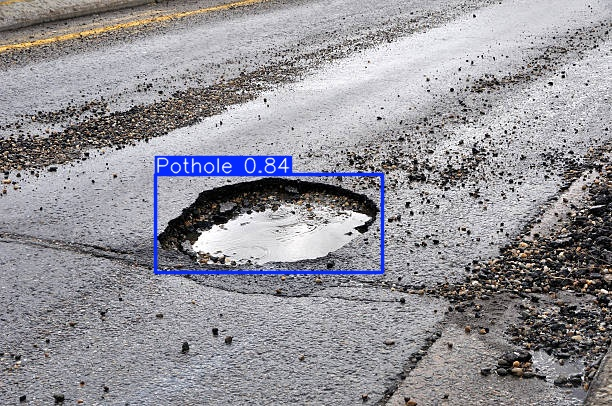

Potholes detected: 7
Displaying output for image: 2


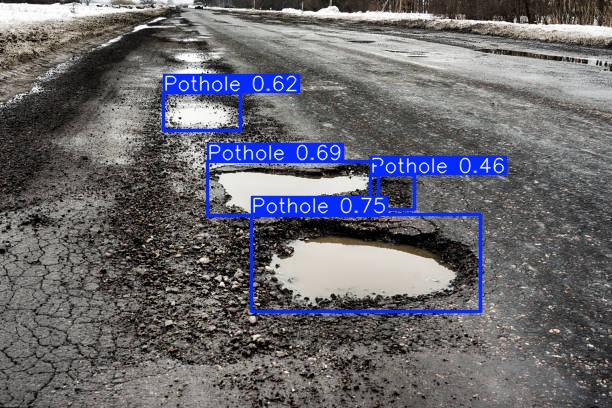

Potholes detected: 7
Displaying output for image: 3


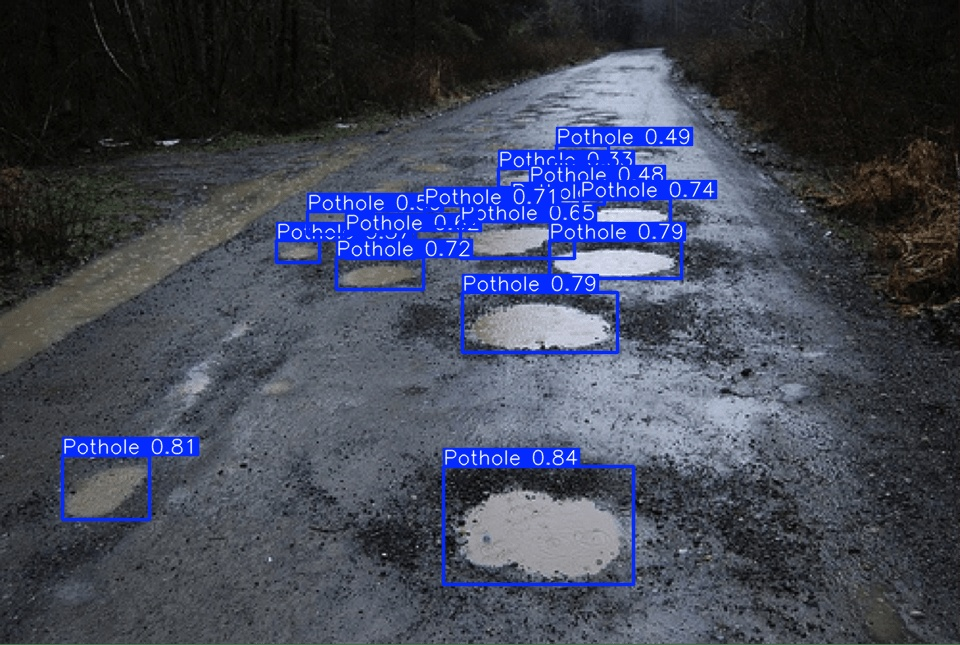

Potholes detected: 7
Displaying output for image: 4


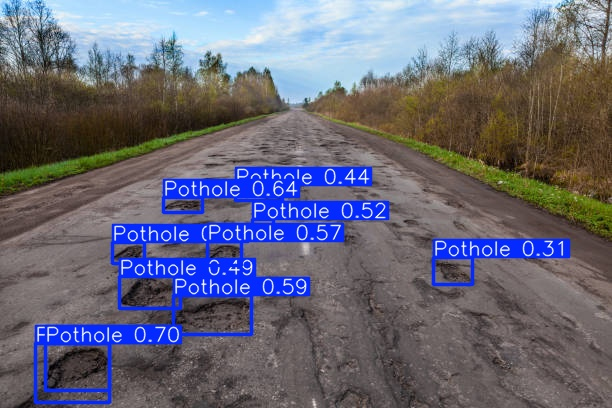

Potholes detected: 7
Displaying output for image: 5


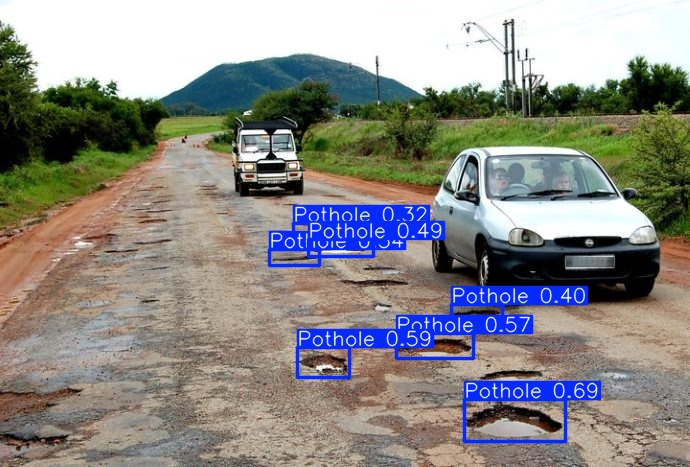

Potholes detected: 7


In [54]:
import os 
from IPython.display import Image, display
pred_dir = "runs/detect/predict4"
for i in range(len(os.listdir(pred_dir))):
    print("Displaying output for image:", i+1)
    output_img = os.listdir(pred_dir)[i] 
    display(Image(filename=os.path.join(pred_dir, output_img)))
    boxes = result[0].boxes
    print("Potholes detected:", len(boxes))

In [3]:
# Training on dataset New pothole detection-2 
from ultralytics import YOLO
model = YOLO("yolo11s.pt")
model.train(data = r"D:\ASTC project\New-pothole-detection-2\data.yaml" ,epochs =30 , verbose = False ,imgsz = 640 , batch = 16 ,name = "New_yolos_1",workers=4)


New https://pypi.org/project/ultralytics/8.3.182 available  Update with 'pip install -U ultralytics'
Ultralytics 8.3.179  Python-3.11.9 torch-2.5.1+cu121 CUDA:0 (NVIDIA GeForce RTX 3050 6GB Laptop GPU, 6144MiB)
engine\trainer: agnostic_nms=False, amp=True, augment=False, auto_augment=randaugment, batch=16, bgr=0.0, box=7.5, cache=False, cfg=None, classes=None, close_mosaic=10, cls=0.5, conf=None, copy_paste=0.0, copy_paste_mode=flip, cos_lr=False, cutmix=0.0, data=D:\ASTC project\New-pothole-detection-2\data.yaml, degrees=0.0, deterministic=True, device=None, dfl=1.5, dnn=False, dropout=0.0, dynamic=False, embed=None, epochs=30, erasing=0.4, exist_ok=False, fliplr=0.5, flipud=0.0, format=torchscript, fraction=1.0, freeze=None, half=False, hsv_h=0.015, hsv_s=0.7, hsv_v=0.4, imgsz=640, int8=False, iou=0.7, keras=False, kobj=1.0, line_width=None, lr0=0.01, lrf=0.01, mask_ratio=4, max_det=300, mixup=0.0, mode=train, model=yolo11s.pt, momentum=0.937, mosaic=1.0, multi_scale=False, name=New_

train: Scanning D:\ASTC project\New-pothole-detection-2\train\labels.cache... 6091 images, 4 backgrounds, 0 corrupt: 100%|██████████| 6091/6091 [00:00<?, ?it/s]

WARNING Box and segment counts should be equal, but got len(segments) = 2171, len(boxes) = 15830. To resolve this only boxes will be used and all segments will be removed. To avoid this please supply either a detect or segment dataset, not a detect-segment mixed dataset.


val: Fast image access  (ping: 0.00.0 ms, read: 1038.6264.8 MB/s, size: 56.4 KB)


val: Scanning D:\ASTC project\New-pothole-detection-2\valid\labels.cache... 2094 images, 0 backgrounds, 0 corrupt: 100%|██████████| 2094/2094 [00:00<?, ?it/s]


Plotting labels to runs\detect\New_yolos_1\labels.jpg... 
optimizer: 'optimizer=auto' found, ignoring 'lr0=0.01' and 'momentum=0.937' and determining best 'optimizer', 'lr0' and 'momentum' automatically... 
optimizer: AdamW(lr=0.002, momentum=0.9) with parameter groups 81 weight(decay=0.0), 88 weight(decay=0.0005), 87 bias(decay=0.0)
Image sizes 640 train, 640 val
Using 4 dataloader workers
Logging results to runs\detect\New_yolos_1
Starting training for 30 epochs...

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       1/30      4.01G       1.86      2.406      1.769         33        640: 100%|██████████| 381/381 [02:15<00:00,  2.82it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 66/66 [00:20<00:00,  3.21it/s]


                   all       2094       5214      0.276      0.248      0.172     0.0701

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       2/30      4.02G      1.909      2.003      1.809         37        640: 100%|██████████| 381/381 [02:08<00:00,  2.96it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 66/66 [00:18<00:00,  3.53it/s]


                   all       2094       5214      0.384      0.389      0.341      0.143

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       3/30      4.04G       1.87      1.925      1.772         33        640: 100%|██████████| 381/381 [06:40<00:00,  1.05s/it]  
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 66/66 [00:18<00:00,  3.48it/s]


                   all       2094       5214      0.515       0.39      0.397      0.162

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       4/30      4.04G      1.826      1.854      1.731         48        640: 100%|██████████| 381/381 [06:43<00:00,  1.06s/it]  
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 66/66 [00:18<00:00,  3.54it/s]


                   all       2094       5214      0.526      0.352       0.38      0.172

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       5/30         4G      1.781      1.797      1.705         23        640: 100%|██████████| 381/381 [03:05<00:00,  2.05it/s]  
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 66/66 [00:19<00:00,  3.43it/s]


                   all       2094       5214      0.543      0.413      0.434      0.197

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       6/30      4.04G      1.751      1.708      1.667         47        640: 100%|██████████| 381/381 [21:41<00:00,  3.42s/it]    
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 66/66 [00:19<00:00,  3.39it/s]


                   all       2094       5214       0.61      0.439      0.476      0.208

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       7/30      4.03G      1.725      1.661      1.648         31        640: 100%|██████████| 381/381 [02:07<00:00,  2.98it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 66/66 [00:19<00:00,  3.40it/s]


                   all       2094       5214      0.604       0.49      0.525      0.247

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       8/30      4.04G      1.698      1.614      1.634         64        640: 100%|██████████| 381/381 [02:10<00:00,  2.91it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 66/66 [00:19<00:00,  3.31it/s]


                   all       2094       5214      0.634      0.507      0.551      0.266

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       9/30      4.03G      1.671      1.565      1.604         36        640: 100%|██████████| 381/381 [02:11<00:00,  2.91it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 66/66 [00:23<00:00,  2.85it/s]


                   all       2094       5214      0.642       0.52      0.565       0.28

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      10/30      4.02G      1.669      1.553      1.607         39        640: 100%|██████████| 381/381 [02:12<00:00,  2.88it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 66/66 [00:20<00:00,  3.22it/s]


                   all       2094       5214      0.609      0.473      0.519      0.254

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      11/30      4.05G      1.627      1.508       1.58         29        640: 100%|██████████| 381/381 [02:17<00:00,  2.77it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 66/66 [00:23<00:00,  2.77it/s]

                   all       2094       5214      0.643      0.537      0.582      0.288



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      12/30      4.07G       1.62      1.485      1.568         24        640: 100%|██████████| 381/381 [02:10<00:00,  2.92it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 66/66 [00:19<00:00,  3.40it/s]


                   all       2094       5214      0.662      0.539      0.594      0.302

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      13/30      4.01G      1.619      1.496       1.58         36        640: 100%|██████████| 381/381 [02:11<00:00,  2.90it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 66/66 [00:19<00:00,  3.34it/s]


                   all       2094       5214      0.692      0.544      0.615      0.313

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      14/30      4.04G      1.598       1.43      1.554         60        640: 100%|██████████| 381/381 [03:32<00:00,  1.79it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 66/66 [01:43<00:00,  1.57s/it]


                   all       2094       5214      0.688       0.57      0.639      0.329

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      15/30      4.05G      1.572      1.403       1.54         42        640: 100%|██████████| 381/381 [02:43<00:00,  2.33it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 66/66 [00:19<00:00,  3.47it/s]


                   all       2094       5214      0.686      0.577      0.635       0.33

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      16/30      4.05G      1.564      1.383      1.525         45        640: 100%|██████████| 381/381 [02:10<00:00,  2.93it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 66/66 [00:19<00:00,  3.36it/s]


                   all       2094       5214      0.707      0.582      0.648      0.334

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      17/30      4.02G      1.555       1.37      1.521         44        640: 100%|██████████| 381/381 [02:08<00:00,  2.97it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 66/66 [00:19<00:00,  3.36it/s]


                   all       2094       5214      0.713      0.552      0.628      0.331

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      18/30      4.07G      1.552      1.341       1.52         40        640: 100%|██████████| 381/381 [02:10<00:00,  2.91it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 66/66 [00:19<00:00,  3.36it/s]


                   all       2094       5214      0.692      0.576      0.636      0.329

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      19/30      4.06G      1.534      1.334      1.509         49        640: 100%|██████████| 381/381 [02:08<00:00,  2.97it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 66/66 [00:19<00:00,  3.30it/s]


                   all       2094       5214      0.709      0.601      0.673      0.357

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      20/30      4.16G      1.528      1.332      1.519         52        640: 100%|██████████| 381/381 [02:07<00:00,  2.98it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 66/66 [00:18<00:00,  3.61it/s]


                   all       2094       5214       0.73      0.623      0.691      0.371
Closing dataloader mosaic

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      21/30      3.98G      1.525      1.224      1.517         27        640: 100%|██████████| 381/381 [02:06<00:00,  3.02it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 66/66 [00:18<00:00,  3.61it/s]


                   all       2094       5214      0.746      0.609      0.692      0.372

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      22/30      4.01G      1.501      1.198      1.506         33        640: 100%|██████████| 381/381 [02:04<00:00,  3.05it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 66/66 [00:19<00:00,  3.47it/s]


                   all       2094       5214      0.724      0.646      0.706      0.379

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      23/30      4.05G      1.484      1.171      1.494         27        640: 100%|██████████| 381/381 [02:49<00:00,  2.25it/s] 
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 66/66 [00:18<00:00,  3.51it/s]


                   all       2094       5214      0.747      0.636       0.71       0.39

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      24/30      4.04G      1.462      1.133      1.475         26        640: 100%|██████████| 381/381 [02:06<00:00,  3.02it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 66/66 [00:19<00:00,  3.47it/s]


                   all       2094       5214      0.747      0.638      0.716        0.4

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      25/30         4G      1.445      1.117      1.467         31        640: 100%|██████████| 381/381 [02:09<00:00,  2.94it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 66/66 [00:20<00:00,  3.23it/s]


                   all       2094       5214      0.757      0.652      0.731      0.407

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      26/30      4.02G       1.42      1.096      1.452         28        640: 100%|██████████| 381/381 [02:06<00:00,  3.01it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 66/66 [00:18<00:00,  3.54it/s]


                   all       2094       5214      0.747      0.671       0.74      0.416

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      27/30      4.02G       1.41      1.073      1.443         17        640: 100%|██████████| 381/381 [02:05<00:00,  3.04it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 66/66 [00:18<00:00,  3.56it/s]


                   all       2094       5214      0.757      0.669      0.742      0.416

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      28/30      4.02G      1.379      1.036      1.417         50        640: 100%|██████████| 381/381 [02:11<00:00,  2.90it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 66/66 [00:21<00:00,  3.07it/s]


                   all       2094       5214      0.771      0.677      0.754      0.433

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      29/30      3.98G      1.371      1.019      1.415         28        640: 100%|██████████| 381/381 [02:09<00:00,  2.94it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 66/66 [00:20<00:00,  3.18it/s]


                   all       2094       5214      0.791      0.676      0.757      0.437

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      30/30      4.04G       1.36      1.004       1.41         15        640: 100%|██████████| 381/381 [02:08<00:00,  2.96it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 66/66 [00:18<00:00,  3.56it/s]


                   all       2094       5214      0.783      0.685      0.762      0.442

30 epochs completed in 1.825 hours.
Optimizer stripped from runs\detect\New_yolos_1\weights\last.pt, 19.2MB
Optimizer stripped from runs\detect\New_yolos_1\weights\best.pt, 19.2MB

Validating runs\detect\New_yolos_1\weights\best.pt...
Ultralytics 8.3.179  Python-3.11.9 torch-2.5.1+cu121 CUDA:0 (NVIDIA GeForce RTX 3050 6GB Laptop GPU, 6144MiB)
YOLO11s summary (fused): 100 layers, 9,413,187 parameters, 0 gradients, 21.3 GFLOPs


                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 66/66 [00:18<00:00,  3.60it/s]


                   all       2094       5214      0.784      0.685      0.762      0.442
Speed: 0.2ms preprocess, 5.5ms inference, 0.0ms loss, 0.9ms postprocess per image
Results saved to runs\detect\New_yolos_1


ultralytics.utils.metrics.DetMetrics object with attributes:

ap_class_index: array([0])
box: ultralytics.utils.metrics.Metric object
confusion_matrix: <ultralytics.utils.metrics.ConfusionMatrix object at 0x000001CC6A0EDD50>
curves: ['Precision-Recall(B)', 'F1-Confidence(B)', 'Precision-Confidence(B)', 'Recall-Confidence(B)']
curves_results: [[array([0.        , 0.001001  , 0.002002  , 0.003003  , 0.004004  ,
       0.00500501, 0.00600601, 0.00700701, 0.00800801, 0.00900901,
       0.01001001, 0.01101101, 0.01201201, 0.01301301, 0.01401401,
       0.01501502, 0.01601602, 0.01701702, 0.01801802, 0.01901902,
       0.02002002, 0.02102102, 0.02202202, 0.02302302, 0.02402402,
       0.02502503, 0.02602603, 0.02702703, 0.02802803, 0.02902903,
       0.03003003, 0.03103103, 0.03203203, 0.03303303, 0.03403403,
       0.03503504, 0.03603604, 0.03703704, 0.03803804, 0.03903904,
       0.04004004, 0.04104104, 0.04204204, 0.04304304, 0.04404404,
       0.04504505, 0.04604605, 0.04704705, 0.048048

In [55]:
inference_NEW_small_model = YOLO(r"D:\ASTC project\runs\detect\New_yolos_1\weights\best.pt")

In [56]:
import os 
Test_data = r"D:\ASTC project\Data_to_be_predicted"
for files in os.listdir(Test_data):
    image_path = os.path.join(Test_data,files)
    result = inference_NEW_small_model.predict(image_path ,save_dir = "D:\ASTC project\small_model_1_POthole2-3",conf = 0.30 ,save=True,device= "cuda")


image 1/1 D:\ASTC project\Data_to_be_predicted\image1.jpg: 448x640 1 Pothole, 73.2ms
Speed: 3.8ms preprocess, 73.2ms inference, 1.1ms postprocess per image at shape (1, 3, 448, 640)
Results saved to runs\detect\predict5

image 1/1 D:\ASTC project\Data_to_be_predicted\image2.jpg: 448x640 3 Potholes, 7.8ms
Speed: 1.0ms preprocess, 7.8ms inference, 1.0ms postprocess per image at shape (1, 3, 448, 640)
Results saved to runs\detect\predict5

image 1/1 D:\ASTC project\Data_to_be_predicted\image3 (1).png: 448x640 15 Potholes, 7.9ms
Speed: 1.2ms preprocess, 7.9ms inference, 1.1ms postprocess per image at shape (1, 3, 448, 640)
Results saved to runs\detect\predict5

image 1/1 D:\ASTC project\Data_to_be_predicted\image4.jpg: 448x640 11 Potholes, 7.8ms
Speed: 1.2ms preprocess, 7.8ms inference, 1.3ms postprocess per image at shape (1, 3, 448, 640)
Results saved to runs\detect\predict5

image 1/1 D:\ASTC project\Data_to_be_predicted\image5.jpg: 448x640 8 Potholes, 7.9ms
Speed: 1.3ms preprocess, 7.

Displaying output for image: 1


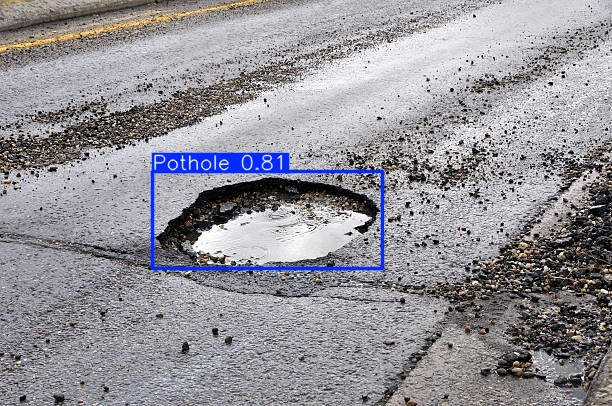

Potholes detected: 8
Displaying output for image: 2


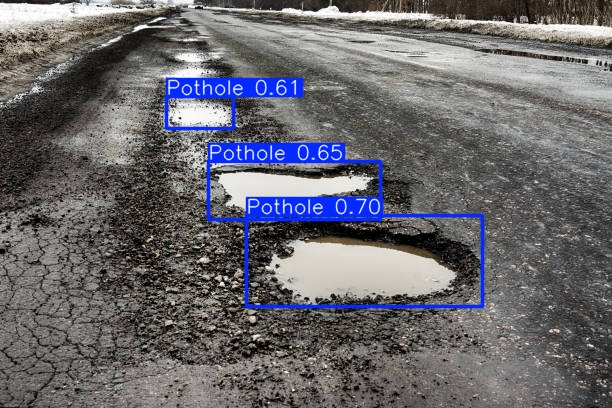

Potholes detected: 8
Displaying output for image: 3


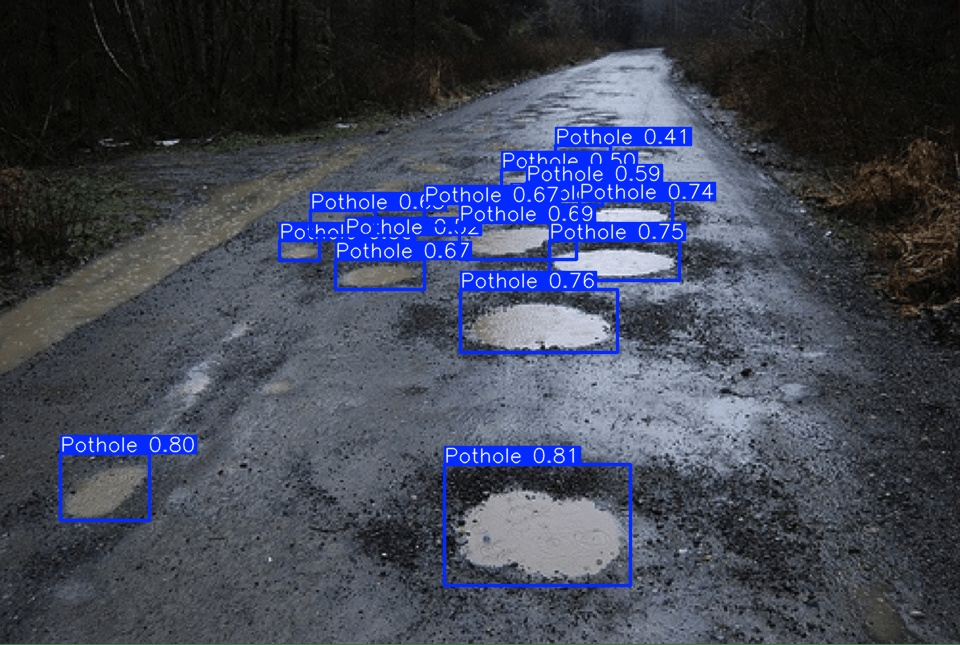

Potholes detected: 8
Displaying output for image: 4


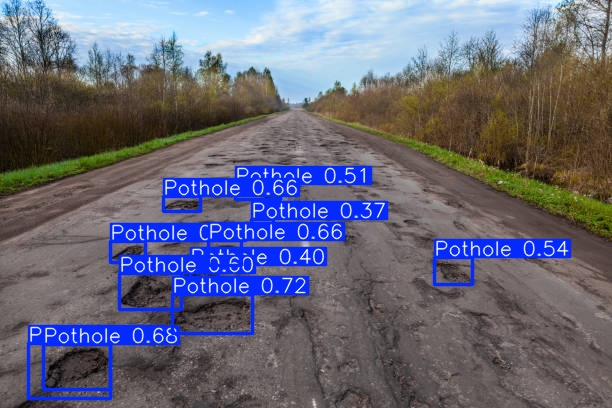

Potholes detected: 8
Displaying output for image: 5


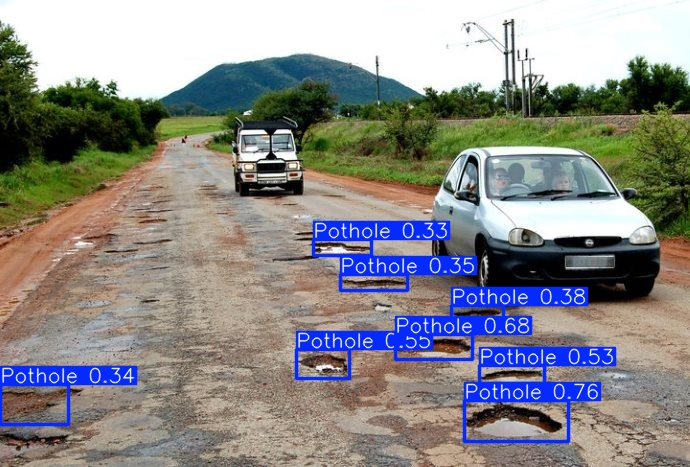

Potholes detected: 8


In [57]:
import os 
from IPython.display import Image, display
pred_dir = "runs/detect/predict5"
for i in range(len(os.listdir(pred_dir))):
    print("Displaying output for image:", i+1)
    output_img = os.listdir(pred_dir)[i] 
    display(Image(filename=os.path.join(pred_dir, output_img)))
    boxes = result[0].boxes
    print("Potholes detected:", len(boxes))

In [7]:
# Training on dataset New pothole detection-2 
from ultralytics import YOLO
model = YOLO("yolo11m.pt")
model.train(data = r"D:\ASTC project\New-pothole-detection-2\data.yaml" ,epochs =20 ,imgsz = 512 , batch = 4 ,name = "New_yoloM_1",workers=8)


New https://pypi.org/project/ultralytics/8.3.183 available  Update with 'pip install -U ultralytics'
Ultralytics 8.3.179  Python-3.11.9 torch-2.5.1+cu121 CUDA:0 (NVIDIA GeForce RTX 3050 6GB Laptop GPU, 6144MiB)
engine\trainer: agnostic_nms=False, amp=True, augment=False, auto_augment=randaugment, batch=4, bgr=0.0, box=7.5, cache=False, cfg=None, classes=None, close_mosaic=10, cls=0.5, conf=None, copy_paste=0.0, copy_paste_mode=flip, cos_lr=False, cutmix=0.0, data=D:\ASTC project\New-pothole-detection-2\data.yaml, degrees=0.0, deterministic=True, device=None, dfl=1.5, dnn=False, dropout=0.0, dynamic=False, embed=None, epochs=20, erasing=0.4, exist_ok=False, fliplr=0.5, flipud=0.0, format=torchscript, fraction=1.0, freeze=None, half=False, hsv_h=0.015, hsv_s=0.7, hsv_v=0.4, imgsz=512, int8=False, iou=0.7, keras=False, kobj=1.0, line_width=None, lr0=0.01, lrf=0.01, mask_ratio=4, max_det=300, mixup=0.0, mode=train, model=yolo11m.pt, momentum=0.937, mosaic=1.0, multi_scale=False, name=New_y

train: Scanning D:\ASTC project\New-pothole-detection-2\train\labels.cache... 6091 images, 4 backgrounds, 0 corrupt: 100%|██████████| 6091/6091 [00:00<?, ?it/s]

WARNING Box and segment counts should be equal, but got len(segments) = 2171, len(boxes) = 15830. To resolve this only boxes will be used and all segments will be removed. To avoid this please supply either a detect or segment dataset, not a detect-segment mixed dataset.


val: Fast image access  (ping: 0.50.2 ms, read: 134.840.6 MB/s, size: 56.4 KB)


val: Scanning D:\ASTC project\New-pothole-detection-2\valid\labels.cache... 2094 images, 0 backgrounds, 0 corrupt: 100%|██████████| 2094/2094 [00:00<?, ?it/s]


Plotting labels to runs\detect\New_yoloM_16\labels.jpg... 
optimizer: 'optimizer=auto' found, ignoring 'lr0=0.01' and 'momentum=0.937' and determining best 'optimizer', 'lr0' and 'momentum' automatically... 
optimizer: AdamW(lr=0.002, momentum=0.9) with parameter groups 106 weight(decay=0.0), 113 weight(decay=0.0005), 112 bias(decay=0.0)
Image sizes 512 train, 512 val
Using 8 dataloader workers
Logging results to runs\detect\New_yoloM_16
Starting training for 20 epochs...

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       1/20      3.27G      2.045      2.322      1.914         16        512: 100%|██████████| 1523/1523 [04:04<00:00,  6.22it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 262/262 [00:27<00:00,  9.39it/s]


                   all       2094       5214      0.366      0.224      0.191     0.0734

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       2/20      3.26G      2.042      2.275      1.917         10        512: 100%|██████████| 1523/1523 [03:51<00:00,  6.58it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 262/262 [00:31<00:00,  8.40it/s]


                   all       2094       5214       0.45      0.375      0.341       0.14

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       3/20      3.26G      1.963      2.145      1.843          9        512: 100%|██████████| 1523/1523 [04:11<00:00,  6.06it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 262/262 [00:28<00:00,  9.20it/s]


                   all       2094       5214      0.468      0.372      0.358      0.151

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       4/20      3.26G      1.904      2.045      1.811         13        512: 100%|██████████| 1523/1523 [04:52<00:00,  5.21it/s] 
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 262/262 [00:28<00:00,  9.34it/s]


                   all       2094       5214      0.501      0.393      0.401      0.172

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       5/20      3.26G      1.856       1.95      1.768          5        512: 100%|██████████| 1523/1523 [1:14:44<00:00,  2.94s/it]     
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 262/262 [00:28<00:00,  9.24it/s]


                   all       2094       5214      0.523      0.475      0.468      0.214

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       6/20      3.26G      1.799      1.846      1.731         10        512: 100%|██████████| 1523/1523 [04:04<00:00,  6.24it/s] 
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 262/262 [03:44<00:00,  1.17it/s]  


                   all       2094       5214      0.556      0.467      0.473      0.223

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       7/20      3.26G      1.774      1.817      1.712          5        512: 100%|██████████| 1523/1523 [03:47<00:00,  6.70it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 262/262 [00:32<00:00,  7.96it/s]


                   all       2094       5214      0.597      0.472      0.504      0.234

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       8/20      3.26G       1.74      1.758      1.685         45        512: 100%|██████████| 1523/1523 [03:59<00:00,  6.36it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 262/262 [00:29<00:00,  8.99it/s]


                   all       2094       5214      0.576      0.483      0.501      0.243

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       9/20      3.26G      1.713      1.712      1.657          5        512: 100%|██████████| 1523/1523 [03:43<00:00,  6.82it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 262/262 [00:29<00:00,  8.77it/s]


                   all       2094       5214      0.614       0.47      0.514      0.248

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      10/20      3.26G      1.698      1.675      1.647          6        512: 100%|██████████| 1523/1523 [03:50<00:00,  6.61it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 262/262 [00:28<00:00,  9.15it/s]


                   all       2094       5214      0.637       0.52      0.569      0.277
Closing dataloader mosaic

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      11/20      3.26G      1.691      1.574      1.652          5        512: 100%|██████████| 1523/1523 [03:43<00:00,  6.83it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 262/262 [00:29<00:00,  8.82it/s]


                   all       2094       5214      0.633      0.523      0.577      0.282

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      12/20      3.26G      1.668      1.527      1.639          4        512: 100%|██████████| 1523/1523 [03:43<00:00,  6.81it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 262/262 [00:29<00:00,  8.97it/s]


                   all       2094       5214      0.676       0.53      0.585      0.289

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      13/20      3.26G      1.653      1.498      1.628          3        512: 100%|██████████| 1523/1523 [03:44<00:00,  6.78it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 262/262 [00:29<00:00,  8.89it/s]


                   all       2094       5214      0.665      0.526      0.591      0.296

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      14/20      3.26G      1.635      1.449      1.612          4        512: 100%|██████████| 1523/1523 [03:54<00:00,  6.50it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 262/262 [00:34<00:00,  7.64it/s]


                   all       2094       5214      0.673      0.553      0.618      0.314

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      15/20      3.26G      1.601      1.409      1.587          7        512: 100%|██████████| 1523/1523 [04:11<00:00,  6.06it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 262/262 [00:34<00:00,  7.51it/s]


                   all       2094       5214      0.678      0.562      0.624      0.323

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      16/20      3.26G      1.588      1.384      1.574          7        512: 100%|██████████| 1523/1523 [04:04<00:00,  6.22it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 262/262 [00:35<00:00,  7.29it/s]


                   all       2094       5214      0.715      0.569      0.649      0.338

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      17/20      3.26G       1.57      1.331      1.569          4        512: 100%|██████████| 1523/1523 [03:50<00:00,  6.62it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 262/262 [00:28<00:00,  9.19it/s]


                   all       2094       5214      0.695      0.583      0.643      0.335

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      18/20      3.26G      1.535      1.303      1.539          3        512: 100%|██████████| 1523/1523 [03:43<00:00,  6.80it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 262/262 [00:31<00:00,  8.23it/s]


                   all       2094       5214      0.713      0.594      0.664      0.349

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      19/20      3.26G      1.523      1.276      1.529          7        512: 100%|██████████| 1523/1523 [04:05<00:00,  6.20it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 262/262 [00:33<00:00,  7.84it/s]


                   all       2094       5214       0.72      0.596      0.674      0.359

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      20/20      3.26G      1.504      1.236      1.516          5        512: 100%|██████████| 1523/1523 [03:39<00:00,  6.92it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 262/262 [00:27<00:00,  9.37it/s]

                   all       2094       5214      0.729      0.609      0.688      0.366



20 epochs completed in 2.756 hours.
Optimizer stripped from runs\detect\New_yoloM_16\weights\last.pt, 40.5MB
Optimizer stripped from runs\detect\New_yoloM_16\weights\best.pt, 40.5MB

Validating runs\detect\New_yoloM_16\weights\best.pt...
Ultralytics 8.3.179  Python-3.11.9 torch-2.5.1+cu121 CUDA:0 (NVIDIA GeForce RTX 3050 6GB Laptop GPU, 6144MiB)
YOLO11m summary (fused): 125 layers, 20,030,803 parameters, 0 gradients, 67.6 GFLOPs


                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 262/262 [00:25<00:00, 10.12it/s]


                   all       2094       5214      0.729      0.609      0.688      0.366
Speed: 0.2ms preprocess, 8.9ms inference, 0.0ms loss, 1.1ms postprocess per image
Results saved to runs\detect\New_yoloM_16


ultralytics.utils.metrics.DetMetrics object with attributes:

ap_class_index: array([0])
box: ultralytics.utils.metrics.Metric object
confusion_matrix: <ultralytics.utils.metrics.ConfusionMatrix object at 0x000001AD1AB82610>
curves: ['Precision-Recall(B)', 'F1-Confidence(B)', 'Precision-Confidence(B)', 'Recall-Confidence(B)']
curves_results: [[array([          0,    0.001001,    0.002002,    0.003003,    0.004004,    0.005005,    0.006006,    0.007007,    0.008008,    0.009009,     0.01001,    0.011011,    0.012012,    0.013013,    0.014014,    0.015015,    0.016016,    0.017017,    0.018018,    0.019019,     0.02002,    0.021021,    0.022022,    0.023023,
          0.024024,    0.025025,    0.026026,    0.027027,    0.028028,    0.029029,     0.03003,    0.031031,    0.032032,    0.033033,    0.034034,    0.035035,    0.036036,    0.037037,    0.038038,    0.039039,     0.04004,    0.041041,    0.042042,    0.043043,    0.044044,    0.045045,    0.046046,    0.047047,
          0.0480

In [3]:
from ultralytics import YOLO
inference_NEW_medium_model = YOLO(r"D:\ASTC project\runs\detect\New_yoloM_16\weights\best.pt")   

In [4]:
import os 
Test_data = r"D:\ASTC project\Data_to_be_predicted"
for files in os.listdir(Test_data):
    image_path = os.path.join(Test_data,files)
    result = inference_NEW_medium_model.predict(image_path ,save_dir = "D:\ASTC project\nano_model_1_POthole2-3",conf = 0.25 ,save=True,device= "cuda")


image 1/1 D:\ASTC project\Data_to_be_predicted\image1.jpg: 352x512 1 Pothole, 86.3ms
Speed: 6.2ms preprocess, 86.3ms inference, 129.5ms postprocess per image at shape (1, 3, 352, 512)
Results saved to runs\detect\predict7

image 1/1 D:\ASTC project\Data_to_be_predicted\image2.jpg: 352x512 4 Potholes, 17.9ms
Speed: 2.3ms preprocess, 17.9ms inference, 2.7ms postprocess per image at shape (1, 3, 352, 512)
Results saved to runs\detect\predict7

image 1/1 D:\ASTC project\Data_to_be_predicted\image3 (1).png: 352x512 14 Potholes, 22.3ms
Speed: 1.5ms preprocess, 22.3ms inference, 2.3ms postprocess per image at shape (1, 3, 352, 512)
Results saved to runs\detect\predict7

image 1/1 D:\ASTC project\Data_to_be_predicted\image4.jpg: 352x512 10 Potholes, 14.7ms
Speed: 1.3ms preprocess, 14.7ms inference, 2.3ms postprocess per image at shape (1, 3, 352, 512)
Results saved to runs\detect\predict7

image 1/1 D:\ASTC project\Data_to_be_predicted\image5.jpg: 352x512 8 Potholes, 16.9ms
Speed: 2.7ms prepr

Displaying output for image: 1


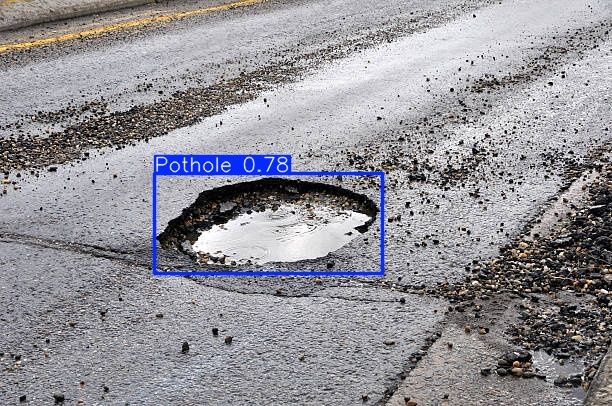

Potholes detected: 8
Displaying output for image: 2


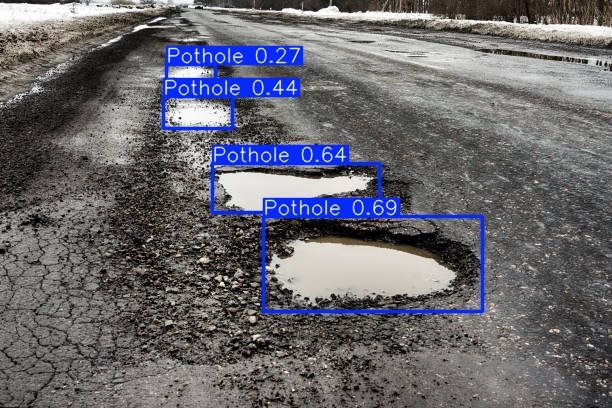

Potholes detected: 8
Displaying output for image: 3


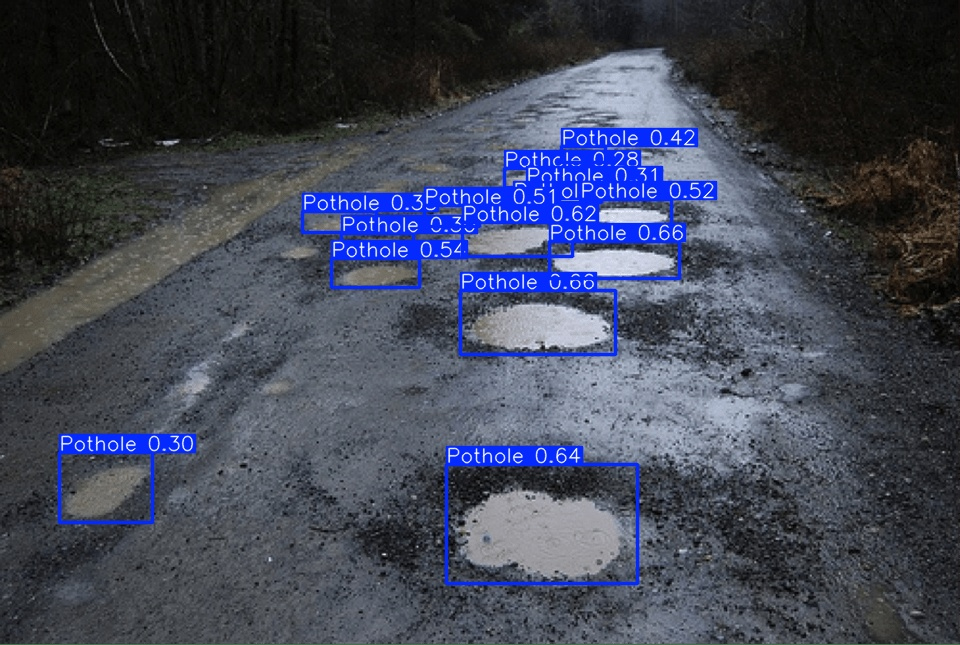

Potholes detected: 8
Displaying output for image: 4


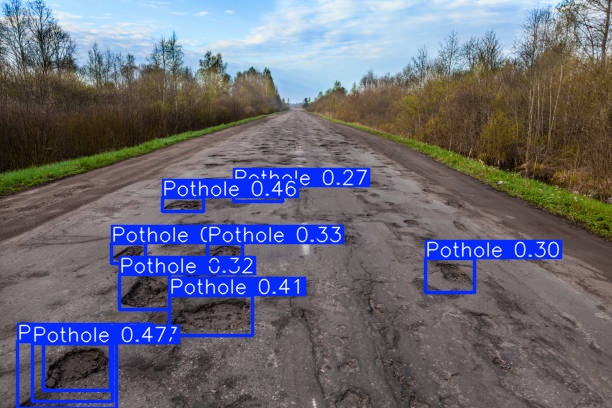

Potholes detected: 8
Displaying output for image: 5


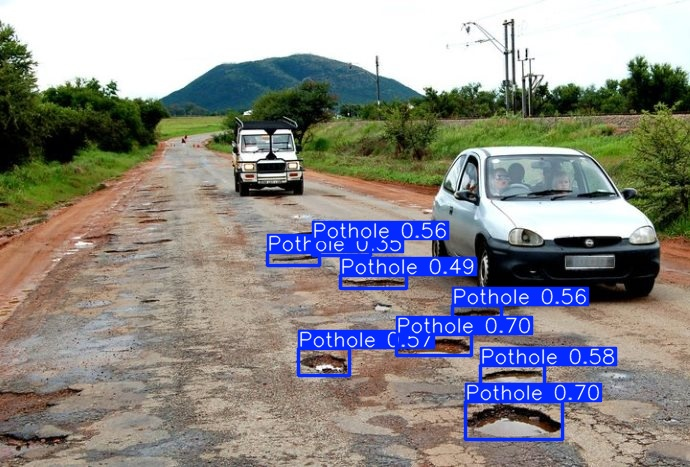

Potholes detected: 8


In [60]:
import os
from IPython.display import Image, display
pred_dir = "runs/detect/predict6"
for i in range(len(os.listdir(pred_dir))):
    print("Displaying output for image:", i+1)
    output_img = os.listdir(pred_dir)[i] 
    display(Image(filename=os.path.join(pred_dir, output_img)))
    boxes = result[0].boxes
    print("Potholes detected:", len(boxes))

# Training the existing model on both datasets [FINAL MODEL WITH BOTH DATSETS]


In [4]:

# Training nano model of Pothole2-3 and training it again on New pothole detection-2
from ultralytics import YOLO
model = inference_nano_model
model.train(data = r"D:\ASTC project\New-pothole-detection-2\data.yaml" ,epochs =40 ,imgsz = 640 , batch = 16 ,name = "yoloN_final_combined",workers=4)

New https://pypi.org/project/ultralytics/8.3.183 available  Update with 'pip install -U ultralytics'
Ultralytics 8.3.179  Python-3.11.9 torch-2.5.1+cu121 CUDA:0 (NVIDIA GeForce RTX 3050 6GB Laptop GPU, 6144MiB)
engine\trainer: agnostic_nms=False, amp=True, augment=False, auto_augment=randaugment, batch=16, bgr=0.0, box=7.5, cache=False, cfg=None, classes=None, close_mosaic=10, cls=0.5, conf=None, copy_paste=0.0, copy_paste_mode=flip, cos_lr=False, cutmix=0.0, data=D:\ASTC project\New-pothole-detection-2\data.yaml, degrees=0.0, deterministic=True, device=None, dfl=1.5, dnn=False, dropout=0.0, dynamic=False, embed=None, epochs=40, erasing=0.4, exist_ok=False, fliplr=0.5, flipud=0.0, format=torchscript, fraction=1.0, freeze=None, half=False, hsv_h=0.015, hsv_s=0.7, hsv_v=0.4, imgsz=640, int8=False, iou=0.7, keras=False, kobj=1.0, line_width=None, lr0=0.01, lrf=0.01, mask_ratio=4, max_det=300, mixup=0.0, mode=train, model=D:\ASTC project\runs\detect\yolon_final\weights\best.pt, momentum=0.

train: Scanning D:\ASTC project\New-pothole-detection-2\train\labels.cache... 6091 images, 4 backgrounds, 0 corrupt: 100%|██████████| 6091/6091 [00:00<?, ?it/s]

WARNING Box and segment counts should be equal, but got len(segments) = 2171, len(boxes) = 15830. To resolve this only boxes will be used and all segments will be removed. To avoid this please supply either a detect or segment dataset, not a detect-segment mixed dataset.


val: Fast image access  (ping: 0.30.2 ms, read: 168.532.3 MB/s, size: 56.4 KB)


val: Scanning D:\ASTC project\New-pothole-detection-2\valid\labels.cache... 2094 images, 0 backgrounds, 0 corrupt: 100%|██████████| 2094/2094 [00:00<?, ?it/s]


Plotting labels to runs\detect\yoloN_final_combined\labels.jpg... 
optimizer: 'optimizer=auto' found, ignoring 'lr0=0.01' and 'momentum=0.937' and determining best 'optimizer', 'lr0' and 'momentum' automatically... 
optimizer: AdamW(lr=0.002, momentum=0.9) with parameter groups 81 weight(decay=0.0), 88 weight(decay=0.0005), 87 bias(decay=0.0)
Image sizes 640 train, 640 val
Using 4 dataloader workers
Logging results to runs\detect\yoloN_final_combined
Starting training for 40 epochs...

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       1/40       2.3G      1.707       1.92      1.626         33        640: 100%|██████████| 381/381 [01:19<00:00,  4.77it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 66/66 [00:13<00:00,  5.08it/s]


                   all       2094       5214      0.626      0.474      0.509      0.238

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       2/40      2.65G      1.743      1.735      1.641         37        640: 100%|██████████| 381/381 [01:21<00:00,  4.70it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 66/66 [00:15<00:00,  4.34it/s]


                   all       2094       5214      0.563      0.482      0.494      0.222

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       3/40      2.65G      1.763      1.731      1.661         33        640: 100%|██████████| 381/381 [01:18<00:00,  4.87it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 66/66 [00:12<00:00,  5.08it/s]


                   all       2094       5214      0.535      0.435      0.447      0.203

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       4/40      2.66G      1.748      1.701      1.645         48        640: 100%|██████████| 381/381 [01:16<00:00,  5.00it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 66/66 [00:14<00:00,  4.70it/s]


                   all       2094       5214      0.483      0.371      0.371      0.165

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       5/40      2.66G      1.726      1.667      1.623         23        640: 100%|██████████| 381/381 [01:18<00:00,  4.84it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 66/66 [00:14<00:00,  4.45it/s]


                   all       2094       5214      0.583      0.475      0.499      0.235

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       6/40      2.66G      1.706      1.624      1.606         47        640: 100%|██████████| 381/381 [01:22<00:00,  4.64it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 66/66 [00:15<00:00,  4.22it/s]


                   all       2094       5214      0.627      0.494      0.539      0.262

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       7/40      2.66G      1.689      1.593      1.594         31        640: 100%|██████████| 381/381 [01:21<00:00,  4.69it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 66/66 [00:15<00:00,  4.17it/s]


                   all       2094       5214      0.621      0.518      0.558      0.273

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       8/40      2.66G      1.673       1.58      1.597         64        640: 100%|██████████| 381/381 [01:20<00:00,  4.72it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 66/66 [00:16<00:00,  3.91it/s]


                   all       2094       5214       0.66      0.544      0.596      0.294

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       9/40      2.66G      1.652      1.529      1.574         36        640: 100%|██████████| 381/381 [01:16<00:00,  4.99it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 66/66 [00:13<00:00,  4.95it/s]


                   all       2094       5214      0.645       0.51      0.557      0.282

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      10/40      2.66G       1.65      1.534      1.572         39        640: 100%|██████████| 381/381 [01:23<00:00,  4.59it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 66/66 [00:16<00:00,  4.06it/s]


                   all       2094       5214      0.663       0.53      0.592      0.294

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      11/40      2.66G       1.62      1.492      1.555         29        640: 100%|██████████| 381/381 [01:17<00:00,  4.90it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 66/66 [00:13<00:00,  4.94it/s]


                   all       2094       5214      0.672      0.519      0.573      0.284

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      12/40      2.66G       1.62      1.479      1.552         24        640: 100%|██████████| 381/381 [01:17<00:00,  4.94it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 66/66 [00:13<00:00,  4.91it/s]


                   all       2094       5214      0.674      0.562      0.615      0.317

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      13/40      2.66G      1.615      1.481      1.555         36        640: 100%|██████████| 381/381 [01:16<00:00,  4.98it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 66/66 [00:14<00:00,  4.71it/s]


                   all       2094       5214      0.648      0.529       0.57      0.282

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      14/40      2.66G      1.597      1.421       1.53         60        640: 100%|██████████| 381/381 [01:21<00:00,  4.66it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 66/66 [00:13<00:00,  4.97it/s]


                   all       2094       5214      0.691      0.567      0.626      0.319

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      15/40      2.66G       1.57      1.402      1.519         42        640: 100%|██████████| 381/381 [01:38<00:00,  3.88it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 66/66 [00:14<00:00,  4.58it/s]


                   all       2094       5214      0.696      0.552      0.625      0.324

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      16/40      2.66G       1.56      1.387      1.507         45        640: 100%|██████████| 381/381 [01:20<00:00,  4.73it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 66/66 [00:15<00:00,  4.34it/s]


                   all       2094       5214      0.691      0.575       0.64       0.33

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      17/40      2.66G      1.568      1.387      1.511         44        640: 100%|██████████| 381/381 [09:24<00:00,  1.48s/it]   
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 66/66 [00:13<00:00,  4.96it/s]


                   all       2094       5214      0.682      0.573      0.637      0.333

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      18/40      2.66G      1.559      1.361      1.509         40        640: 100%|██████████| 381/381 [07:08<00:00,  1.13s/it] 
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 66/66 [00:14<00:00,  4.67it/s]


                   all       2094       5214      0.706      0.589      0.655      0.344

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      19/40      2.66G      1.551      1.362      1.497         49        640: 100%|██████████| 381/381 [01:16<00:00,  5.00it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 66/66 [00:14<00:00,  4.68it/s]


                   all       2094       5214      0.705      0.615      0.674      0.359

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      20/40      2.66G      1.536      1.357      1.499         52        640: 100%|██████████| 381/381 [01:15<00:00,  5.03it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 66/66 [00:14<00:00,  4.57it/s]


                   all       2094       5214      0.712      0.583       0.65      0.344

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      21/40      2.66G      1.525      1.333      1.483         56        640: 100%|██████████| 381/381 [01:20<00:00,  4.75it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 66/66 [00:16<00:00,  4.11it/s]


                   all       2094       5214      0.724      0.619      0.685      0.364

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      22/40      2.66G      1.521      1.322      1.484         39        640: 100%|██████████| 381/381 [01:21<00:00,  4.70it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 66/66 [00:15<00:00,  4.14it/s]


                   all       2094       5214      0.726      0.614      0.689      0.374

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      23/40      2.66G      1.501      1.293      1.465         43        640: 100%|██████████| 381/381 [01:21<00:00,  4.67it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 66/66 [00:15<00:00,  4.37it/s]


                   all       2094       5214      0.739      0.624      0.701      0.375

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      24/40      2.66G        1.5      1.285      1.459         45        640: 100%|██████████| 381/381 [01:21<00:00,  4.65it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 66/66 [00:15<00:00,  4.15it/s]


                   all       2094       5214      0.718      0.625      0.685      0.372

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      25/40      2.66G      1.487      1.268      1.457         32        640: 100%|██████████| 381/381 [01:21<00:00,  4.65it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 66/66 [00:15<00:00,  4.39it/s]


                   all       2094       5214      0.723      0.629      0.697      0.378

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      26/40      2.66G      1.496      1.272       1.46         39        640: 100%|██████████| 381/381 [01:21<00:00,  4.69it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 66/66 [00:15<00:00,  4.14it/s]


                   all       2094       5214      0.746      0.627       0.71      0.392

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      27/40      2.66G      1.471      1.242      1.441         39        640: 100%|██████████| 381/381 [01:14<00:00,  5.09it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 66/66 [00:12<00:00,  5.08it/s]


                   all       2094       5214      0.752      0.648      0.719      0.395

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      28/40      2.66G      1.468      1.235      1.445         46        640: 100%|██████████| 381/381 [01:14<00:00,  5.15it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 66/66 [00:12<00:00,  5.16it/s]


                   all       2094       5214      0.769      0.637      0.723      0.402

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      29/40      2.66G      1.444      1.217      1.426         74        640: 100%|██████████| 381/381 [01:13<00:00,  5.15it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 66/66 [00:13<00:00,  5.07it/s]


                   all       2094       5214      0.744      0.648      0.726      0.406

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      30/40      2.66G      1.443      1.214      1.424         23        640: 100%|██████████| 381/381 [01:16<00:00,  4.95it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 66/66 [00:16<00:00,  4.02it/s]


                   all       2094       5214      0.767      0.658      0.733      0.407
Closing dataloader mosaic

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      31/40      2.66G      1.449      1.119      1.441         23        640: 100%|██████████| 381/381 [01:17<00:00,  4.92it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 66/66 [00:14<00:00,  4.53it/s]


                   all       2094       5214      0.767      0.648      0.736      0.417

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      32/40      2.66G       1.42      1.093      1.427         30        640: 100%|██████████| 381/381 [01:12<00:00,  5.23it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 66/66 [00:12<00:00,  5.27it/s]


                   all       2094       5214      0.766      0.669      0.749      0.424

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      33/40      2.66G      1.409      1.062      1.413         33        640: 100%|██████████| 381/381 [01:14<00:00,  5.12it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 66/66 [00:12<00:00,  5.11it/s]


                   all       2094       5214      0.764       0.69      0.754      0.433

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      34/40      2.66G       1.39      1.047      1.401         15        640: 100%|██████████| 381/381 [01:13<00:00,  5.22it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 66/66 [00:12<00:00,  5.24it/s]


                   all       2094       5214      0.777      0.663      0.752      0.431

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      35/40      2.66G      1.374      1.031      1.393         37        640: 100%|██████████| 381/381 [01:15<00:00,  5.02it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 66/66 [00:14<00:00,  4.57it/s]


                   all       2094       5214      0.767      0.686      0.756      0.437

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      36/40      2.66G      1.366      1.011       1.39         33        640: 100%|██████████| 381/381 [01:13<00:00,  5.19it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 66/66 [00:12<00:00,  5.32it/s]

                   all       2094       5214      0.782      0.691      0.766      0.443



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      37/40      2.66G      1.355      1.003      1.381         23        640: 100%|██████████| 381/381 [02:21<00:00,  2.69it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 66/66 [00:13<00:00,  4.87it/s]


                   all       2094       5214      0.786       0.69      0.765      0.447

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      38/40      2.66G      1.348     0.9916       1.37         26        640: 100%|██████████| 381/381 [01:16<00:00,  4.96it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 66/66 [00:15<00:00,  4.16it/s]


                   all       2094       5214      0.782      0.688      0.767      0.449

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      39/40      2.66G      1.334     0.9736      1.364         28        640: 100%|██████████| 381/381 [01:19<00:00,  4.82it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 66/66 [00:14<00:00,  4.57it/s]


                   all       2094       5214      0.789      0.692      0.769       0.45

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      40/40      2.66G      1.329     0.9615      1.365         22        640: 100%|██████████| 381/381 [01:13<00:00,  5.21it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 66/66 [00:12<00:00,  5.16it/s]


                   all       2094       5214      0.785      0.697       0.77      0.452

40 epochs completed in 1.301 hours.
Optimizer stripped from runs\detect\yoloN_final_combined\weights\last.pt, 5.5MB
Optimizer stripped from runs\detect\yoloN_final_combined\weights\best.pt, 5.5MB

Validating runs\detect\yoloN_final_combined\weights\best.pt...
Ultralytics 8.3.179  Python-3.11.9 torch-2.5.1+cu121 CUDA:0 (NVIDIA GeForce RTX 3050 6GB Laptop GPU, 6144MiB)
YOLO11n summary (fused): 100 layers, 2,582,347 parameters, 0 gradients, 6.3 GFLOPs


                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 66/66 [00:13<00:00,  4.97it/s]


                   all       2094       5214      0.782      0.699       0.77      0.452
Speed: 0.2ms preprocess, 2.8ms inference, 0.0ms loss, 1.1ms postprocess per image
Results saved to runs\detect\yoloN_final_combined


ultralytics.utils.metrics.DetMetrics object with attributes:

ap_class_index: array([0])
box: ultralytics.utils.metrics.Metric object
confusion_matrix: <ultralytics.utils.metrics.ConfusionMatrix object at 0x000001CAC070B150>
curves: ['Precision-Recall(B)', 'F1-Confidence(B)', 'Precision-Confidence(B)', 'Recall-Confidence(B)']
curves_results: [[array([          0,    0.001001,    0.002002,    0.003003,    0.004004,    0.005005,    0.006006,    0.007007,    0.008008,    0.009009,     0.01001,    0.011011,    0.012012,    0.013013,    0.014014,    0.015015,    0.016016,    0.017017,    0.018018,    0.019019,     0.02002,    0.021021,    0.022022,    0.023023,
          0.024024,    0.025025,    0.026026,    0.027027,    0.028028,    0.029029,     0.03003,    0.031031,    0.032032,    0.033033,    0.034034,    0.035035,    0.036036,    0.037037,    0.038038,    0.039039,     0.04004,    0.041041,    0.042042,    0.043043,    0.044044,    0.045045,    0.046046,    0.047047,
          0.0480

In [3]:
from ultralytics import YOLO


inference_Combined_nano_model= YOLO(r"D:\ASTC project\runs\detect\yoloN_final_combined\weights\best.pt")

In [7]:
import os 
Test_data=  r"D:\ASTC project\Data_to_be_predicted"
for files in os.listdir(Test_data):
    image_path = os.path.join(Test_data,files)
    result = inference_Combined_nano_model.predict(image_path ,save_dir = "D:\ASTC project\Combined_nano_model_1_POthole2-3",conf = 0.25 ,save=True,device= "cuda")


image 1/1 D:\ASTC project\Data_to_be_predicted\image1.jpg: 448x640 1 Pothole, 59.4ms
Speed: 4.5ms preprocess, 59.4ms inference, 2.0ms postprocess per image at shape (1, 3, 448, 640)
Results saved to runs\detect\predict8

image 1/1 D:\ASTC project\Data_to_be_predicted\image2.jpg: 448x640 5 Potholes, 42.6ms
Speed: 3.6ms preprocess, 42.6ms inference, 2.6ms postprocess per image at shape (1, 3, 448, 640)
Results saved to runs\detect\predict8

image 1/1 D:\ASTC project\Data_to_be_predicted\image3 (1).png: 448x640 17 Potholes, 31.8ms
Speed: 3.6ms preprocess, 31.8ms inference, 2.4ms postprocess per image at shape (1, 3, 448, 640)
Results saved to runs\detect\predict8

image 1/1 D:\ASTC project\Data_to_be_predicted\image4.jpg: 448x640 16 Potholes, 22.1ms
Speed: 2.2ms preprocess, 22.1ms inference, 2.7ms postprocess per image at shape (1, 3, 448, 640)
Results saved to runs\detect\predict8

image 1/1 D:\ASTC project\Data_to_be_predicted\image5.jpg: 448x640 13 Potholes, 22.0ms
Speed: 2.3ms prepro

Displaying output for image: 1


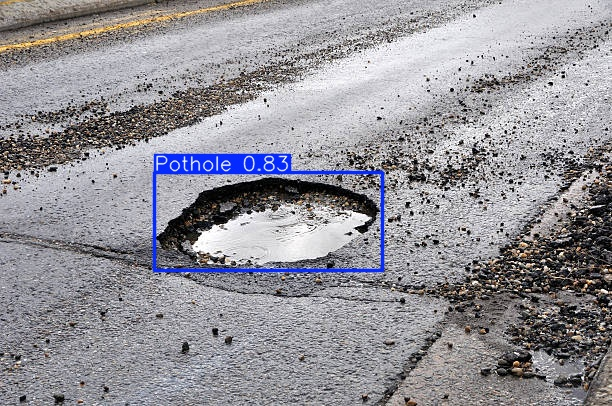

Potholes detected: 13
Displaying output for image: 2


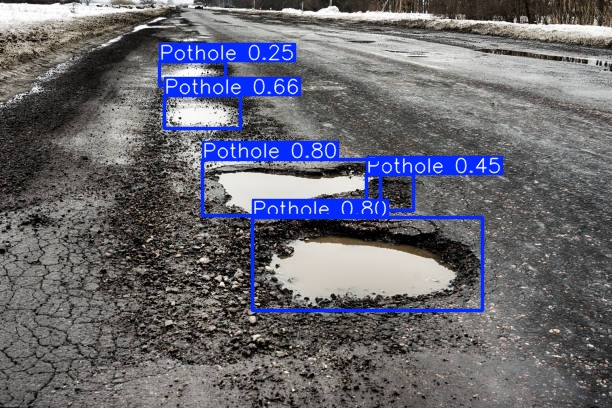

Potholes detected: 13
Displaying output for image: 3


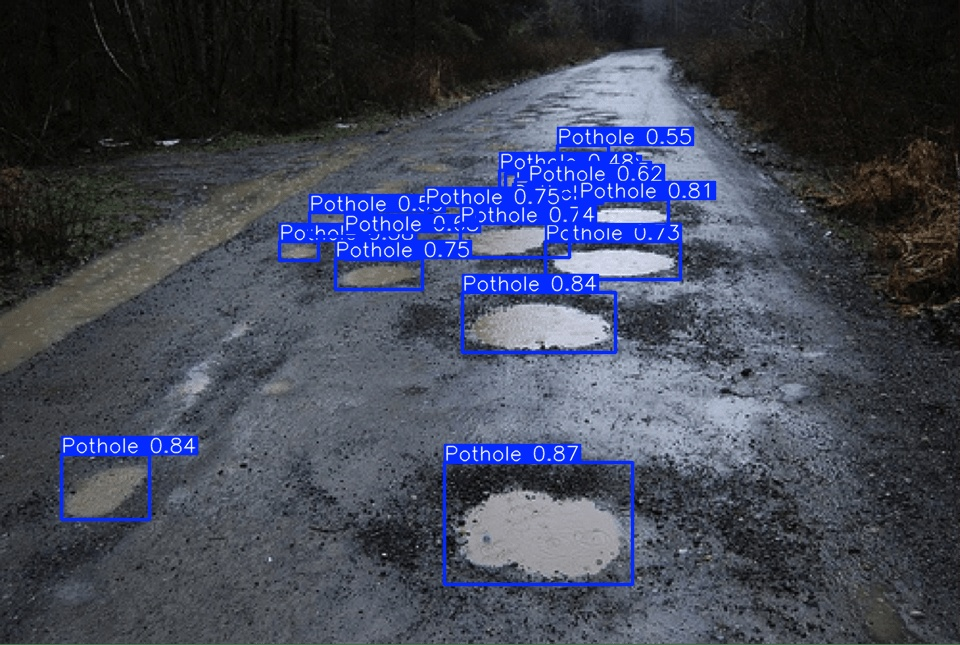

Potholes detected: 13
Displaying output for image: 4


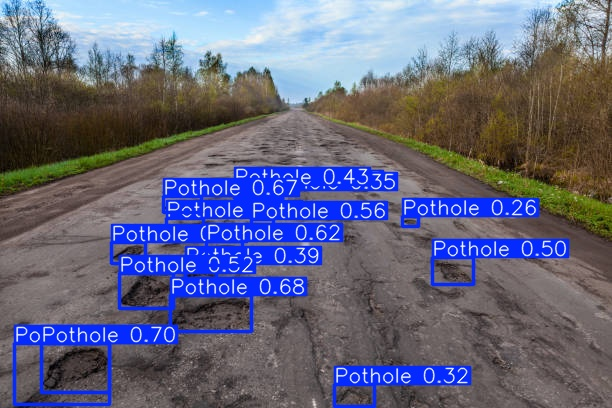

Potholes detected: 13
Displaying output for image: 5


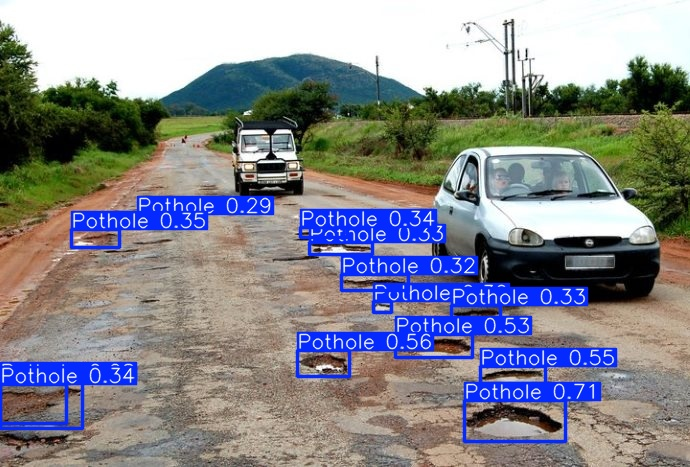

Potholes detected: 13


In [8]:
import os 
from IPython.display import Image,display
pred_dir = "runs/detect/predict7"
for i in range(len(os.listdir(pred_dir))):          
    print("Displaying output for image:", i+1)
    output_img = os.listdir(pred_dir)[i] 
    display(Image(filename=os.path.join(pred_dir, output_img)))
    boxes = result[0].boxes
    print("Potholes detected:", len(boxes))
    

In [12]:
import os 
Test_data = r"D:\ASTC project\Test_data_1_real"
for files in os.listdir(Test_data):
    image_path = os.path.join(Test_data,files)
    result = inference_Combined_nano_model.predict(image_path ,save_dir = "D:\ASTC project\Combined_nano_model_1_POthole2-3",conf = 0.10 ,save=True,device= "cuda")


image 1/1 D:\ASTC project\Test_data_1_real\IMG-20250822-WA0007.jpg: 480x640 (no detections), 50.1ms
Speed: 712.5ms preprocess, 50.1ms inference, 1.1ms postprocess per image at shape (1, 3, 480, 640)
Results saved to runs\detect\predict8

image 1/1 D:\ASTC project\Test_data_1_real\IMG-20250822-WA0008.jpg: 640x480 8 Potholes, 50.8ms
Speed: 3.8ms preprocess, 50.8ms inference, 2.0ms postprocess per image at shape (1, 3, 640, 480)
Results saved to runs\detect\predict8

image 1/1 D:\ASTC project\Test_data_1_real\IMG-20250822-WA0009.jpg: 640x480 1 Pothole, 49.6ms
Speed: 4.3ms preprocess, 49.6ms inference, 3.7ms postprocess per image at shape (1, 3, 640, 480)
Results saved to runs\detect\predict8

image 1/1 D:\ASTC project\Test_data_1_real\IMG-20250822-WA0010.jpg: 480x640 2 Potholes, 51.0ms
Speed: 4.1ms preprocess, 51.0ms inference, 1.7ms postprocess per image at shape (1, 3, 480, 640)
Results saved to runs\detect\predict8


Displaying output for image: 1


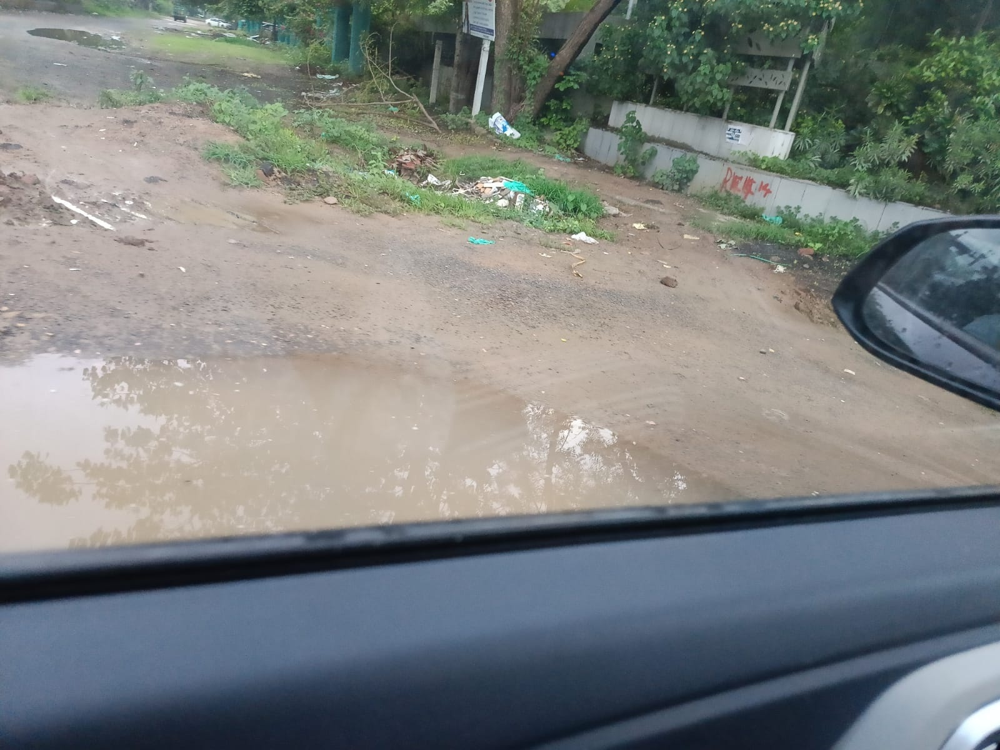

Potholes detected: 2
Displaying output for image: 2


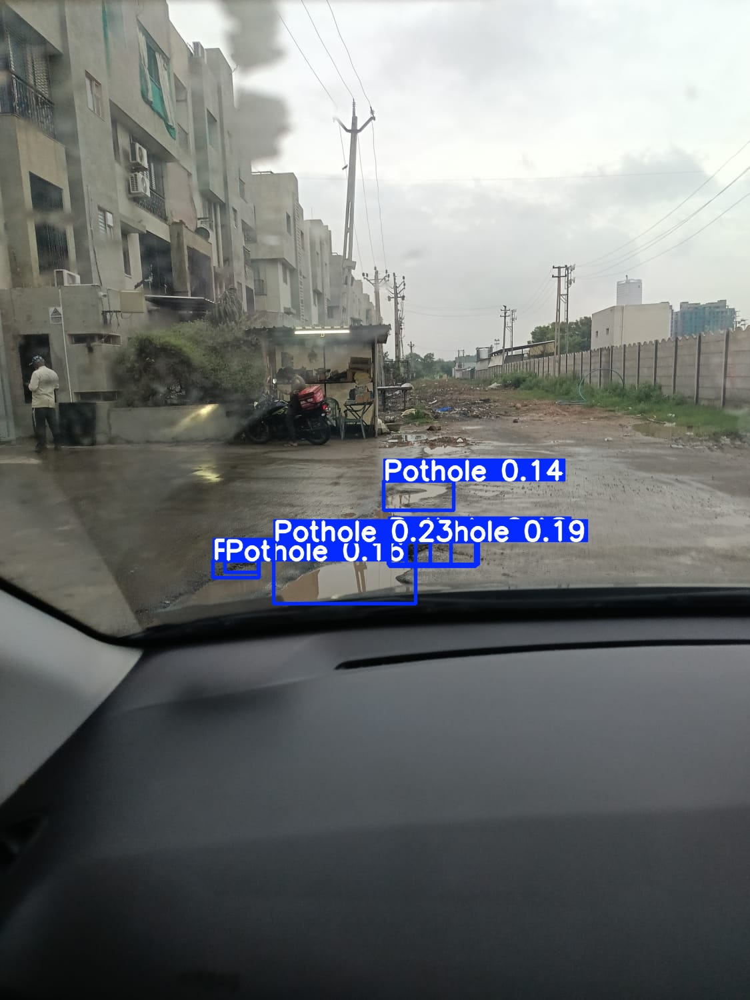

Potholes detected: 2
Displaying output for image: 3


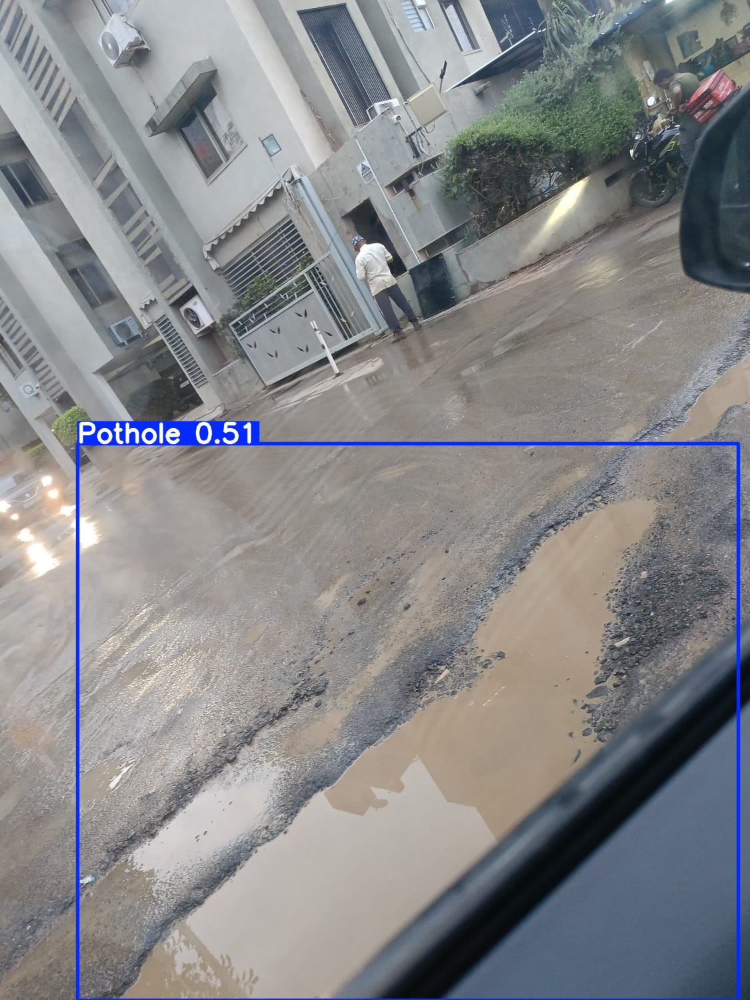

Potholes detected: 2
Displaying output for image: 4


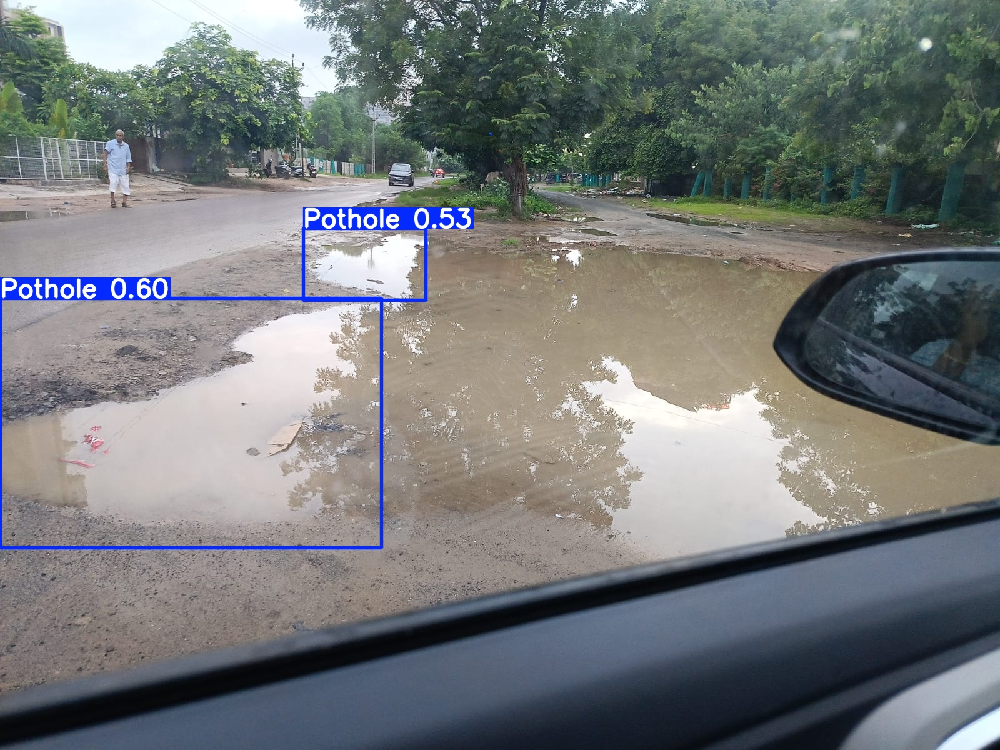

Potholes detected: 2


In [13]:
import os
from IPython.display import Image, display  
pred_dir = "runs/detect/predict8"
for i in range(len(os.listdir(pred_dir))):
    print("Displaying output for image:", i+1)
    output_img = os.listdir(pred_dir)[i] 
    display(Image(filename=os.path.join(pred_dir, output_img)))
    boxes = result[0].boxes
    print("Potholes detected:", len(boxes))

# Small model on both dataset

In [16]:

# Training small model of Pothole2-3 and training it again on New pothole detection-2
from ultralytics import YOLO
model = inference_small_model
model.train(data = r"D:\ASTC project\New-pothole-detection-2\data.yaml" ,epochs =20 ,imgsz = 640 , batch = 16 ,name = "yoloS_final_combined",workers=4)

New https://pypi.org/project/ultralytics/8.3.183 available  Update with 'pip install -U ultralytics'
Ultralytics 8.3.179  Python-3.11.9 torch-2.5.1+cu121 CUDA:0 (NVIDIA GeForce RTX 3050 6GB Laptop GPU, 6144MiB)
engine\trainer: agnostic_nms=False, amp=True, augment=False, auto_augment=randaugment, batch=16, bgr=0.0, box=7.5, cache=False, cfg=None, classes=None, close_mosaic=10, cls=0.5, conf=None, copy_paste=0.0, copy_paste_mode=flip, cos_lr=False, cutmix=0.0, data=D:\ASTC project\New-pothole-detection-2\data.yaml, degrees=0.0, deterministic=True, device=0, dfl=1.5, dnn=False, dropout=0.0, dynamic=False, embed=None, epochs=20, erasing=0.4, exist_ok=False, fliplr=0.5, flipud=0.0, format=torchscript, fraction=1.0, freeze=None, half=False, hsv_h=0.015, hsv_s=0.7, hsv_v=0.4, imgsz=640, int8=False, iou=0.7, keras=False, kobj=1.0, line_width=None, lr0=0.01, lrf=0.01, mask_ratio=4, max_det=300, mixup=0.0, mode=train, model=D:\ASTC project\runs\detect\yolos_final4\weights\best.pt, momentum=0.93

train: Scanning D:\ASTC project\New-pothole-detection-2\train\labels.cache... 6091 images, 4 backgrounds, 0 corrupt: 100%|██████████| 6091/6091 [00:00<?, ?it/s]

WARNING Box and segment counts should be equal, but got len(segments) = 2171, len(boxes) = 15830. To resolve this only boxes will be used and all segments will be removed. To avoid this please supply either a detect or segment dataset, not a detect-segment mixed dataset.


val: Fast image access  (ping: 0.20.1 ms, read: 136.858.6 MB/s, size: 56.4 KB)


val: Scanning D:\ASTC project\New-pothole-detection-2\valid\labels.cache... 2094 images, 0 backgrounds, 0 corrupt: 100%|██████████| 2094/2094 [00:00<?, ?it/s]


Plotting labels to runs\detect\yoloS_final_combined\labels.jpg... 
optimizer: 'optimizer=auto' found, ignoring 'lr0=0.01' and 'momentum=0.937' and determining best 'optimizer', 'lr0' and 'momentum' automatically... 
optimizer: AdamW(lr=0.002, momentum=0.9) with parameter groups 81 weight(decay=0.0), 88 weight(decay=0.0005), 87 bias(decay=0.0)
Image sizes 640 train, 640 val
Using 4 dataloader workers
Logging results to runs\detect\yoloS_final_combined
Starting training for 20 epochs...

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       1/20      4.12G      1.788      2.315      1.738         33        640: 100%|██████████| 381/381 [02:20<00:00,  2.71it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 66/66 [00:20<00:00,  3.22it/s]


                   all       2094       5214      0.412      0.385      0.338      0.147

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       2/20      4.09G      1.807      1.824      1.733         37        640: 100%|██████████| 381/381 [02:09<00:00,  2.94it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 66/66 [00:18<00:00,  3.59it/s]


                   all       2094       5214      0.544      0.418      0.426      0.182

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       3/20      4.14G      1.797      1.817      1.726         33        640: 100%|██████████| 381/381 [02:07<00:00,  2.99it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 66/66 [00:19<00:00,  3.32it/s]


                   all       2094       5214      0.524      0.403      0.408      0.186

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       4/20      4.13G      1.776      1.757      1.704         48        640: 100%|██████████| 381/381 [02:08<00:00,  2.96it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 66/66 [00:18<00:00,  3.57it/s]


                   all       2094       5214      0.547      0.402      0.419      0.187

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       5/20      4.09G      1.742       1.72      1.667         23        640: 100%|██████████| 381/381 [07:20<00:00,  1.16s/it]  
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 66/66 [00:18<00:00,  3.59it/s]


                   all       2094       5214      0.604       0.47      0.513      0.233

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       6/20      4.12G      1.716      1.637      1.648         47        640: 100%|██████████| 381/381 [02:06<00:00,  3.02it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 66/66 [00:18<00:00,  3.55it/s]


                   all       2094       5214      0.661      0.508      0.568      0.275

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       7/20      4.13G      1.686      1.591      1.633         31        640: 100%|██████████| 381/381 [02:07<00:00,  2.99it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 66/66 [00:20<00:00,  3.26it/s]


                   all       2094       5214      0.647      0.521      0.572      0.281

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       8/20      4.13G      1.669      1.561      1.632         64        640: 100%|██████████| 381/381 [02:08<00:00,  2.96it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 66/66 [00:21<00:00,  3.08it/s]


                   all       2094       5214      0.664      0.517      0.573      0.275

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       9/20      4.12G      1.633      1.516      1.597         36        640: 100%|██████████| 381/381 [02:07<00:00,  2.98it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 66/66 [00:18<00:00,  3.55it/s]


                   all       2094       5214      0.658      0.537      0.587      0.295

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      10/20       4.1G      1.627      1.496      1.594         39        640: 100%|██████████| 381/381 [02:06<00:00,  3.01it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 66/66 [00:18<00:00,  3.54it/s]


                   all       2094       5214       0.68       0.52      0.587      0.299
Closing dataloader mosaic

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      11/20      4.12G      1.635      1.413       1.61         21        640: 100%|██████████| 381/381 [02:07<00:00,  3.00it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 66/66 [00:20<00:00,  3.17it/s]


                   all       2094       5214      0.656      0.565      0.618      0.319

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      12/20      4.14G      1.614      1.378      1.597         29        640: 100%|██████████| 381/381 [02:07<00:00,  3.00it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 66/66 [00:18<00:00,  3.55it/s]


                   all       2094       5214      0.712      0.582      0.654      0.341

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      13/20       4.1G      1.583      1.333      1.571         21        640: 100%|██████████| 381/381 [02:05<00:00,  3.03it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 66/66 [00:18<00:00,  3.48it/s]


                   all       2094       5214      0.722      0.579      0.664      0.347

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      14/20      4.13G      1.571      1.292      1.565         17        640: 100%|██████████| 381/381 [02:05<00:00,  3.03it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 66/66 [00:18<00:00,  3.53it/s]


                   all       2094       5214      0.686        0.6      0.663       0.35

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      15/20      4.12G       1.54      1.264      1.547         22        640: 100%|██████████| 381/381 [02:06<00:00,  3.01it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 66/66 [00:20<00:00,  3.24it/s]


                   all       2094       5214      0.724      0.611      0.678       0.36

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      16/20      4.12G       1.52      1.217      1.531         24        640: 100%|██████████| 381/381 [02:09<00:00,  2.95it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 66/66 [00:22<00:00,  2.97it/s]


                   all       2094       5214      0.719      0.624       0.69      0.374

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      17/20      4.09G      1.494      1.188      1.513         16        640: 100%|██████████| 381/381 [02:07<00:00,  2.98it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 66/66 [00:18<00:00,  3.61it/s]


                   all       2094       5214      0.732      0.613      0.692      0.382

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      18/20      4.11G      1.463      1.156      1.494         27        640: 100%|██████████| 381/381 [02:05<00:00,  3.03it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 66/66 [00:20<00:00,  3.30it/s]


                   all       2094       5214      0.743      0.638      0.718      0.398

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      19/20      4.11G      1.445      1.127      1.484         72        640: 100%|██████████| 381/381 [02:09<00:00,  2.95it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 66/66 [00:20<00:00,  3.28it/s]


                   all       2094       5214      0.751      0.642       0.73      0.406

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      20/20      4.12G      1.421      1.094       1.46         25        640: 100%|██████████| 381/381 [02:08<00:00,  2.97it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 66/66 [00:19<00:00,  3.33it/s]


                   all       2094       5214      0.761      0.648      0.735      0.414

20 epochs completed in 0.926 hours.
Optimizer stripped from runs\detect\yoloS_final_combined\weights\last.pt, 19.2MB
Optimizer stripped from runs\detect\yoloS_final_combined\weights\best.pt, 19.2MB

Validating runs\detect\yoloS_final_combined\weights\best.pt...
Ultralytics 8.3.179  Python-3.11.9 torch-2.5.1+cu121 CUDA:0 (NVIDIA GeForce RTX 3050 6GB Laptop GPU, 6144MiB)
YOLO11s summary (fused): 100 layers, 9,413,187 parameters, 0 gradients, 21.3 GFLOPs


                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 66/66 [00:20<00:00,  3.20it/s]


                   all       2094       5214      0.761      0.648      0.735      0.414
Speed: 0.2ms preprocess, 5.5ms inference, 0.0ms loss, 1.3ms postprocess per image
Results saved to runs\detect\yoloS_final_combined


ultralytics.utils.metrics.DetMetrics object with attributes:

ap_class_index: array([0])
box: ultralytics.utils.metrics.Metric object
confusion_matrix: <ultralytics.utils.metrics.ConfusionMatrix object at 0x000001DE19B459D0>
curves: ['Precision-Recall(B)', 'F1-Confidence(B)', 'Precision-Confidence(B)', 'Recall-Confidence(B)']
curves_results: [[array([0.        , 0.001001  , 0.002002  , 0.003003  , 0.004004  ,
       0.00500501, 0.00600601, 0.00700701, 0.00800801, 0.00900901,
       0.01001001, 0.01101101, 0.01201201, 0.01301301, 0.01401401,
       0.01501502, 0.01601602, 0.01701702, 0.01801802, 0.01901902,
       0.02002002, 0.02102102, 0.02202202, 0.02302302, 0.02402402,
       0.02502503, 0.02602603, 0.02702703, 0.02802803, 0.02902903,
       0.03003003, 0.03103103, 0.03203203, 0.03303303, 0.03403403,
       0.03503504, 0.03603604, 0.03703704, 0.03803804, 0.03903904,
       0.04004004, 0.04104104, 0.04204204, 0.04304304, 0.04404404,
       0.04504505, 0.04604605, 0.04704705, 0.048048

In [2]:
from ultralytics import YOLO
inference_Combined_small_model= YOLO(r"D:\ASTC project\runs\detect\yoloS_final_combined\weights\best.pt")

In [19]:
import os 
Test_data=  r"D:\ASTC project\Data_to_be_predicted"
for files in os.listdir(Test_data):
    image_path = os.path.join(Test_data,files)
    result = inference_Combined_small_model.predict(image_path ,conf = 0.25 ,save=True,device= "cuda")


image 1/1 D:\ASTC project\Data_to_be_predicted\image1.jpg: 448x640 1 Pothole, 75.1ms
Speed: 4.3ms preprocess, 75.1ms inference, 2.9ms postprocess per image at shape (1, 3, 448, 640)
Results saved to runs\detect\predict7

image 1/1 D:\ASTC project\Data_to_be_predicted\image2.jpg: 448x640 3 Potholes, 8.0ms
Speed: 1.3ms preprocess, 8.0ms inference, 1.9ms postprocess per image at shape (1, 3, 448, 640)
Results saved to runs\detect\predict7

image 1/1 D:\ASTC project\Data_to_be_predicted\image3 (1).png: 448x640 14 Potholes, 8.9ms
Speed: 1.5ms preprocess, 8.9ms inference, 1.5ms postprocess per image at shape (1, 3, 448, 640)
Results saved to runs\detect\predict7

image 1/1 D:\ASTC project\Data_to_be_predicted\image4.jpg: 448x640 11 Potholes, 7.9ms
Speed: 1.3ms preprocess, 7.9ms inference, 1.2ms postprocess per image at shape (1, 3, 448, 640)
Results saved to runs\detect\predict7

image 1/1 D:\ASTC project\Data_to_be_predicted\image5.jpg: 448x640 10 Potholes, 7.8ms
Speed: 1.1ms preprocess, 7

Displaying output for image: 1


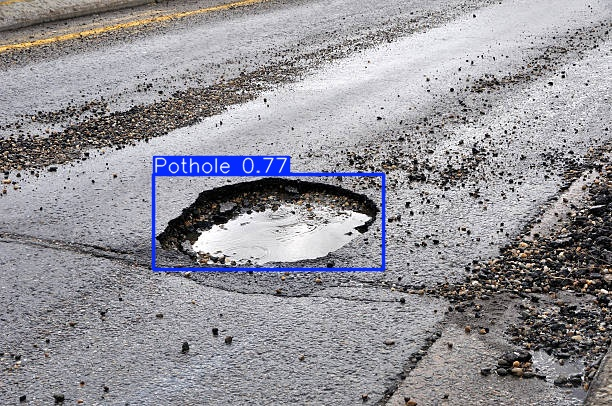

Potholes detected: 10
Displaying output for image: 2


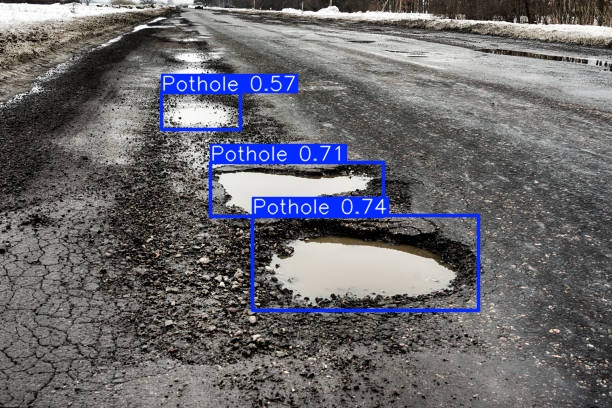

Potholes detected: 10
Displaying output for image: 3


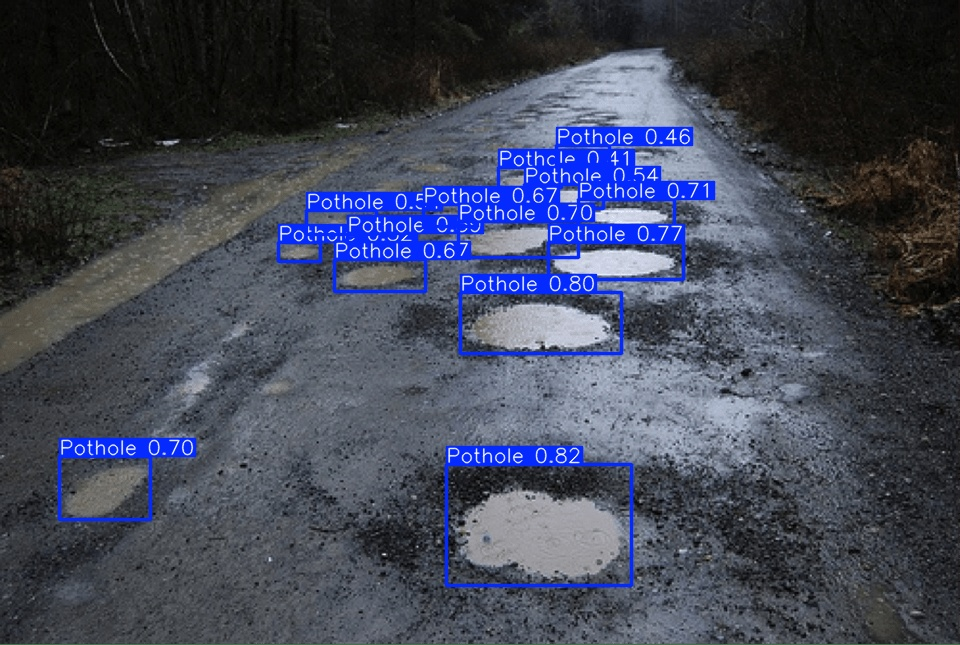

Potholes detected: 10
Displaying output for image: 4


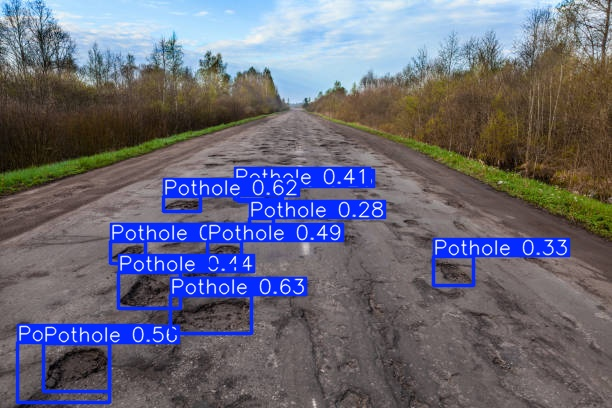

Potholes detected: 10
Displaying output for image: 5


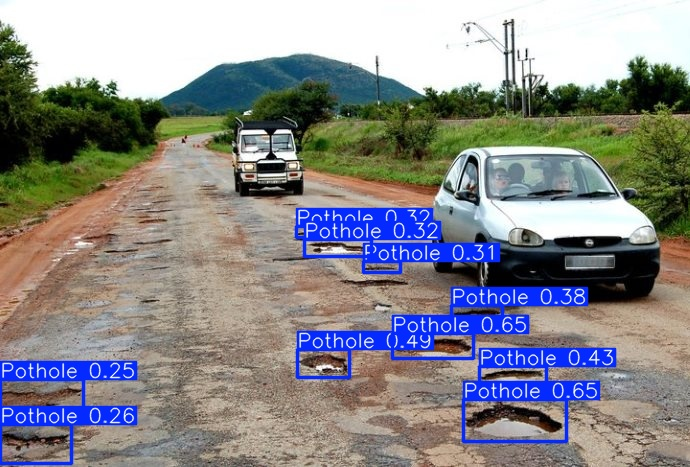

Potholes detected: 10


In [20]:
import os
from IPython.display import Image, display 
pred_dir = "runs/detect/predict_small_combined"
for i in range(len(os.listdir(pred_dir))):
    print("Displaying output for image:", i+1)
    output_img = os.listdir(pred_dir)[i] 
    display(Image(filename=os.path.join(pred_dir, output_img)))
    boxes = result[0].boxes
    print("Potholes detected:", len(boxes))

In [21]:
import os 
Test_data = r"D:\ASTC project\Test_data_1_real"
for files in os.listdir(Test_data):
    image_path = os.path.join(Test_data,files)
    result = inference_Combined_small_model.predict(image_path ,save_dir = "D:\ASTC project\Combined_nano_model_1_POthole2-3",conf = 0.10 ,save=True,device= "cuda")


image 1/1 D:\ASTC project\Test_data_1_real\IMG-20250822-WA0007.jpg: 480x640 (no detections), 122.2ms
Speed: 4.8ms preprocess, 122.2ms inference, 0.7ms postprocess per image at shape (1, 3, 480, 640)
Results saved to runs\detect\predict7

image 1/1 D:\ASTC project\Test_data_1_real\IMG-20250822-WA0008.jpg: 640x480 11 Potholes, 116.8ms
Speed: 4.2ms preprocess, 116.8ms inference, 1.4ms postprocess per image at shape (1, 3, 640, 480)
Results saved to runs\detect\predict7

image 1/1 D:\ASTC project\Test_data_1_real\IMG-20250822-WA0009.jpg: 640x480 2 Potholes, 70.3ms
Speed: 4.2ms preprocess, 70.3ms inference, 3.3ms postprocess per image at shape (1, 3, 640, 480)
Results saved to runs\detect\predict7

image 1/1 D:\ASTC project\Test_data_1_real\IMG-20250822-WA0010.jpg: 480x640 2 Potholes, 9.8ms
Speed: 1.8ms preprocess, 9.8ms inference, 1.8ms postprocess per image at shape (1, 3, 480, 640)
Results saved to runs\detect\predict7


In [2]:
# Training medium model of Pothole2-3 and training it again on New pothole detection-2
from ultralytics import YOLO
model = inference_medium_model
model.train(data = r"D:\ASTC project\New-pothole-detection-2\data.yaml" ,epochs =20 ,imgsz = 512 , batch = 4 ,name = "yoloM_final_combined",workers=4)

New https://pypi.org/project/ultralytics/8.3.185 available  Update with 'pip install -U ultralytics'
Ultralytics 8.3.179  Python-3.11.9 torch-2.5.1+cu121 CUDA:0 (NVIDIA GeForce RTX 3050 6GB Laptop GPU, 6144MiB)
engine\trainer: agnostic_nms=False, amp=True, augment=False, auto_augment=randaugment, batch=4, bgr=0.0, box=7.5, cache=False, cfg=None, classes=None, close_mosaic=10, cls=0.5, conf=None, copy_paste=0.0, copy_paste_mode=flip, cos_lr=False, cutmix=0.0, data=D:\ASTC project\New-pothole-detection-2\data.yaml, degrees=0.0, deterministic=True, device=None, dfl=1.5, dnn=False, dropout=0.0, dynamic=False, embed=None, epochs=20, erasing=0.4, exist_ok=False, fliplr=0.5, flipud=0.0, format=torchscript, fraction=1.0, freeze=None, half=False, hsv_h=0.015, hsv_s=0.7, hsv_v=0.4, imgsz=512, int8=False, iou=0.7, keras=False, kobj=1.0, line_width=None, lr0=0.01, lrf=0.01, mask_ratio=4, max_det=300, mixup=0.0, mode=train, model=D:\ASTC project\runs\detect\yoloM_final3\weights\best.pt, momentum=0.

train: Scanning D:\ASTC project\New-pothole-detection-2\train\labels.cache... 6091 images, 4 backgrounds, 0 corrupt: 100%|██████████| 6091/6091 [00:00<?, ?it/s]

WARNING Box and segment counts should be equal, but got len(segments) = 2171, len(boxes) = 15830. To resolve this only boxes will be used and all segments will be removed. To avoid this please supply either a detect or segment dataset, not a detect-segment mixed dataset.


val: Fast image access  (ping: 0.10.0 ms, read: 168.749.5 MB/s, size: 56.4 KB)


val: Scanning D:\ASTC project\New-pothole-detection-2\valid\labels.cache... 2094 images, 0 backgrounds, 0 corrupt: 100%|██████████| 2094/2094 [00:00<?, ?it/s]


Plotting labels to runs\detect\yoloM_final_combined4\labels.jpg... 
optimizer: 'optimizer=auto' found, ignoring 'lr0=0.01' and 'momentum=0.937' and determining best 'optimizer', 'lr0' and 'momentum' automatically... 
optimizer: AdamW(lr=0.002, momentum=0.9) with parameter groups 106 weight(decay=0.0), 113 weight(decay=0.0005), 112 bias(decay=0.0)
Image sizes 512 train, 512 val
Using 4 dataloader workers
Logging results to runs\detect\yoloM_final_combined4
Starting training for 20 epochs...

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       1/20      1.63G      1.908      2.133      1.818         12        512: 100%|██████████| 1523/1523 [03:59<00:00,  6.35it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 262/262 [00:31<00:00,  8.38it/s]


                   all       2094       5214      0.484      0.365      0.352      0.139

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       2/20      1.88G      1.932      2.094      1.817         10        512: 100%|██████████| 1523/1523 [03:59<00:00,  6.35it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 262/262 [00:31<00:00,  8.27it/s]


                   all       2094       5214      0.428      0.392      0.356      0.152

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       3/20      1.88G       1.91      2.017      1.803          9        512: 100%|██████████| 1523/1523 [03:59<00:00,  6.35it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 262/262 [00:28<00:00,  9.31it/s]


                   all       2094       5214      0.488      0.385      0.375      0.163

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       4/20      1.88G       1.88      1.989      1.779         22        512: 100%|██████████| 1523/1523 [03:42<00:00,  6.86it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 262/262 [00:28<00:00,  9.28it/s]


                   all       2094       5214      0.541      0.455      0.462      0.205

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       5/20      1.88G      1.826      1.915      1.737         11        512: 100%|██████████| 1523/1523 [05:18<00:00,  4.79it/s]  
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 262/262 [00:28<00:00,  9.25it/s]


                   all       2094       5214      0.598      0.477      0.507      0.236

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       6/20      1.88G      1.783      1.825      1.698          9        512: 100%|██████████| 1523/1523 [03:53<00:00,  6.53it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 262/262 [00:32<00:00,  8.10it/s]


                   all       2094       5214      0.561      0.479      0.495      0.228

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       7/20      1.88G       1.76      1.795      1.684         10        512: 100%|██████████| 1523/1523 [04:00<00:00,  6.32it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 262/262 [00:31<00:00,  8.24it/s]


                   all       2094       5214      0.593      0.455      0.489      0.227

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       8/20      1.88G      1.741      1.732      1.674         12        512: 100%|██████████| 1523/1523 [03:58<00:00,  6.39it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 262/262 [00:32<00:00,  8.16it/s]


                   all       2094       5214      0.618      0.506      0.537      0.257

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       9/20      1.88G      1.711      1.681       1.65          8        512: 100%|██████████| 1523/1523 [04:04<00:00,  6.22it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 262/262 [00:31<00:00,  8.31it/s]


                   all       2094       5214       0.66      0.511      0.567      0.277

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      10/20      1.88G      1.695      1.659      1.635          7        512: 100%|██████████| 1523/1523 [03:54<00:00,  6.50it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 262/262 [00:28<00:00,  9.25it/s]

                   all       2094       5214      0.642      0.513       0.56      0.271


Closing dataloader mosaic

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      11/20      1.88G      1.689      1.557      1.648          5        512: 100%|██████████| 1523/1523 [03:47<00:00,  6.70it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 262/262 [00:29<00:00,  8.95it/s]


                   all       2094       5214      0.639      0.528      0.572      0.278

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      12/20      1.88G       1.68      1.518      1.646          4        512: 100%|██████████| 1523/1523 [04:03<00:00,  6.26it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 262/262 [00:29<00:00,  9.01it/s]


                   all       2094       5214      0.679      0.544      0.607      0.302

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      13/20      1.88G      1.642      1.478      1.611          3        512: 100%|██████████| 1523/1523 [20:50<00:00,  1.22it/s]   
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 262/262 [00:29<00:00,  9.02it/s]


                   all       2094       5214      0.678      0.545      0.606      0.302

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      14/20      1.88G      1.629      1.438      1.601          4        512: 100%|██████████| 1523/1523 [07:21<00:00,  3.45it/s]  
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 262/262 [00:31<00:00,  8.29it/s]


                   all       2094       5214      0.698      0.561      0.631      0.323

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      15/20      1.88G      1.601      1.388      1.582          7        512: 100%|██████████| 1523/1523 [03:56<00:00,  6.44it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 262/262 [00:30<00:00,  8.51it/s]


                   all       2094       5214      0.716      0.565       0.64      0.333

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      16/20      1.88G      1.574      1.363      1.558          6        512: 100%|██████████| 1523/1523 [03:54<00:00,  6.49it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 262/262 [00:29<00:00,  8.90it/s]


                   all       2094       5214      0.692      0.579      0.642      0.335

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      17/20      1.88G      1.564      1.333      1.552          4        512: 100%|██████████| 1523/1523 [03:50<00:00,  6.60it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 262/262 [00:29<00:00,  8.81it/s]


                   all       2094       5214      0.704      0.581      0.652      0.346

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      18/20      1.88G      1.535      1.291      1.533          3        512: 100%|██████████| 1523/1523 [04:21<00:00,  5.82it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 262/262 [00:29<00:00,  8.92it/s]


                   all       2094       5214      0.706      0.591       0.66      0.353

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      19/20      1.88G      1.516      1.259      1.522          7        512: 100%|██████████| 1523/1523 [04:34<00:00,  5.56it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 262/262 [00:32<00:00,  8.00it/s]


                   all       2094       5214       0.71      0.599      0.674      0.361

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      20/20      1.88G      1.495      1.233      1.512          5        512: 100%|██████████| 1523/1523 [04:15<00:00,  5.96it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 262/262 [00:31<00:00,  8.24it/s]


                   all       2094       5214      0.697      0.614      0.676      0.366

20 epochs completed in 1.897 hours.
Optimizer stripped from runs\detect\yoloM_final_combined4\weights\last.pt, 40.5MB
Optimizer stripped from runs\detect\yoloM_final_combined4\weights\best.pt, 40.5MB

Validating runs\detect\yoloM_final_combined4\weights\best.pt...
Ultralytics 8.3.179  Python-3.11.9 torch-2.5.1+cu121 CUDA:0 (NVIDIA GeForce RTX 3050 6GB Laptop GPU, 6144MiB)
YOLO11m summary (fused): 125 layers, 20,030,803 parameters, 0 gradients, 67.6 GFLOPs


                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 262/262 [00:26<00:00,  9.86it/s]


                   all       2094       5214      0.698      0.614      0.677      0.366
Speed: 0.2ms preprocess, 9.0ms inference, 0.0ms loss, 1.1ms postprocess per image
Results saved to runs\detect\yoloM_final_combined4


ultralytics.utils.metrics.DetMetrics object with attributes:

ap_class_index: array([0])
box: ultralytics.utils.metrics.Metric object
confusion_matrix: <ultralytics.utils.metrics.ConfusionMatrix object at 0x0000022C89B322D0>
curves: ['Precision-Recall(B)', 'F1-Confidence(B)', 'Precision-Confidence(B)', 'Recall-Confidence(B)']
curves_results: [[array([          0,    0.001001,    0.002002,    0.003003,    0.004004,    0.005005,    0.006006,    0.007007,    0.008008,    0.009009,     0.01001,    0.011011,    0.012012,    0.013013,    0.014014,    0.015015,    0.016016,    0.017017,    0.018018,    0.019019,     0.02002,    0.021021,    0.022022,    0.023023,
          0.024024,    0.025025,    0.026026,    0.027027,    0.028028,    0.029029,     0.03003,    0.031031,    0.032032,    0.033033,    0.034034,    0.035035,    0.036036,    0.037037,    0.038038,    0.039039,     0.04004,    0.041041,    0.042042,    0.043043,    0.044044,    0.045045,    0.046046,    0.047047,
          0.0480

In [3]:
from ultralytics import YOLO
inference_Combined_medium_model= YOLO(r"D:\ASTC project\runs\detect\yoloM_final_combined4\weights\best.pt")

In [5]:
import os 
Test_data=  r"D:\ASTC project\Data_to_be_predicted"
for files in os.listdir(Test_data):
    image_path = os.path.join(Test_data,files)
    result = inference_Combined_medium_model.predict(image_path ,conf = 0.25 ,save=True,device= "cuda")


image 1/1 D:\ASTC project\Data_to_be_predicted\image1.jpg: 352x512 1 Pothole, 50.0ms
Speed: 1.5ms preprocess, 50.0ms inference, 5.0ms postprocess per image at shape (1, 3, 352, 512)
Results saved to runs\detect\predict7

image 1/1 D:\ASTC project\Data_to_be_predicted\image2.jpg: 352x512 3 Potholes, 12.4ms
Speed: 1.0ms preprocess, 12.4ms inference, 2.9ms postprocess per image at shape (1, 3, 352, 512)
Results saved to runs\detect\predict7

image 1/1 D:\ASTC project\Data_to_be_predicted\image3 (1).png: 352x512 8 Potholes, 12.7ms
Speed: 1.2ms preprocess, 12.7ms inference, 1.4ms postprocess per image at shape (1, 3, 352, 512)
Results saved to runs\detect\predict7

image 1/1 D:\ASTC project\Data_to_be_predicted\image4.jpg: 352x512 7 Potholes, 12.6ms
Speed: 0.8ms preprocess, 12.6ms inference, 1.2ms postprocess per image at shape (1, 3, 352, 512)
Results saved to runs\detect\predict7

image 1/1 D:\ASTC project\Data_to_be_predicted\image5.jpg: 352x512 6 Potholes, 12.8ms
Speed: 1.0ms preproces

Displaying output for image: 1


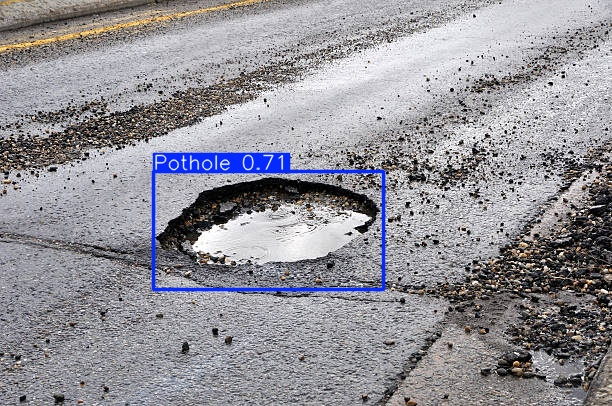

Potholes detected: 6
Displaying output for image: 2


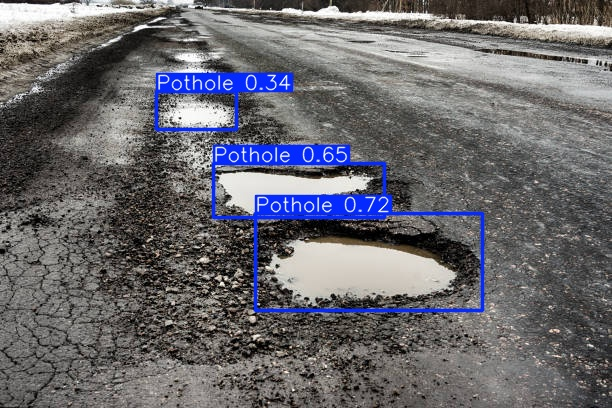

Potholes detected: 6
Displaying output for image: 3


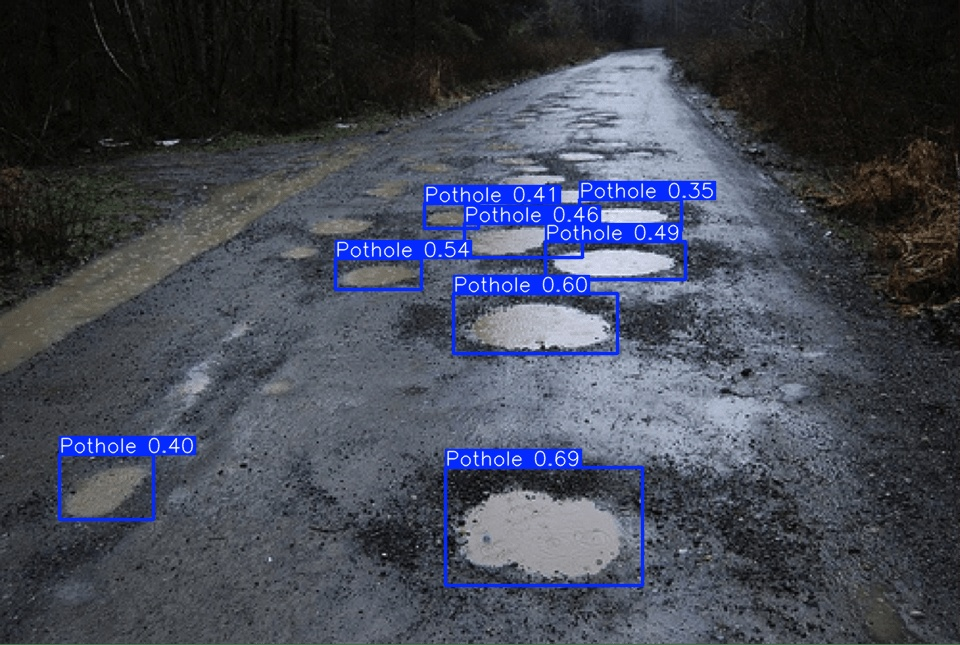

Potholes detected: 6
Displaying output for image: 4


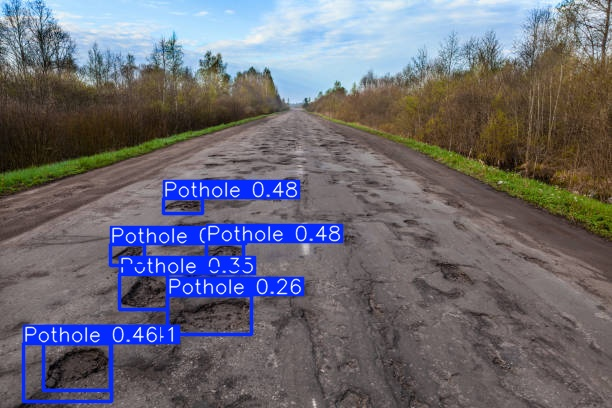

Potholes detected: 6
Displaying output for image: 5


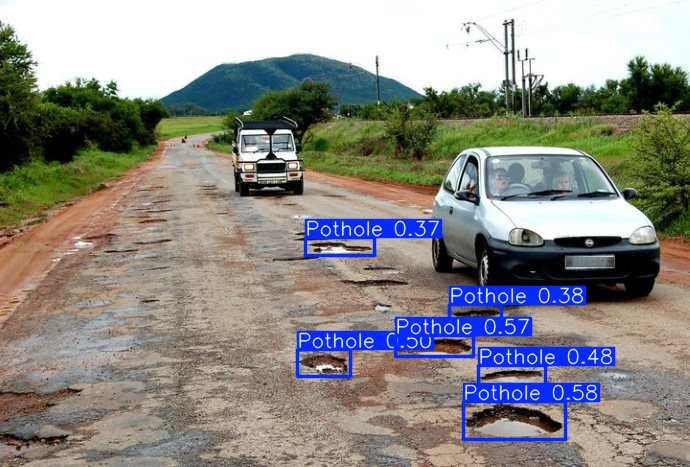

Potholes detected: 6


In [6]:
import os
from IPython.display import Image, display 
pred_dir = "runs/detect/predict_medium_combined"
for i in range(len(os.listdir(pred_dir))):
    print("Displaying output for image:", i+1)
    output_img = os.listdir(pred_dir)[i] 
    display(Image(filename=os.path.join(pred_dir, output_img)))
    boxes = result[0].boxes
    print("Potholes detected:", len(boxes))

In [12]:
Test_Pothole_2_3 = r"D:\ASTC project\Pothole-2-3\test\images"
for files in os.listdir(Test_Pothole_2_3):
    image_path = os.path.join(Test_Pothole_2_3,files)
    result = inference_Combined_nano_model.predict(image_path ,conf = 0.25 ,save=True,device= "cuda")


image 1/1 D:\ASTC project\Pothole-2-3\test\images\0000060_jpg.rf.9073677e623a79d6385864c446c25bc8.jpg: 640x640 (no detections), 71.1ms
Speed: 5.4ms preprocess, 71.1ms inference, 1.4ms postprocess per image at shape (1, 3, 640, 640)
Results saved to runs\detect\predict8

image 1/1 D:\ASTC project\Pothole-2-3\test\images\0000060_jpg.rf.9bf0ebfc25a419901a6943b4fcfb1744.jpg: 640x640 (no detections), 69.8ms
Speed: 5.6ms preprocess, 69.8ms inference, 0.9ms postprocess per image at shape (1, 3, 640, 640)
Results saved to runs\detect\predict8

image 1/1 D:\ASTC project\Pothole-2-3\test\images\0000060_jpg.rf.d09b8562c47011c0f66a6a988d60a725.jpg: 640x640 (no detections), 69.4ms
Speed: 5.7ms preprocess, 69.4ms inference, 0.9ms postprocess per image at shape (1, 3, 640, 640)
Results saved to runs\detect\predict8

image 1/1 D:\ASTC project\Pothole-2-3\test\images\0000060_jpg.rf.f6b06dae5dbf0602d611b8eac9fe9770.jpg: 640x640 (no detections), 69.4ms
Speed: 6.4ms preprocess, 69.4ms inference, 1.3ms po

In [15]:
import os 
Test_Pothole_2_3 = r"D:\ASTC project\Pothole-2-3\test\images"
for files in os.listdir(Test_Pothole_2_3):
    image_path = os.path.join(Test_Pothole_2_3,files)
    result = inference_Combined_small_model.predict(image_path ,conf = 0.25 ,save=True,device= "cuda")


image 1/1 D:\ASTC project\Pothole-2-3\test\images\0000060_jpg.rf.9073677e623a79d6385864c446c25bc8.jpg: 640x640 (no detections), 173.0ms
Speed: 6.2ms preprocess, 173.0ms inference, 1.2ms postprocess per image at shape (1, 3, 640, 640)
Results saved to runs\detect\predict7

image 1/1 D:\ASTC project\Pothole-2-3\test\images\0000060_jpg.rf.9bf0ebfc25a419901a6943b4fcfb1744.jpg: 640x640 (no detections), 11.3ms
Speed: 2.0ms preprocess, 11.3ms inference, 0.6ms postprocess per image at shape (1, 3, 640, 640)
Results saved to runs\detect\predict7

image 1/1 D:\ASTC project\Pothole-2-3\test\images\0000060_jpg.rf.d09b8562c47011c0f66a6a988d60a725.jpg: 640x640 (no detections), 10.6ms
Speed: 1.9ms preprocess, 10.6ms inference, 1.4ms postprocess per image at shape (1, 3, 640, 640)
Results saved to runs\detect\predict7

image 1/1 D:\ASTC project\Pothole-2-3\test\images\0000060_jpg.rf.f6b06dae5dbf0602d611b8eac9fe9770.jpg: 640x640 (no detections), 11.1ms
Speed: 1.8ms preprocess, 11.1ms inference, 0.6ms 

In [13]:
import os 
Test_New_pothole = r"D:\ASTC project\New-pothole-detection-2\test\images"
for files in os.listdir(Test_New_pothole):
    image_path = os.path.join(Test_New_pothole,files)
    result = inference_Combined_small_model.predict(image_path ,conf = 0.25 ,save=True,device= "cuda")


image 1/1 D:\ASTC project\New-pothole-detection-2\test\images\0004_jpg.rf.ca7c5c7984d0c49b97d713a94471d3bb.jpg: 640x640 2 Potholes, 171.6ms
Speed: 5.6ms preprocess, 171.6ms inference, 1.6ms postprocess per image at shape (1, 3, 640, 640)
Results saved to runs\detect\predict7

image 1/1 D:\ASTC project\New-pothole-detection-2\test\images\0040_jpg.rf.e2f36706cf838f5d200eb16a20c6cbfc.jpg: 640x640 2 Potholes, 148.1ms
Speed: 5.3ms preprocess, 148.1ms inference, 1.3ms postprocess per image at shape (1, 3, 640, 640)
Results saved to runs\detect\predict7

image 1/1 D:\ASTC project\New-pothole-detection-2\test\images\0041_jpg.rf.efc0fc84d518111906db05a8e6f90812.jpg: 640x640 2 Potholes, 10.3ms
Speed: 1.8ms preprocess, 10.3ms inference, 1.2ms postprocess per image at shape (1, 3, 640, 640)
Results saved to runs\detect\predict7

image 1/1 D:\ASTC project\New-pothole-detection-2\test\images\0081_jpg.rf.4e1952374ff9705d3d46d823d2a3b3aa.jpg: 640x640 1 Pothole, 11.1ms
Speed: 1.9ms preprocess, 11.1ms 

In [14]:
import os 
Test_New_pothole = r"D:\ASTC project\New-pothole-detection-2\test\images"
for files in os.listdir(Test_New_pothole):
    image_path = os.path.join(Test_New_pothole,files)
    result = inference_Combined_nano_model.predict(image_path ,conf = 0.25 ,save=True,device= "cuda")


image 1/1 D:\ASTC project\New-pothole-detection-2\test\images\0004_jpg.rf.ca7c5c7984d0c49b97d713a94471d3bb.jpg: 640x640 2 Potholes, 73.3ms
Speed: 6.0ms preprocess, 73.3ms inference, 2.1ms postprocess per image at shape (1, 3, 640, 640)
Results saved to runs\detect\predict8

image 1/1 D:\ASTC project\New-pothole-detection-2\test\images\0040_jpg.rf.e2f36706cf838f5d200eb16a20c6cbfc.jpg: 640x640 1 Pothole, 72.9ms
Speed: 5.5ms preprocess, 72.9ms inference, 1.6ms postprocess per image at shape (1, 3, 640, 640)
Results saved to runs\detect\predict8

image 1/1 D:\ASTC project\New-pothole-detection-2\test\images\0041_jpg.rf.efc0fc84d518111906db05a8e6f90812.jpg: 640x640 2 Potholes, 73.0ms
Speed: 5.2ms preprocess, 73.0ms inference, 2.0ms postprocess per image at shape (1, 3, 640, 640)
Results saved to runs\detect\predict8

image 1/1 D:\ASTC project\New-pothole-detection-2\test\images\0081_jpg.rf.4e1952374ff9705d3d46d823d2a3b3aa.jpg: 640x640 1 Pothole, 8.0ms
Speed: 2.0ms preprocess, 8.0ms inferen

In [5]:
import os
import shutil
label = r"D:\ASTC project\Dataset 3\Data\labels"
images =r"D:\ASTC project\Dataset 3\Data\images"
folder_name = r"D:\ASTC project\Dataset 3\Data"
for filename in os.listdir(folder_name):
    if filename.endswith(".txt"):
        shutil.move(os.path.join(folder_name, filename), os.path.join(label, filename))
    if filename.endswith(".jpg"):
        shutil.move(os.path.join(folder_name, filename), os.path.join(images, filename))

In [8]:
import os 
Five_weather_data = r"D:\ASTC project\Dataset 3\Data\images"
for files in os.listdir(Five_weather_data):
    image_path = os.path.join(Five_weather_data,files)
    result = inference_Combined_nano_model.predict(image_path ,conf = 0.25 ,save=True,device= "cuda")


image 1/1 D:\ASTC project\Dataset 3\Data\images\Vid_1_Ca_00000000.jpg: 384x640 1 Pothole, 60.1ms
Speed: 3.4ms preprocess, 60.1ms inference, 87.6ms postprocess per image at shape (1, 3, 384, 640)
Results saved to runs\detect\predict7

image 1/1 D:\ASTC project\Dataset 3\Data\images\Vid_1_Ca_00000001.jpg: 384x640 1 Pothole, 7.3ms
Speed: 1.7ms preprocess, 7.3ms inference, 1.5ms postprocess per image at shape (1, 3, 384, 640)
Results saved to runs\detect\predict7

image 1/1 D:\ASTC project\Dataset 3\Data\images\Vid_1_Ca_00000002.jpg: 384x640 1 Pothole, 14.0ms
Speed: 1.5ms preprocess, 14.0ms inference, 3.2ms postprocess per image at shape (1, 3, 384, 640)
Results saved to runs\detect\predict7

image 1/1 D:\ASTC project\Dataset 3\Data\images\Vid_1_Ca_00000003.jpg: 384x640 1 Pothole, 13.7ms
Speed: 2.3ms preprocess, 13.7ms inference, 1.5ms postprocess per image at shape (1, 3, 384, 640)
Results saved to runs\detect\predict7

image 1/1 D:\ASTC project\Dataset 3\Data\images\Vid_1_Ca_00000004.jp

In [11]:
import os 
Five_weather_data = r"D:\ASTC project\Dataset 3\Data\images"
for files in os.listdir(Five_weather_data):
    image_path = os.path.join(Five_weather_data,files)
    result = inference_Combined_small_model.predict(image_path ,conf = 0.25 ,save=True,device= "cuda")


image 1/1 D:\ASTC project\Dataset 3\Data\images\Vid_1_Ca_00000000.jpg: 384x640 1 Pothole, 72.1ms
Speed: 3.6ms preprocess, 72.1ms inference, 1.2ms postprocess per image at shape (1, 3, 384, 640)
Results saved to runs\detect\predict7

image 1/1 D:\ASTC project\Dataset 3\Data\images\Vid_1_Ca_00000001.jpg: 384x640 (no detections), 7.4ms
Speed: 1.2ms preprocess, 7.4ms inference, 0.5ms postprocess per image at shape (1, 3, 384, 640)
Results saved to runs\detect\predict7

image 1/1 D:\ASTC project\Dataset 3\Data\images\Vid_1_Ca_00000002.jpg: 384x640 (no detections), 6.8ms
Speed: 1.5ms preprocess, 6.8ms inference, 0.5ms postprocess per image at shape (1, 3, 384, 640)
Results saved to runs\detect\predict7

image 1/1 D:\ASTC project\Dataset 3\Data\images\Vid_1_Ca_00000003.jpg: 384x640 (no detections), 9.3ms
Speed: 1.4ms preprocess, 9.3ms inference, 0.5ms postprocess per image at shape (1, 3, 384, 640)
Results saved to runs\detect\predict7

image 1/1 D:\ASTC project\Dataset 3\Data\images\Vid_1_C

In [2]:
import os 
import shutil 
import random

source_dir=r"D:\ASTC project\runs\detect\predict_nano_combine_on_pothole2-3"
Destination_dir=r"D:\ASTC project\Final results\Nano_combine_on_pothole2-3"

num_images = 100 
all_images = [f for f in os.listdir(source_dir) if f.lower().endswith(('.jpg'))]
selected_images = random.sample(all_images, min(num_images, len(all_images)))

for img in selected_images:
    shutil.copy(os.path.join(source_dir, img), os.path.join(Destination_dir, img))

In [2]:
import os 
import shutil 
import random

source_dir=r"D:\ASTC project\runs\detect\predict_five_weather_small_combined"
Destination_dir=r"D:\ASTC project\Final results\Small_five_weather_result"

num_images = 100 
all_images = [f for f in os.listdir(source_dir) if f.lower().endswith(('.jpg'))]
selected_images = random.sample(all_images, min(num_images, len(all_images)))

for img in selected_images:
    shutil.copy(os.path.join(source_dir, img), os.path.join(Destination_dir, img))

In [ ]:
import os
import random
import shutil

dataset_path = r"D:\ASTC project\Dataset 3\Data"

images_path = os.path.join(dataset_path, "images")
labels_path = os.path.join(dataset_path, "labels")

# Output directories
output_dir = r"D:\ASTC project\dataset3_splitted"
for split in ["train", "val", "test"]:
    os.makedirs(os.path.join(output_dir, split, "images"), exist_ok=True)
    os.makedirs(os.path.join(output_dir, split, "labels"), exist_ok=True)

# Get all images
all_images = [f for f in os.listdir(images_path) if f.endswith((".jpg"))]
# random.shuffle(all_images)

# Split ratios
train_ratio = 0.7
val_ratio = 0.2
test_ratio = 0.1

train_split = int(len(all_images) * train_ratio)
val_split = int(len(all_images) * (train_ratio + val_ratio))

train_files = all_images[:train_split]
val_files = all_images[train_split:val_split]
test_files = all_images[val_split:]

def copy_files(file_list, split):
    for file in file_list:

        src_img = os.path.join(images_path, file)
        dst_img = os.path.join(output_dir, split, "images", file)
        shutil.copy(src_img, dst_img)

        label_file = os.path.splitext(file)[0] + ".txt"
        src_label = os.path.join(labels_path, label_file)
        if os.path.exists(src_label):
            dst_label = os.path.join(output_dir, split, "labels", label_file)
            shutil.copy(src_label, dst_label)

copy_files(train_files, "train")
copy_files(val_files, "val")
copy_files(test_files, "test")


In [14]:

from ultralytics import YOLO
model = inference_Combined_nano_model
model.train(data = r"D:\ASTC project\dataset3_splitted\data.yaml" ,epochs =20 ,imgsz = 640 , batch = 16 ,name = "yoloN_combined_five_weather",workers=4)

New https://pypi.org/project/ultralytics/8.3.187 available  Update with 'pip install -U ultralytics'
Ultralytics 8.3.179  Python-3.11.9 torch-2.5.1+cu121 CUDA:0 (NVIDIA GeForce RTX 3050 6GB Laptop GPU, 6144MiB)
engine\trainer: agnostic_nms=False, amp=True, augment=False, auto_augment=randaugment, batch=16, bgr=0.0, box=7.5, cache=False, cfg=None, classes=None, close_mosaic=10, cls=0.5, conf=None, copy_paste=0.0, copy_paste_mode=flip, cos_lr=False, cutmix=0.0, data=D:\ASTC project\dataset3_splitted\data.yaml, degrees=0.0, deterministic=True, device=None, dfl=1.5, dnn=False, dropout=0.0, dynamic=False, embed=None, epochs=20, erasing=0.4, exist_ok=False, fliplr=0.5, flipud=0.0, format=torchscript, fraction=1.0, freeze=None, half=False, hsv_h=0.015, hsv_s=0.7, hsv_v=0.4, imgsz=640, int8=False, iou=0.7, keras=False, kobj=1.0, line_width=None, lr0=0.01, lrf=0.01, mask_ratio=4, max_det=300, mixup=0.0, mode=train, model=D:\ASTC project\runs\detect\yoloN_final_combined\weights\best.pt, momentum

train: Scanning D:\ASTC project\dataset3_splitted\train\labels.cache... 1469 images, 391 backgrounds, 203 corrupt: 100%|██████████| 1469/1469 [00:00<?, ?it/s]

train: D:\ASTC project\dataset3_splitted\train\images\Vid_1_Ca_00000058.jpg: ignoring corrupt image/label: Label class 1 exceeds dataset class count 1. Possible class labels are 0-0
train: D:\ASTC project\dataset3_splitted\train\images\Vid_1_Ca_00000059.jpg: ignoring corrupt image/label: Label class 1 exceeds dataset class count 1. Possible class labels are 0-0
train: D:\ASTC project\dataset3_splitted\train\images\Vid_1_Ca_00000060.jpg: ignoring corrupt image/label: Label class 1 exceeds dataset class count 1. Possible class labels are 0-0
train: D:\ASTC project\dataset3_splitted\train\images\Vid_1_Ca_00000061.jpg: ignoring corrupt image/label: Label class 1 exceeds dataset class count 1. Possible class labels are 0-0
train: D:\ASTC project\dataset3_splitted\train\images\Vid_1_Ca_00000062.jpg: ignoring corrupt image/label: Label class 1 exceeds dataset class count 1. Possible class labels are 0-0
train: D:\ASTC project\dataset3_splitted\train\images\Vid_1_Ca_00000063.jpg: ignoring corr

val: Fast image access  (ping: 0.10.0 ms, read: 1511.9203.8 MB/s, size: 365.6 KB)


val: Scanning D:\ASTC project\dataset3_splitted\valid\labels.cache... 420 images, 114 backgrounds, 58 corrupt: 100%|██████████| 420/420 [00:00<?, ?it/s]

val: D:\ASTC project\dataset3_splitted\valid\images\Vid_Ca_sunset_00000027.jpg: ignoring corrupt image/label: Label class 1 exceeds dataset class count 1. Possible class labels are 0-0
val: D:\ASTC project\dataset3_splitted\valid\images\Vid_Ca_sunset_00000028.jpg: ignoring corrupt image/label: Label class 1 exceeds dataset class count 1. Possible class labels are 0-0
val: D:\ASTC project\dataset3_splitted\valid\images\Vid_Ca_sunset_00000029.jpg: ignoring corrupt image/label: Label class 1 exceeds dataset class count 1. Possible class labels are 0-0
val: D:\ASTC project\dataset3_splitted\valid\images\Vid_Ca_sunset_00000061.jpg: ignoring corrupt image/label: Label class 1 exceeds dataset class count 1. Possible class labels are 0-0
val: D:\ASTC project\dataset3_splitted\valid\images\Vid_Ca_sunset_00000062.jpg: ignoring corrupt image/label: Label class 1 exceeds dataset class count 1. Possible class labels are 0-0
val: D:\ASTC project\dataset3_splitted\valid\images\Vid_Ca_sunset_00000063.

Plotting labels to runs\detect\yoloN_combined_five_weather11\labels.jpg... 
optimizer: 'optimizer=auto' found, ignoring 'lr0=0.01' and 'momentum=0.937' and determining best 'optimizer', 'lr0' and 'momentum' automatically... 
optimizer: AdamW(lr=0.002, momentum=0.9) with parameter groups 81 weight(decay=0.0), 88 weight(decay=0.0005), 87 bias(decay=0.0)
Image sizes 640 train, 640 val
Using 4 dataloader workers
Logging results to runs\detect\yoloN_combined_five_weather11
Starting training for 20 epochs...

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       1/20      2.25G        2.1      2.264      1.177         39        640:   4%|▍         | 3/80 [00:01<00:25,  3.06it/s]Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x00000207EA2B16C0>
Traceback (most recent call last):
  File "d:\ASTC project\.venv\Lib\site-packages\torch\utils\data\dataloader.py", line 1604, in __del__
    self._shutdown_workers()
  File "d:\ASTC project\.venv\Lib\site-packages\torch\utils\data\dataloader.py", line 1562, in _shutdown_workers
    if self._persistent_workers or self._workers_status[worker_id]:
                                   ^^^^^^^^^^^^^^^^^^^^
AttributeError: '_MultiProcessingDataLoaderIter' object has no attribute '_workers_status'
       1/20      2.25G      2.106      1.967      1.159          8        640: 100%|██████████| 80/80 [00:17<00:00,  4.57it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 12/12 [00:01<00:00,  6.96it/s]

                   all        362        497      0.615      0.577      0.597      0.227



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       2/20      2.25G      2.064      1.592      1.144          9        640: 100%|██████████| 80/80 [00:15<00:00,  5.09it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 12/12 [00:01<00:00,  6.98it/s]

                   all        362        497       0.59      0.525      0.514      0.166



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       3/20      2.25G      2.065      1.453      1.141         11        640: 100%|██████████| 80/80 [00:15<00:00,  5.13it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 12/12 [00:01<00:00,  6.34it/s]

                   all        362        497      0.623      0.582      0.591      0.217



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       4/20      2.25G      2.065      1.416      1.134          4        640: 100%|██████████| 80/80 [00:15<00:00,  5.17it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 12/12 [00:01<00:00,  7.03it/s]

                   all        362        497      0.637      0.569      0.581      0.214



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       5/20      2.25G      2.055      1.367       1.14          7        640: 100%|██████████| 80/80 [00:15<00:00,  5.16it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 12/12 [00:01<00:00,  6.68it/s]

                   all        362        497      0.557      0.446      0.451      0.163



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       6/20      2.25G      2.033      1.312      1.148          6        640: 100%|██████████| 80/80 [00:15<00:00,  5.09it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 12/12 [00:01<00:00,  6.58it/s]

                   all        362        497      0.544      0.425      0.459      0.171



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       7/20      2.25G      2.023      1.326      1.126          2        640: 100%|██████████| 80/80 [00:15<00:00,  5.09it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 12/12 [00:01<00:00,  6.65it/s]

                   all        362        497      0.624      0.545      0.583      0.222



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       8/20      2.25G      2.034      1.305       1.13          2        640: 100%|██████████| 80/80 [00:15<00:00,  5.08it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 12/12 [00:01<00:00,  6.60it/s]

                   all        362        497      0.604      0.509      0.535      0.189



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       9/20      2.25G      1.983      1.274      1.134          5        640: 100%|██████████| 80/80 [00:15<00:00,  5.08it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 12/12 [00:01<00:00,  6.46it/s]

                   all        362        497       0.65      0.582       0.59      0.224



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      10/20      2.25G      2.019      1.255       1.14          2        640: 100%|██████████| 80/80 [00:15<00:00,  5.06it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 12/12 [00:01<00:00,  6.42it/s]

                   all        362        497      0.679      0.565      0.625      0.237


Closing dataloader mosaic

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      11/20      2.25G      2.046      1.333      1.187          2        640: 100%|██████████| 80/80 [00:16<00:00,  5.00it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 12/12 [00:01<00:00,  6.73it/s]

                   all        362        497      0.591      0.515       0.53      0.195



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      12/20      2.25G      2.012       1.26      1.173          4        640: 100%|██████████| 80/80 [00:15<00:00,  5.04it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 12/12 [00:01<00:00,  6.06it/s]

                   all        362        497      0.652      0.571      0.598      0.216



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      13/20      2.25G      1.986       1.24      1.163          3        640: 100%|██████████| 80/80 [00:16<00:00,  4.89it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 12/12 [00:01<00:00,  6.43it/s]

                   all        362        497      0.652      0.598      0.622      0.229



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      14/20      2.25G      1.966      1.214      1.148          7        640: 100%|██████████| 80/80 [00:15<00:00,  5.06it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 12/12 [00:01<00:00,  6.07it/s]

                   all        362        497      0.635      0.556      0.578      0.205



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      15/20      2.25G      1.965      1.195      1.159          1        640: 100%|██████████| 80/80 [00:15<00:00,  5.01it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 12/12 [00:01<00:00,  6.46it/s]

                   all        362        497       0.65      0.583       0.58      0.216



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      16/20      2.25G      1.924      1.167      1.151          2        640: 100%|██████████| 80/80 [00:15<00:00,  5.06it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 12/12 [00:02<00:00,  5.98it/s]

                   all        362        497      0.688      0.555      0.599      0.223



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      17/20      2.25G      1.924      1.133      1.155          1        640: 100%|██████████| 80/80 [00:16<00:00,  4.94it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 12/12 [00:02<00:00,  5.75it/s]

                   all        362        497      0.577      0.575      0.556      0.202



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      18/20      2.25G      1.903      1.114      1.139          4        640: 100%|██████████| 80/80 [00:16<00:00,  4.77it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 12/12 [00:02<00:00,  5.10it/s]

                   all        362        497      0.646      0.533      0.555      0.204



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      19/20      2.25G      1.872      1.109      1.127          1        640: 100%|██████████| 80/80 [00:17<00:00,  4.68it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 12/12 [00:02<00:00,  5.17it/s]

                   all        362        497      0.655      0.588      0.615      0.226



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      20/20      2.25G      1.904      1.113      1.143          2        640: 100%|██████████| 80/80 [00:17<00:00,  4.66it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 12/12 [00:02<00:00,  5.02it/s]

                   all        362        497      0.671      0.563      0.595      0.221



20 epochs completed in 0.117 hours.
Optimizer stripped from runs\detect\yoloN_combined_five_weather11\weights\last.pt, 5.4MB
Optimizer stripped from runs\detect\yoloN_combined_five_weather11\weights\best.pt, 5.4MB

Validating runs\detect\yoloN_combined_five_weather11\weights\best.pt...
Ultralytics 8.3.179  Python-3.11.9 torch-2.5.1+cu121 CUDA:0 (NVIDIA GeForce RTX 3050 6GB Laptop GPU, 6144MiB)
YOLO11n summary (fused): 100 layers, 2,582,347 parameters, 0 gradients, 6.3 GFLOPs


                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 12/12 [00:03<00:00,  3.80it/s]


                   all        362        497       0.68      0.567      0.625      0.236
Speed: 0.3ms preprocess, 2.1ms inference, 0.0ms loss, 2.4ms postprocess per image
Results saved to runs\detect\yoloN_combined_five_weather11


ultralytics.utils.metrics.DetMetrics object with attributes:

ap_class_index: array([0])
box: ultralytics.utils.metrics.Metric object
confusion_matrix: <ultralytics.utils.metrics.ConfusionMatrix object at 0x00000207ED20AC10>
curves: ['Precision-Recall(B)', 'F1-Confidence(B)', 'Precision-Confidence(B)', 'Recall-Confidence(B)']
curves_results: [[array([          0,    0.001001,    0.002002,    0.003003,    0.004004,    0.005005,    0.006006,    0.007007,    0.008008,    0.009009,     0.01001,    0.011011,    0.012012,    0.013013,    0.014014,    0.015015,    0.016016,    0.017017,    0.018018,    0.019019,     0.02002,    0.021021,    0.022022,    0.023023,
          0.024024,    0.025025,    0.026026,    0.027027,    0.028028,    0.029029,     0.03003,    0.031031,    0.032032,    0.033033,    0.034034,    0.035035,    0.036036,    0.037037,    0.038038,    0.039039,     0.04004,    0.041041,    0.042042,    0.043043,    0.044044,    0.045045,    0.046046,    0.047047,
          0.0480

In [3]:

from ultralytics import YOLO
model = inference_Combined_small_model
model.train(data = r"D:\ASTC project\dataset3_splitted\data.yaml" ,epochs =20 ,imgsz = 640 , batch = 16 ,name = "yoloS  _combined_five_weather",workers=4)

New https://pypi.org/project/ultralytics/8.3.189 available  Update with 'pip install -U ultralytics'
Ultralytics 8.3.179  Python-3.11.9 torch-2.5.1+cu121 CUDA:0 (NVIDIA GeForce RTX 3050 6GB Laptop GPU, 6144MiB)
engine\trainer: agnostic_nms=False, amp=True, augment=False, auto_augment=randaugment, batch=16, bgr=0.0, box=7.5, cache=False, cfg=None, classes=None, close_mosaic=10, cls=0.5, conf=None, copy_paste=0.0, copy_paste_mode=flip, cos_lr=False, cutmix=0.0, data=D:\ASTC project\dataset3_splitted\data.yaml, degrees=0.0, deterministic=True, device=None, dfl=1.5, dnn=False, dropout=0.0, dynamic=False, embed=None, epochs=20, erasing=0.4, exist_ok=False, fliplr=0.5, flipud=0.0, format=torchscript, fraction=1.0, freeze=None, half=False, hsv_h=0.015, hsv_s=0.7, hsv_v=0.4, imgsz=640, int8=False, iou=0.7, keras=False, kobj=1.0, line_width=None, lr0=0.01, lrf=0.01, mask_ratio=4, max_det=300, mixup=0.0, mode=train, model=D:\ASTC project\runs\detect\yoloS_final_combined\weights\best.pt, momentum

train: Scanning D:\ASTC project\dataset3_splitted\train\labels.cache... 1469 images, 391 backgrounds, 203 corrupt: 100%|██████████| 1469/1469 [00:00<?, ?it/s]

train: D:\ASTC project\dataset3_splitted\train\images\Vid_1_Ca_00000058.jpg: ignoring corrupt image/label: Label class 1 exceeds dataset class count 1. Possible class labels are 0-0
train: D:\ASTC project\dataset3_splitted\train\images\Vid_1_Ca_00000059.jpg: ignoring corrupt image/label: Label class 1 exceeds dataset class count 1. Possible class labels are 0-0
train: D:\ASTC project\dataset3_splitted\train\images\Vid_1_Ca_00000060.jpg: ignoring corrupt image/label: Label class 1 exceeds dataset class count 1. Possible class labels are 0-0
train: D:\ASTC project\dataset3_splitted\train\images\Vid_1_Ca_00000061.jpg: ignoring corrupt image/label: Label class 1 exceeds dataset class count 1. Possible class labels are 0-0
train: D:\ASTC project\dataset3_splitted\train\images\Vid_1_Ca_00000062.jpg: ignoring corrupt image/label: Label class 1 exceeds dataset class count 1. Possible class labels are 0-0
train: D:\ASTC project\dataset3_splitted\train\images\Vid_1_Ca_00000063.jpg: ignoring corr

val: Fast image access  (ping: 0.30.1 ms, read: 663.7183.4 MB/s, size: 365.6 KB)


val: Scanning D:\ASTC project\dataset3_splitted\valid\labels.cache... 420 images, 114 backgrounds, 58 corrupt: 100%|██████████| 420/420 [00:00<?, ?it/s]

val: D:\ASTC project\dataset3_splitted\valid\images\Vid_Ca_sunset_00000027.jpg: ignoring corrupt image/label: Label class 1 exceeds dataset class count 1. Possible class labels are 0-0
val: D:\ASTC project\dataset3_splitted\valid\images\Vid_Ca_sunset_00000028.jpg: ignoring corrupt image/label: Label class 1 exceeds dataset class count 1. Possible class labels are 0-0
val: D:\ASTC project\dataset3_splitted\valid\images\Vid_Ca_sunset_00000029.jpg: ignoring corrupt image/label: Label class 1 exceeds dataset class count 1. Possible class labels are 0-0
val: D:\ASTC project\dataset3_splitted\valid\images\Vid_Ca_sunset_00000061.jpg: ignoring corrupt image/label: Label class 1 exceeds dataset class count 1. Possible class labels are 0-0
val: D:\ASTC project\dataset3_splitted\valid\images\Vid_Ca_sunset_00000062.jpg: ignoring corrupt image/label: Label class 1 exceeds dataset class count 1. Possible class labels are 0-0
val: D:\ASTC project\dataset3_splitted\valid\images\Vid_Ca_sunset_00000063.

Plotting labels to runs\detect\yoloS  _combined_five_weather\labels.jpg... 
optimizer: 'optimizer=auto' found, ignoring 'lr0=0.01' and 'momentum=0.937' and determining best 'optimizer', 'lr0' and 'momentum' automatically... 
optimizer: AdamW(lr=0.002, momentum=0.9) with parameter groups 81 weight(decay=0.0), 88 weight(decay=0.0005), 87 bias(decay=0.0)
Image sizes 640 train, 640 val
Using 4 dataloader workers
Logging results to runs\detect\yoloS  _combined_five_weather
Starting training for 20 epochs...

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       1/20      4.01G      2.531       2.37      1.363          8        640: 100%|██████████| 80/80 [00:31<00:00,  2.54it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 12/12 [00:02<00:00,  4.30it/s]

                   all        362        497      0.526      0.449      0.464      0.157



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       2/20      4.04G      2.282      1.609      1.242          9        640: 100%|██████████| 80/80 [00:27<00:00,  2.88it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 12/12 [00:02<00:00,  4.43it/s]

                   all        362        497      0.541      0.535      0.537      0.209



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       3/20      4.09G      2.259      1.552       1.24         11        640: 100%|██████████| 80/80 [00:27<00:00,  2.87it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 12/12 [00:02<00:00,  4.03it/s]

                   all        362        497      0.575      0.497      0.532      0.197



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       4/20      4.09G      2.283      1.576      1.224          4        640: 100%|██████████| 80/80 [00:27<00:00,  2.89it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 12/12 [00:02<00:00,  4.44it/s]

                   all        362        497      0.611       0.54      0.583      0.202



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       5/20       4.1G      2.252      1.509      1.224          7        640: 100%|██████████| 80/80 [00:27<00:00,  2.88it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 12/12 [00:02<00:00,  4.49it/s]

                   all        362        497      0.566      0.487      0.501      0.182



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       6/20      4.08G      2.209      1.455      1.226          6        640: 100%|██████████| 80/80 [00:27<00:00,  2.87it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 12/12 [00:02<00:00,  4.82it/s]

                   all        362        497      0.612      0.541      0.558      0.207



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       7/20      4.06G      2.171      1.449      1.188          2        640: 100%|██████████| 80/80 [00:26<00:00,  2.99it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 12/12 [00:02<00:00,  4.86it/s]

                   all        362        497      0.561      0.577      0.557      0.207



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       8/20      4.07G      2.161      1.409      1.201          2        640: 100%|██████████| 80/80 [00:26<00:00,  2.97it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 12/12 [00:02<00:00,  4.68it/s]

                   all        362        497      0.666      0.559      0.607      0.224



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       9/20      4.09G      2.134      1.382      1.197          5        640: 100%|██████████| 80/80 [00:26<00:00,  2.97it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 12/12 [00:02<00:00,  4.78it/s]

                   all        362        497      0.592      0.521      0.513      0.168



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      10/20      4.06G      2.131       1.33      1.201          2        640: 100%|██████████| 80/80 [00:26<00:00,  2.99it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 12/12 [00:02<00:00,  5.05it/s]

                   all        362        497      0.705      0.535      0.604      0.217


Closing dataloader mosaic

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      11/20      4.07G      2.091      1.343       1.23          2        640: 100%|██████████| 80/80 [00:26<00:00,  3.00it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 12/12 [00:02<00:00,  4.75it/s]

                   all        362        497      0.579      0.539      0.531      0.199



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      12/20      4.07G      2.098      1.311      1.216          4        640: 100%|██████████| 80/80 [00:26<00:00,  3.04it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 12/12 [00:02<00:00,  4.35it/s]

                   all        362        497      0.584      0.571      0.574      0.217



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      13/20      4.06G      2.069      1.296      1.211          3        640: 100%|██████████| 80/80 [00:26<00:00,  2.99it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 12/12 [00:02<00:00,  4.64it/s]

                   all        362        497      0.589      0.549      0.554       0.19



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      14/20      4.07G      2.046      1.263      1.205          7        640: 100%|██████████| 80/80 [00:27<00:00,  2.89it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 12/12 [00:03<00:00,  3.85it/s]

                   all        362        497      0.575      0.556      0.548      0.186



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      15/20      4.07G       2.02      1.233      1.204          1        640: 100%|██████████| 80/80 [00:27<00:00,  2.92it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 12/12 [00:02<00:00,  4.23it/s]

                   all        362        497      0.669       0.59      0.615      0.228



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      16/20      4.07G      2.006      1.197      1.196          2        640: 100%|██████████| 80/80 [00:26<00:00,  2.99it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 12/12 [00:02<00:00,  5.33it/s]

                   all        362        497      0.565      0.543      0.534      0.199



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      17/20      4.08G      1.949      1.176      1.191          1        640: 100%|██████████| 80/80 [00:26<00:00,  3.00it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 12/12 [00:02<00:00,  4.20it/s]

                   all        362        497      0.566      0.533      0.517      0.177



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      18/20      4.08G      1.978      1.167      1.182          4        640: 100%|██████████| 80/80 [00:27<00:00,  2.91it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 12/12 [00:02<00:00,  4.05it/s]

                   all        362        497      0.631      0.539      0.554      0.201



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      19/20      4.06G      1.927      1.146       1.16          1        640: 100%|██████████| 80/80 [00:27<00:00,  2.91it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 12/12 [00:02<00:00,  4.15it/s]

                   all        362        497      0.617      0.589      0.569      0.211



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      20/20      4.08G      1.958      1.144      1.167          2        640: 100%|██████████| 80/80 [00:27<00:00,  2.88it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 12/12 [00:02<00:00,  4.06it/s]

                   all        362        497       0.67      0.547      0.577      0.207



20 epochs completed in 0.186 hours.
Optimizer stripped from runs\detect\yoloS  _combined_five_weather\weights\last.pt, 19.1MB
Optimizer stripped from runs\detect\yoloS  _combined_five_weather\weights\best.pt, 19.1MB

Validating runs\detect\yoloS  _combined_five_weather\weights\best.pt...
Ultralytics 8.3.179  Python-3.11.9 torch-2.5.1+cu121 CUDA:0 (NVIDIA GeForce RTX 3050 6GB Laptop GPU, 6144MiB)
YOLO11s summary (fused): 100 layers, 9,413,187 parameters, 0 gradients, 21.3 GFLOPs


                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 12/12 [00:03<00:00,  3.34it/s]


                   all        362        497      0.669      0.588      0.615      0.228
Speed: 0.1ms preprocess, 3.7ms inference, 0.0ms loss, 2.7ms postprocess per image
Results saved to runs\detect\yoloS  _combined_five_weather


ultralytics.utils.metrics.DetMetrics object with attributes:

ap_class_index: array([0])
box: ultralytics.utils.metrics.Metric object
confusion_matrix: <ultralytics.utils.metrics.ConfusionMatrix object at 0x0000026F0776F410>
curves: ['Precision-Recall(B)', 'F1-Confidence(B)', 'Precision-Confidence(B)', 'Recall-Confidence(B)']
curves_results: [[array([          0,    0.001001,    0.002002,    0.003003,    0.004004,    0.005005,    0.006006,    0.007007,    0.008008,    0.009009,     0.01001,    0.011011,    0.012012,    0.013013,    0.014014,    0.015015,    0.016016,    0.017017,    0.018018,    0.019019,     0.02002,    0.021021,    0.022022,    0.023023,
          0.024024,    0.025025,    0.026026,    0.027027,    0.028028,    0.029029,     0.03003,    0.031031,    0.032032,    0.033033,    0.034034,    0.035035,    0.036036,    0.037037,    0.038038,    0.039039,     0.04004,    0.041041,    0.042042,    0.043043,    0.044044,    0.045045,    0.046046,    0.047047,
          0.0480

In [15]:
from ultralytics import YOLO

model =YOLO(r"D:\ASTC project\runs\detect\yoloS  _combined_five_weather\weights\best.pt")

results = model.predict(
    source="D:\ASTC project\input_video1.mp4",   
    save=False,      
    save_txt=False,             
    conf=0.10,                  
    show=True                   
)
total_potholes = 0
for i, result in enumerate(results):
    classes = result.boxes.cls.tolist()
    potholes_in_frame = classes.count(0)  
    total_potholes += potholes_in_frame
print(f"Total potholes detected in video: {total_potholes}")




WARNING 
inference results will accumulate in RAM unless `stream=True` is passed, causing potential out-of-memory
errors for large sources or long-running streams and videos. See https://docs.ultralytics.com/modes/predict/ for help.

Example:
    results = model(source=..., stream=True)  # generator of Results objects
    for r in results:
        boxes = r.boxes  # Boxes object for bbox outputs
        masks = r.masks  # Masks object for segment masks outputs
        probs = r.probs  # Class probabilities for classification outputs

video 1/1 (frame 1/1179) D:\ASTC project\input_video1.mp4: 640x384 (no detections), 8.0ms
video 1/1 (frame 2/1179) D:\ASTC project\input_video1.mp4: 640x384 (no detections), 8.2ms
video 1/1 (frame 3/1179) D:\ASTC project\input_video1.mp4: 640x384 (no detections), 7.7ms
video 1/1 (frame 4/1179) D:\ASTC project\input_video1.mp4: 640x384 (no detections), 8.4ms
video 1/1 (frame 5/1179) D:\ASTC project\input_video1.mp4: 640x384 (no detections), 7.4ms
video 1/1

In [4]:
from ultralytics import YOLO
inference_Combined_five_weather_small_model= YOLO(r"D:\ASTC project\runs\detect\yoloS  _combined_five_weather\weights\best.pt")

In [ ]:
from ultralytics import YOLO

model =YOLO(r"D:\ASTC project\runs\detect\yoloN_combined_five_weather11\weights\best.pt")

results = model.predict(
    source="D:\ASTC project\input_video1.mp4",   
    save=False,           
    conf=0.10,                  
    show=True                   
)

total_potholes = 0
for i, result in enumerate(results):
    classes = result.boxes.cls.tolist()
    potholes_in_frame = classes.count(0)  
    total_potholes += potholes_in_frame
print(f"Total potholes detected in video: {total_potholes}")


WARNING 
inference results will accumulate in RAM unless `stream=True` is passed, causing potential out-of-memory
errors for large sources or long-running streams and videos. See https://docs.ultralytics.com/modes/predict/ for help.

Example:
    results = model(source=..., stream=True)  # generator of Results objects
    for r in results:
        boxes = r.boxes  # Boxes object for bbox outputs
        masks = r.masks  # Masks object for segment masks outputs
        probs = r.probs  # Class probabilities for classification outputs

video 1/1 (frame 1/1179) D:\ASTC project\input_video1.mp4: 640x384 (no detections), 43.1ms
video 1/1 (frame 2/1179) D:\ASTC project\input_video1.mp4: 640x384 (no detections), 39.6ms
video 1/1 (frame 3/1179) D:\ASTC project\input_video1.mp4: 640x384 (no detections), 8.0ms
video 1/1 (frame 4/1179) D:\ASTC project\input_video1.mp4: 640x384 (no detections), 7.5ms
video 1/1 (frame 5/1179) D:\ASTC project\input_video1.mp4: 640x384 (no detections), 7.6ms
video 1

In [ ]:
model =YOLO(r"D:\ASTC project\runs\detect\yoloS_final_combined\weights\best.pt")

results = model.predict(
    source="D:\ASTC project\input_video1.mp4",   
    save=True,           
    conf=0.10,                  
    show=True                   
)
total_potholes = 0
for i, result in enumerate(results):
    classes = result.boxes.cls.tolist()
    potholes_in_frame = classes.count(0)  
    total_potholes += potholes_in_frame
print(f"Total potholes detected in video: {total_potholes}")


WARNING 
inference results will accumulate in RAM unless `stream=True` is passed, causing potential out-of-memory
errors for large sources or long-running streams and videos. See https://docs.ultralytics.com/modes/predict/ for help.

Example:
    results = model(source=..., stream=True)  # generator of Results objects
    for r in results:
        boxes = r.boxes  # Boxes object for bbox outputs
        masks = r.masks  # Masks object for segment masks outputs
        probs = r.probs  # Class probabilities for classification outputs

video 1/1 (frame 1/1179) D:\ASTC project\input_video1.mp4: 640x384 (no detections), 44.0ms
video 1/1 (frame 2/1179) D:\ASTC project\input_video1.mp4: 640x384 (no detections), 7.9ms
video 1/1 (frame 3/1179) D:\ASTC project\input_video1.mp4: 640x384 (no detections), 7.8ms
video 1/1 (frame 4/1179) D:\ASTC project\input_video1.mp4: 640x384 (no detections), 14.1ms
video 1/1 (frame 5/1179) D:\ASTC project\input_video1.mp4: 640x384 (no detections), 7.9ms
video 1

: 

In [ ]:
model =YOLO(r"D:\ASTC project\runs\detect\yoloN_final_combined\weights\best.pt")

results = model.predict(
    source="D:\ASTC project\input_video1.mp4",   
    save=False,           
    conf=0.10,                  
    show=True                   
)
total_potholes = 0
for i, result in enumerate(results):
    classes = result.boxes.cls.tolist()
    potholes_in_frame = classes.count(0)  
    total_potholes += potholes_in_frame
print(f"Total potholes detected in video: {total_potholes}")    


WARNING 
inference results will accumulate in RAM unless `stream=True` is passed, causing potential out-of-memory
errors for large sources or long-running streams and videos. See https://docs.ultralytics.com/modes/predict/ for help.

Example:
    results = model(source=..., stream=True)  # generator of Results objects
    for r in results:
        boxes = r.boxes  # Boxes object for bbox outputs
        masks = r.masks  # Masks object for segment masks outputs
        probs = r.probs  # Class probabilities for classification outputs

video 1/1 (frame 1/1179) D:\ASTC project\input_video1.mp4: 640x384 (no detections), 40.3ms
video 1/1 (frame 2/1179) D:\ASTC project\input_video1.mp4: 640x384 (no detections), 35.8ms
video 1/1 (frame 3/1179) D:\ASTC project\input_video1.mp4: 640x384 (no detections), 35.7ms
video 1/1 (frame 4/1179) D:\ASTC project\input_video1.mp4: 640x384 (no detections), 35.4ms
video 1/1 (frame 5/1179) D:\ASTC project\input_video1.mp4: 640x384 (no detections), 35.4ms
vide

In [13]:
import yt_dlp

url = "https://youtu.be/R2Vr3R_Dpj0"
output_path = "videos/my_video.mp4"

ydl_opts = {
    'format': 'mp4',
    'outtmpl': output_path
}

with yt_dlp.YoutubeDL(ydl_opts) as ydl:
    ydl.download([url])

print("Download completed! File saved in:", output_path)


[youtube] Extracting URL: https://youtu.be/R2Vr3R_Dpj0
[youtube] R2Vr3R_Dpj0: Downloading webpage
[youtube] R2Vr3R_Dpj0: Downloading tv simply player API JSON
[youtube] R2Vr3R_Dpj0: Downloading tv client config
[youtube] R2Vr3R_Dpj0: Downloading player 79e70f61-main
[youtube] R2Vr3R_Dpj0: Downloading tv player API JSON
[info] R2Vr3R_Dpj0: Downloading 1 format(s): 18
[download] Sleeping 4.00 seconds as required by the site...
[download] Destination: videos\my_video.mp4
[download] 100% of    2.86MiB in 00:00:11 at 249.95KiB/s 
Download completed! File saved in: videos/my_video.mp4


In [12]:
!pip install yt_dlp


   ---------------------------------------- 0.0/3.3 MB ? eta -:--:--
   ---------------------------------------- 0.0/3.3 MB ? eta -:--:--
   ---------------------------------------- 0.0/3.3 MB ? eta -:--:--
   ---------------------------------------- 0.0/3.3 MB ? eta -:--:--
   ---------------------------------------- 0.0/3.3 MB ? eta -:--:--
   ---------------------------------------- 0.0/3.3 MB ? eta -:--:--
   ---------------------------------------- 0.0/3.3 MB ? eta -:--:--
   ---------------------------------------- 0.0/3.3 MB ? eta -:--:--
   ---------------------------------------- 0.0/3.3 MB ? eta -:--:--
   ---------------------------------------- 0.0/3.3 MB ? eta -:--:--
   ---------------------------------------- 0.0/3.3 MB ? eta -:--:--
   ---------------------------------------- 0.0/3.3 MB ? eta -:--:--
   ---------------------------------------- 0.0/3.3 MB ? eta -:--:--
   ---------------------------------------- 0.0/3.3 MB ? eta -:--:--
   -------------------------------

In [2]:
from ultralytics import YOLO
model =YOLO(r"D:\ASTC project\runs\detect\yoloS_final_combined\weights\best.pt")

results = model.predict(
    source=r"D:\ASTC project\my_video.mp4",   
    save=True,           
    conf=0.20,                  
    show=True                   
)
total_potholes = 0
for i, result in enumerate(results):
    classes = result.boxes.cls.tolist()
    potholes_in_frame = classes.count(0)  
    total_potholes += potholes_in_frame
print(f"Total potholes detected in video: {total_potholes}")


WARNING 
inference results will accumulate in RAM unless `stream=True` is passed, causing potential out-of-memory
errors for large sources or long-running streams and videos. See https://docs.ultralytics.com/modes/predict/ for help.

Example:
    results = model(source=..., stream=True)  # generator of Results objects
    for r in results:
        boxes = r.boxes  # Boxes object for bbox outputs
        masks = r.masks  # Masks object for segment masks outputs
        probs = r.probs  # Class probabilities for classification outputs

video 1/1 (frame 1/1005) D:\ASTC project\my_video.mp4: 384x640 3 Potholes, 86.6ms
video 1/1 (frame 2/1005) D:\ASTC project\my_video.mp4: 384x640 3 Potholes, 6.6ms
video 1/1 (frame 3/1005) D:\ASTC project\my_video.mp4: 384x640 3 Potholes, 7.1ms
video 1/1 (frame 4/1005) D:\ASTC project\my_video.mp4: 384x640 2 Potholes, 8.3ms
video 1/1 (frame 5/1005) D:\ASTC project\my_video.mp4: 384x640 2 Potholes, 7.9ms
video 1/1 (frame 6/1005) D:\ASTC project\my_video.mp4

In [5]:
import cv2
import os

image_folder = r"D:\ASTC project\Dataset 3\Clear_weather"  
video_name = r"clear_weather_input_2.mp4"

images = [img for img in os.listdir(image_folder) if img.endswith((".png", ".jpg"))]
images.sort()  # ensure frames are in order

frame = cv2.imread(os.path.join(image_folder, images[0]))
height, width, layers = frame.shape


fourcc = cv2.VideoWriter_fourcc(*'mp4v')  
video = cv2.VideoWriter(video_name, fourcc, 20, (width, height))

# Write frames
for image in images:
    img_path = os.path.join(image_folder, image)
    video.write(cv2.imread(img_path))

video.release()


In [12]:
from ultralytics import YOLO
model =YOLO(r"D:\ASTC project\runs\detect\yoloS_final_combined\weights\best.pt")

results = model.predict(
    source=r"D:\ASTC project\clear_weather_input_2.mp4",   
    save=True,           
    conf=0.20,                  
    show=True                   
)
total_potholes = 0
for i, result in enumerate(results):
    classes = result.boxes.cls.tolist()
    potholes_in_frame = classes.count(0)  
    total_potholes += potholes_in_frame
print(f"Total potholes detected in video: {total_potholes}")


WARNING 
inference results will accumulate in RAM unless `stream=True` is passed, causing potential out-of-memory
errors for large sources or long-running streams and videos. See https://docs.ultralytics.com/modes/predict/ for help.

Example:
    results = model(source=..., stream=True)  # generator of Results objects
    for r in results:
        boxes = r.boxes  # Boxes object for bbox outputs
        masks = r.masks  # Masks object for segment masks outputs
        probs = r.probs  # Class probabilities for classification outputs

video 1/1 (frame 1/1052) D:\ASTC project\clear_weather_input_2.mp4: 384x640 1 Pothole, 75.8ms
video 1/1 (frame 2/1052) D:\ASTC project\clear_weather_input_2.mp4: 384x640 (no detections), 46.0ms
video 1/1 (frame 3/1052) D:\ASTC project\clear_weather_input_2.mp4: 384x640 (no detections), 44.8ms
video 1/1 (frame 4/1052) D:\ASTC project\clear_weather_input_2.mp4: 384x640 (no detections), 43.0ms
video 1/1 (frame 5/1052) D:\ASTC project\clear_weather_input_2.mp

In [8]:
import cv2
import os

image_folder = r"D:\ASTC project\Dataset 3\Clear_weather"  
video_name = r"clear_weather_input_3.mp4"

images = [img for img in os.listdir(image_folder) if img.endswith((".png", ".jpg"))]
images.sort()  # ensure frames are in order

frame = cv2.imread(os.path.join(image_folder, images[0]))
height, width, layers = frame.shape


fourcc = cv2.VideoWriter_fourcc(*'mp4v')  
video = cv2.VideoWriter(video_name, fourcc, 10, (width, height))

# Write frames
for image in images:
    img_path = os.path.join(image_folder, image)
    video.write(cv2.imread(img_path))

video.release()


In [10]:
from ultralytics import YOLO
model =YOLO(r"D:\ASTC project\runs\detect\yoloS_final_combined\weights\best.pt")

results = model.predict(
    source=r"D:\ASTC project\clear_weather_input_3.mp4",   
    save=True,           
    conf=0.20,                  
    show=True                   
)
total_potholes = 0
for i, result in enumerate(results):
    classes = result.boxes.cls.tolist()
    potholes_in_frame = classes.count(0)  
    total_potholes += potholes_in_frame
print(f"Total potholes detected in video: {total_potholes}")


WARNING 
inference results will accumulate in RAM unless `stream=True` is passed, causing potential out-of-memory
errors for large sources or long-running streams and videos. See https://docs.ultralytics.com/modes/predict/ for help.

Example:
    results = model(source=..., stream=True)  # generator of Results objects
    for r in results:
        boxes = r.boxes  # Boxes object for bbox outputs
        masks = r.masks  # Masks object for segment masks outputs
        probs = r.probs  # Class probabilities for classification outputs

video 1/1 (frame 1/1052) D:\ASTC project\clear_weather_input_3.mp4: 384x640 1 Pothole, 22.9ms
video 1/1 (frame 2/1052) D:\ASTC project\clear_weather_input_3.mp4: 384x640 (no detections), 21.7ms
video 1/1 (frame 3/1052) D:\ASTC project\clear_weather_input_3.mp4: 384x640 (no detections), 35.6ms
video 1/1 (frame 4/1052) D:\ASTC project\clear_weather_input_3.mp4: 384x640 (no detections), 21.4ms
video 1/1 (frame 5/1052) D:\ASTC project\clear_weather_input_3.mp

In [14]:
from ultralytics import YOLO
model =YOLO(r"D:\ASTC project\runs\detect\yoloS_final_combined\weights\best.pt")

results = model.predict(
    source=r"D:\ASTC project\clear_weather_input_video(30fps).mp4",   
    save=True,           
    conf=0.20,                  
    show=True                   
)
total_potholes = 0
for i, result in enumerate(results):
    classes = result.boxes.cls.tolist()
    potholes_in_frame = classes.count(0)  
    total_potholes += potholes_in_frame
print(f"Total potholes detected in video: {total_potholes}")


WARNING 
inference results will accumulate in RAM unless `stream=True` is passed, causing potential out-of-memory
errors for large sources or long-running streams and videos. See https://docs.ultralytics.com/modes/predict/ for help.

Example:
    results = model(source=..., stream=True)  # generator of Results objects
    for r in results:
        boxes = r.boxes  # Boxes object for bbox outputs
        masks = r.masks  # Masks object for segment masks outputs
        probs = r.probs  # Class probabilities for classification outputs

video 1/1 (frame 1/1052) D:\ASTC project\clear_weather_input_video(30fps).mp4: 384x640 1 Pothole, 17.1ms
video 1/1 (frame 2/1052) D:\ASTC project\clear_weather_input_video(30fps).mp4: 384x640 (no detections), 16.3ms
video 1/1 (frame 3/1052) D:\ASTC project\clear_weather_input_video(30fps).mp4: 384x640 (no detections), 16.3ms
video 1/1 (frame 4/1052) D:\ASTC project\clear_weather_input_video(30fps).mp4: 384x640 (no detections), 16.7ms
video 1/1 (frame 5/10

In [1]:
import cv2
import os

image_folder = r"D:\ASTC project\Dataset 3\Night"  
video_name = r"night_input.mp4"

images = [img for img in os.listdir(image_folder) if img.endswith((".png", ".jpg"))]
images.sort()  # ensure frames are in order

frame = cv2.imread(os.path.join(image_folder, images[0]))
height, width, layers = frame.shape


fourcc = cv2.VideoWriter_fourcc(*'mp4v')  
video = cv2.VideoWriter(video_name, fourcc, 30, (width, height))

# Write frames
for image in images:
    img_path = os.path.join(image_folder, image)
    video.write(cv2.imread(img_path))

video.release()

In [2]:
from ultralytics import YOLO
model =YOLO(r"D:\ASTC project\runs\detect\yoloS_final_combined\weights\best.pt")

results = model.predict(
    source=r"D:\ASTC project\night_input.mp4",   
    save=True,           
    conf=0.20,                  
    show=True                   
)
total_potholes = 0
for i, result in enumerate(results):
    classes = result.boxes.cls.tolist()
    potholes_in_frame = classes.count(0)  
    total_potholes += potholes_in_frame
print(f"Total potholes detected in video: {total_potholes}")


WARNING 
inference results will accumulate in RAM unless `stream=True` is passed, causing potential out-of-memory
errors for large sources or long-running streams and videos. See https://docs.ultralytics.com/modes/predict/ for help.

Example:
    results = model(source=..., stream=True)  # generator of Results objects
    for r in results:
        boxes = r.boxes  # Boxes object for bbox outputs
        masks = r.masks  # Masks object for segment masks outputs
        probs = r.probs  # Class probabilities for classification outputs

video 1/1 (frame 1/310) D:\ASTC project\night_input.mp4: 384x640 (no detections), 62.0ms
video 1/1 (frame 2/310) D:\ASTC project\night_input.mp4: 384x640 (no detections), 8.1ms
video 1/1 (frame 3/310) D:\ASTC project\night_input.mp4: 384x640 (no detections), 14.8ms
video 1/1 (frame 4/310) D:\ASTC project\night_input.mp4: 384x640 (no detections), 7.1ms
video 1/1 (frame 5/310) D:\ASTC project\night_input.mp4: 384x640 (no detections), 6.7ms
video 1/1 (frame 

In [3]:
import cv2
import os

image_folder = r"D:\ASTC project\Dataset 3\Rain"  
video_name = r"Rain_input.mp4"

images = [img for img in os.listdir(image_folder) if img.endswith((".png", ".jpg"))]
images.sort()  # ensure frames are in order

frame = cv2.imread(os.path.join(image_folder, images[0]))
height, width, layers = frame.shape


fourcc = cv2.VideoWriter_fourcc(*'mp4v')  
video = cv2.VideoWriter(video_name, fourcc, 30, (width, height))

# Write frames
for image in images:
    img_path = os.path.join(image_folder, image)
    video.write(cv2.imread(img_path))

video.release()

In [4]:
from ultralytics import YOLO
model =YOLO(r"D:\ASTC project\runs\detect\yoloS_final_combined\weights\best.pt")

results = model.predict(
    source=r"D:\ASTC project\Rain_input.mp4",   
    save=True,           
    conf=0.20,                  
    show=True                   
)
total_potholes = 0
for i, result in enumerate(results):
    classes = result.boxes.cls.tolist()
    potholes_in_frame = classes.count(0)  
    total_potholes += potholes_in_frame
print(f"Total potholes detected in video: {total_potholes}")


WARNING 
inference results will accumulate in RAM unless `stream=True` is passed, causing potential out-of-memory
errors for large sources or long-running streams and videos. See https://docs.ultralytics.com/modes/predict/ for help.

Example:
    results = model(source=..., stream=True)  # generator of Results objects
    for r in results:
        boxes = r.boxes  # Boxes object for bbox outputs
        masks = r.masks  # Masks object for segment masks outputs
        probs = r.probs  # Class probabilities for classification outputs

video 1/1 (frame 1/286) D:\ASTC project\Rain_input.mp4: 384x640 (no detections), 7.9ms
video 1/1 (frame 2/286) D:\ASTC project\Rain_input.mp4: 384x640 (no detections), 8.1ms
video 1/1 (frame 3/286) D:\ASTC project\Rain_input.mp4: 384x640 (no detections), 7.7ms
video 1/1 (frame 4/286) D:\ASTC project\Rain_input.mp4: 384x640 2 Potholes, 7.5ms
video 1/1 (frame 5/286) D:\ASTC project\Rain_input.mp4: 384x640 1 Pothole, 7.2ms
video 1/1 (frame 6/286) D:\ASTC pro

In [1]:
import cv2
import os

image_folder = r"D:\ASTC project\Dataset 3\Rain"  
video_name = r"Rain_input_20fps.mp4"

images = [img for img in os.listdir(image_folder) if img.endswith((".png", ".jpg"))]
images.sort()  # ensure frames are in order

frame = cv2.imread(os.path.join(image_folder, images[0]))
height, width, layers = frame.shape


fourcc = cv2.VideoWriter_fourcc(*'mp4v')  
video = cv2.VideoWriter(video_name, fourcc, 20, (width, height))

# Write frames
for image in images:
    img_path = os.path.join(image_folder, image)
    video.write(cv2.imread(img_path))

video.release()

In [2]:
from ultralytics import YOLO
model =YOLO(r"D:\ASTC project\runs\detect\yoloS_final_combined\weights\best.pt")

results = model.predict(
    source=r"D:\ASTC project\Rain_input_20fps.mp4",   
    save=True,           
    conf=0.20,                  
    show=True                   
)
total_potholes = 0
for i, result in enumerate(results):
    classes = result.boxes.cls.tolist()
    potholes_in_frame = classes.count(0)  
    total_potholes += potholes_in_frame
print(f"Total potholes detected in video: {total_potholes}")


WARNING 
inference results will accumulate in RAM unless `stream=True` is passed, causing potential out-of-memory
errors for large sources or long-running streams and videos. See https://docs.ultralytics.com/modes/predict/ for help.

Example:
    results = model(source=..., stream=True)  # generator of Results objects
    for r in results:
        boxes = r.boxes  # Boxes object for bbox outputs
        masks = r.masks  # Masks object for segment masks outputs
        probs = r.probs  # Class probabilities for classification outputs

video 1/1 (frame 1/286) D:\ASTC project\Rain_input_20fps.mp4: 384x640 (no detections), 73.6ms
video 1/1 (frame 2/286) D:\ASTC project\Rain_input_20fps.mp4: 384x640 (no detections), 9.4ms
video 1/1 (frame 3/286) D:\ASTC project\Rain_input_20fps.mp4: 384x640 (no detections), 17.6ms
video 1/1 (frame 4/286) D:\ASTC project\Rain_input_20fps.mp4: 384x640 2 Potholes, 8.9ms
video 1/1 (frame 5/286) D:\ASTC project\Rain_input_20fps.mp4: 384x640 1 Pothole, 11.2ms
vi

In [3]:
import cv2
import os

image_folder = r"D:\ASTC project\Dataset 3\Night"  
video_name = r"night_input_20fps.mp4"

images = [img for img in os.listdir(image_folder) if img.endswith((".png", ".jpg"))]
images.sort()  # ensure frames are in order

frame = cv2.imread(os.path.join(image_folder, images[0]))
height, width, layers = frame.shape


fourcc = cv2.VideoWriter_fourcc(*'mp4v')  
video = cv2.VideoWriter(video_name, fourcc, 30, (width, height))

# Write frames
for image in images:
    img_path = os.path.join(image_folder, image)
    video.write(cv2.imread(img_path))

video.release()

In [4]:
from ultralytics import YOLO
model =YOLO(r"D:\ASTC project\runs\detect\yoloS_final_combined\weights\best.pt")

results = model.predict(
    source=r"D:\ASTC project\night_input_20fps.mp4",   
    save=True,           
    conf=0.20,                  
    show=True                   
)
total_potholes = 0
for i, result in enumerate(results):
    classes = result.boxes.cls.tolist()
    potholes_in_frame = classes.count(0)  
    total_potholes += potholes_in_frame
print(f"Total potholes detected in video: {total_potholes}")


WARNING 
inference results will accumulate in RAM unless `stream=True` is passed, causing potential out-of-memory
errors for large sources or long-running streams and videos. See https://docs.ultralytics.com/modes/predict/ for help.

Example:
    results = model(source=..., stream=True)  # generator of Results objects
    for r in results:
        boxes = r.boxes  # Boxes object for bbox outputs
        masks = r.masks  # Masks object for segment masks outputs
        probs = r.probs  # Class probabilities for classification outputs

video 1/1 (frame 1/310) D:\ASTC project\night_input_20fps.mp4: 384x640 (no detections), 7.7ms
video 1/1 (frame 2/310) D:\ASTC project\night_input_20fps.mp4: 384x640 (no detections), 12.8ms
video 1/1 (frame 3/310) D:\ASTC project\night_input_20fps.mp4: 384x640 (no detections), 6.6ms
video 1/1 (frame 4/310) D:\ASTC project\night_input_20fps.mp4: 384x640 (no detections), 9.1ms
video 1/1 (frame 5/310) D:\ASTC project\night_input_20fps.mp4: 384x640 (no detecti

In [ ]:
# Annotate the dataset3 splitted training images
import cv2
import os
# Using opencv and yolo dimensions for annotation 
# Paths
images_folder = r"D:\ASTC project\dataset3_splitted\train\images"
labels_folder = r"D:\ASTC project\dataset3_splitted\train\labels"
output_folder = r"annotated_images_Dataset3_train"
os.makedirs(output_folder, exist_ok=True)

# Loop through images
for img_file in os.listdir(images_folder):
    if not img_file.lower().endswith((".jpg", ".png", ".jpeg")):
        continue

    img_path = os.path.join(images_folder, img_file)
    label_path = os.path.join(labels_folder, os.path.splitext(img_file)[0] + ".txt")

    img = cv2.imread(img_path)
    if img is None:
        print(f"{img_file} not found")
        continue

    h, w, _ = img.shape
    with open(label_path, "r") as f:
        for line in f:
            parts = line.strip().split()
            if len(parts) > 5:
                continue 
            class_id, x_center, y_center, bw, bh = map(float, line.split())
            class_id = int(class_id)

            xmin = int((x_center - bw / 2) * w)
            xmax = int((x_center + bw / 2) * w)
            ymin = int((y_center - bh / 2) * h)
            ymax = int((y_center + bh / 2) * h)

            cv2.rectangle(img, (xmin, ymin), (xmax, ymax), (255, 0, 0), 2)
            cv2.putText(img,"",(xmin, ymin - 5), cv2.FONT_HERSHEY_SIMPLEX,
                        0.7, (0, 255, 0), 2)
# saving each file into output folder

    out_path = os.path.join(output_folder, img_file)
    cv2.imwrite(out_path, img)

# API data collection 

In [11]:
import cv2

url = "http://100.91.160.114:8080"  # replace with your phone's IP given by app
cap = cv2.VideoCapture(url)
while True:
    ret, frame = cap.read()
    if not ret:
        break
    cv2.imshow("Phone Live Feed", frame)

    # press 'q' to quit
    if cv2.waitKey(1) & 0xFF == ord('q'):
        break

cap.release()
cv2.destroyAllWindows()

In [ ]:
import requests
import os

bbox = "77.0,28.4,77.5,28.9"
url = f"https://api.openaerialmap.org/meta?bbox={bbox}"

response = requests.get(url).json()

os.makedirs("oam_data", exist_ok=True)

for idx, result in enumerate(response.get("results", [])):
    title = result.get("title", "No title")
    files = result.get("files", [])
    
    if files:
        download_url = files[0]["url"]
        file_ext = download_url.split(".")[-1]
        filename = f"oam_data/image_{idx}.{file_ext}"

        print(f"Downloading: {title}")
        img_data = requests.get(download_url).content
        with open(filename, "wb") as f:
            f.write(img_data)
        print(f"Saved as {filename}\n")

In [7]:
import requests
import os

# bounding box (Delhi example: Connaught Place)
bbox = "77.2080,28.6130,77.2150,28.6180"
url = f"https://api.openaerialmap.org/meta?bbox={bbox}"

response = requests.get(url)
data = response.json()

if "results" in data and data["results"]:
    for i, result in enumerate(data["results"], start=1):
        if "files" in result and result["files"]:
            for file in result["files"]:
                download_url = file["url"]
                if download_url.endswith(".tif"):  # Only GeoTIFF
                    print(f"Downloading Image {i}: {download_url}")
                    
                    img_data = requests.get(download_url).content
                    filename = f"drone_image_{result['uuid']}.tif"
                    
                    with open(filename, "wb") as f:
                        f.write(img_data)
                    
                    print(f"✅ Saved {filename}")
else:
    print("⚠️ No imagery found for this bounding box.")


⚠️ No imagery found for this bounding box.


In [6]:
import requests
import os

def download_oam_data(bbox, output_dir="oam_images"):
    """Download drone/satellite imagery from OAM for given bbox"""
    url = f"https://api.openaerialmap.org/meta?bbox={bbox}"
    print(f"🔎 Querying OAM: {url}")
    
    response = requests.get(url)
    if response.status_code != 200:
        print(f"❌ OAM API error: {response.status_code}")
        print(response.text[:200])
        return
    
    data = response.json()
    
    if not os.path.exists(output_dir):
        os.makedirs(output_dir)

    if "results" in data and data["results"]:
        print(f"✅ Found {len(data['results'])} imagery records.")
        for i, result in enumerate(data["results"], start=1):
            if "files" in result and result["files"]:
                for file in result["files"]:
                    download_url = file["url"]
                    if download_url.endswith(".tif"):  # Only GeoTIFF
                        print(f"📥 Downloading Image {i}: {download_url}")
                        img_data = requests.get(download_url).content
                        filename = os.path.join(output_dir, f"{result['uuid']}.tif")
                        with open(filename, "wb") as f:
                            f.write(img_data)
                        print(f"✅ Saved {filename}")
    else:
        print("⚠️ No imagery found for this bounding box.")

if __name__ == "__main__":
    # Example: Nepal earthquake area (OAM has data here)
    bbox = "85.312,27.685,85.323,27.695"
    download_oam_data(bbox)


🔎 Querying OAM: https://api.openaerialmap.org/meta?bbox=85.312,27.685,85.323,27.695
✅ Found 2 imagery records.


# Continue model prediciting

In [3]:
from ultralytics import YOLO

model =YOLO(r"D:\ASTC project\runs\detect\yoloS  _combined_five_weather\weights\best.pt")
results = model.predict(source=r"D:\ASTC project\night_input_20fps.mp4" 
              , conf=0.25, show=True, save=True)
total_potholes = 0
for i, result in enumerate(results):
    classes = result.boxes.cls.tolist()
    potholes_in_frame = classes.count(0)  
    total_potholes += potholes_in_frame
print(f"Total potholes detected in video: {total_potholes}")


WARNING 
inference results will accumulate in RAM unless `stream=True` is passed, causing potential out-of-memory
errors for large sources or long-running streams and videos. See https://docs.ultralytics.com/modes/predict/ for help.

Example:
    results = model(source=..., stream=True)  # generator of Results objects
    for r in results:
        boxes = r.boxes  # Boxes object for bbox outputs
        masks = r.masks  # Masks object for segment masks outputs
        probs = r.probs  # Class probabilities for classification outputs

video 1/1 (frame 1/310) D:\ASTC project\night_input_20fps.mp4: 384x640 (no detections), 19.4ms
video 1/1 (frame 2/310) D:\ASTC project\night_input_20fps.mp4: 384x640 (no detections), 17.8ms
video 1/1 (frame 3/310) D:\ASTC project\night_input_20fps.mp4: 384x640 (no detections), 16.8ms
video 1/1 (frame 4/310) D:\ASTC project\night_input_20fps.mp4: 384x640 (no detections), 16.6ms
video 1/1 (frame 5/310) D:\ASTC project\night_input_20fps.mp4: 384x640 (no dete

In [4]:
from ultralytics import YOLO

model =YOLO(r"D:\ASTC project\runs\detect\yoloS  _combined_five_weather\weights\best.pt")
results = model.predict(source=r"D:\ASTC project\Rain_input.mp4" 
              , conf=0.25, show=True, save=True)
total_potholes = 0
for i, result in enumerate(results):
    classes = result.boxes.cls.tolist()
    potholes_in_frame = classes.count(0)  
    total_potholes += potholes_in_frame
print(f"Total potholes detected in video: {total_potholes}")


WARNING 
inference results will accumulate in RAM unless `stream=True` is passed, causing potential out-of-memory
errors for large sources or long-running streams and videos. See https://docs.ultralytics.com/modes/predict/ for help.

Example:
    results = model(source=..., stream=True)  # generator of Results objects
    for r in results:
        boxes = r.boxes  # Boxes object for bbox outputs
        masks = r.masks  # Masks object for segment masks outputs
        probs = r.probs  # Class probabilities for classification outputs

video 1/1 (frame 1/286) D:\ASTC project\Rain_input.mp4: 384x640 (no detections), 11.9ms
video 1/1 (frame 2/286) D:\ASTC project\Rain_input.mp4: 384x640 (no detections), 11.2ms
video 1/1 (frame 3/286) D:\ASTC project\Rain_input.mp4: 384x640 (no detections), 10.2ms
video 1/1 (frame 4/286) D:\ASTC project\Rain_input.mp4: 384x640 (no detections), 9.2ms
video 1/1 (frame 5/286) D:\ASTC project\Rain_input.mp4: 384x640 (no detections), 9.6ms
video 1/1 (frame 6/28

In [1]:
from ultralytics import YOLO

model =YOLO(r"D:\ASTC project\runs\detect\yoloS  _combined_five_weather\weights\best.pt")
results = model.predict(source=r"D:\ASTC project\Clear_weather_input_video(30fps).mp4" 
              , conf=0.25, show=True, save=True)
total_potholes = 0
for i, result in enumerate(results):
    classes = result.boxes.cls.tolist()
    potholes_in_frame = classes.count(0)  
    total_potholes += potholes_in_frame
print(f"Total potholes detected in video: {total_potholes}")


WARNING 
inference results will accumulate in RAM unless `stream=True` is passed, causing potential out-of-memory
errors for large sources or long-running streams and videos. See https://docs.ultralytics.com/modes/predict/ for help.

Example:
    results = model(source=..., stream=True)  # generator of Results objects
    for r in results:
        boxes = r.boxes  # Boxes object for bbox outputs
        masks = r.masks  # Masks object for segment masks outputs
        probs = r.probs  # Class probabilities for classification outputs

video 1/1 (frame 1/1052) D:\ASTC project\Clear_weather_input_video(30fps).mp4: 384x640 2 Potholes, 75.8ms
video 1/1 (frame 2/1052) D:\ASTC project\Clear_weather_input_video(30fps).mp4: 384x640 3 Potholes, 15.1ms
video 1/1 (frame 3/1052) D:\ASTC project\Clear_weather_input_video(30fps).mp4: 384x640 2 Potholes, 30.8ms
video 1/1 (frame 4/1052) D:\ASTC project\Clear_weather_input_video(30fps).mp4: 384x640 2 Potholes, 37.9ms
video 1/1 (frame 5/1052) D:\ASTC pr

In [2]:
import cv2
import os

image_folder = r"D:\ASTC project\Dataset 3\Sunset"  
video_name = r"Sunset_input_30fps.mp4"

images = [img for img in os.listdir(image_folder) if img.endswith((".png", ".jpg"))]
images.sort()  # ensure frames are in order

frame = cv2.imread(os.path.join(image_folder, images[0]))
height, width, layers = frame.shape


fourcc = cv2.VideoWriter_fourcc(*'mp4v')  
video = cv2.VideoWriter(video_name, fourcc, 30, (width, height))

# Write frames
for image in images:
    img_path = os.path.join(image_folder, image)
    video.write(cv2.imread(img_path))

video.release()

In [3]:
import cv2
import os

image_folder = r"D:\ASTC project\Dataset 3\Evening"  
video_name = r"Evening_input_30fps.mp4"

images = [img for img in os.listdir(image_folder) if img.endswith((".png", ".jpg"))]
images.sort()  # ensure frames are in order

frame = cv2.imread(os.path.join(image_folder, images[0]))
height, width, layers = frame.shape


fourcc = cv2.VideoWriter_fourcc(*'mp4v')  
video = cv2.VideoWriter(video_name, fourcc, 30, (width, height))

# Write frames
for image in images:
    img_path = os.path.join(image_folder, image)
    video.write(cv2.imread(img_path))

video.release()

In [4]:
from ultralytics import YOLO

model =YOLO(r"D:\ASTC project\runs\detect\yoloS  _combined_five_weather\weights\best.pt")
results = model.predict(source=r"D:\ASTC project\Sunset_input_30fps.mp4" 
              , conf=0.25, show=True, save=True)
total_potholes = 0
for i, result in enumerate(results):
    classes = result.boxes.cls.tolist()
    potholes_in_frame = classes.count(0)  
    total_potholes += potholes_in_frame
print(f"Total potholes detected in video: {total_potholes}")


WARNING 
inference results will accumulate in RAM unless `stream=True` is passed, causing potential out-of-memory
errors for large sources or long-running streams and videos. See https://docs.ultralytics.com/modes/predict/ for help.

Example:
    results = model(source=..., stream=True)  # generator of Results objects
    for r in results:
        boxes = r.boxes  # Boxes object for bbox outputs
        masks = r.masks  # Masks object for segment masks outputs
        probs = r.probs  # Class probabilities for classification outputs

video 1/1 (frame 1/201) D:\ASTC project\Sunset_input_30fps.mp4: 384x640 (no detections), 19.9ms
video 1/1 (frame 2/201) D:\ASTC project\Sunset_input_30fps.mp4: 384x640 1 Pothole, 24.3ms
video 1/1 (frame 3/201) D:\ASTC project\Sunset_input_30fps.mp4: 384x640 1 Pothole, 19.0ms
video 1/1 (frame 4/201) D:\ASTC project\Sunset_input_30fps.mp4: 384x640 (no detections), 19.1ms
video 1/1 (frame 5/201) D:\ASTC project\Sunset_input_30fps.mp4: 384x640 (no detections)

In [5]:
from ultralytics import YOLO

model =YOLO(r"D:\ASTC project\runs\detect\yoloS  _combined_five_weather\weights\best.pt")
results = model.predict(source=r"D:\ASTC project\Evening_input_30fps.mp4" 
              , conf=0.25, show=True, save=True)
total_potholes = 0
for i, result in enumerate(results):
    classes = result.boxes.cls.tolist()
    potholes_in_frame = classes.count(0)  
    total_potholes += potholes_in_frame
print(f"Total potholes detected in video: {total_potholes}")


WARNING 
inference results will accumulate in RAM unless `stream=True` is passed, causing potential out-of-memory
errors for large sources or long-running streams and videos. See https://docs.ultralytics.com/modes/predict/ for help.

Example:
    results = model(source=..., stream=True)  # generator of Results objects
    for r in results:
        boxes = r.boxes  # Boxes object for bbox outputs
        masks = r.masks  # Masks object for segment masks outputs
        probs = r.probs  # Class probabilities for classification outputs

video 1/1 (frame 1/250) D:\ASTC project\Evening_input_30fps.mp4: 384x640 (no detections), 22.8ms
video 1/1 (frame 2/250) D:\ASTC project\Evening_input_30fps.mp4: 384x640 1 Pothole, 10.0ms
video 1/1 (frame 3/250) D:\ASTC project\Evening_input_30fps.mp4: 384x640 1 Pothole, 11.2ms
video 1/1 (frame 4/250) D:\ASTC project\Evening_input_30fps.mp4: 384x640 3 Potholes, 9.0ms
video 1/1 (frame 5/250) D:\ASTC project\Evening_input_30fps.mp4: 384x640 (no detections),

In [ ]:
from ultralytics import YOLO

model =YOLO(r"D:\ASTC project\runs\detect\yoloS  _combined_five_weather\weights\best.pt")
results = model.predict(source=r"D:\ASTC project\input_video1.mp4" 
              , conf=0.15, show=True, save=True)
# Predict 10 and predict 7


WARNING 
inference results will accumulate in RAM unless `stream=True` is passed, causing potential out-of-memory
errors for large sources or long-running streams and videos. See https://docs.ultralytics.com/modes/predict/ for help.

Example:
    results = model(source=..., stream=True)  # generator of Results objects
    for r in results:
        boxes = r.boxes  # Boxes object for bbox outputs
        masks = r.masks  # Masks object for segment masks outputs
        probs = r.probs  # Class probabilities for classification outputs

video 1/1 (frame 1/1179) D:\ASTC project\input_video1.mp4: 640x384 (no detections), 8.8ms
video 1/1 (frame 2/1179) D:\ASTC project\input_video1.mp4: 640x384 (no detections), 6.9ms
video 1/1 (frame 3/1179) D:\ASTC project\input_video1.mp4: 640x384 (no detections), 6.7ms
video 1/1 (frame 4/1179) D:\ASTC project\input_video1.mp4: 640x384 (no detections), 13.6ms
video 1/1 (frame 5/1179) D:\ASTC project\input_video1.mp4: 640x384 (no detections), 8.8ms
video 1/

In [9]:
from ultralytics import YOLO

model =YOLO(r"D:\ASTC project\runs\detect\yoloS  _combined_five_weather\weights\best.pt")
results = model.predict(source=r"D:\ASTC project\my_video.mp4" 
              , conf=0.10, show=True, save=True)
#Predict 8 and predict 9


WARNING 
inference results will accumulate in RAM unless `stream=True` is passed, causing potential out-of-memory
errors for large sources or long-running streams and videos. See https://docs.ultralytics.com/modes/predict/ for help.

Example:
    results = model(source=..., stream=True)  # generator of Results objects
    for r in results:
        boxes = r.boxes  # Boxes object for bbox outputs
        masks = r.masks  # Masks object for segment masks outputs
        probs = r.probs  # Class probabilities for classification outputs

video 1/1 (frame 1/1005) D:\ASTC project\my_video.mp4: 384x640 (no detections), 45.7ms
video 1/1 (frame 2/1005) D:\ASTC project\my_video.mp4: 384x640 (no detections), 43.5ms
video 1/1 (frame 3/1005) D:\ASTC project\my_video.mp4: 384x640 (no detections), 26.1ms
video 1/1 (frame 4/1005) D:\ASTC project\my_video.mp4: 384x640 (no detections), 10.5ms
video 1/1 (frame 5/1005) D:\ASTC project\my_video.mp4: 384x640 (no detections), 11.0ms
video 1/1 (frame 6/1005)

# checking the live feed into model using camo studio 

In [1]:
import cv2
from ultralytics import YOLO


model =YOLO(r"D:\ASTC project\runs\detect\yoloS_final_combined\weights\best.pt")
cap = cv2.VideoCapture(0)
#  using camo studio for live stream feed from phone
# using cv.capture(0) for laptop webcam
# using cv.capture(1) for external webcam or camo studio camera
if not cap.isOpened():
    print("Cannot access camera")
    exit()

while True:
    ret, frame = cap.read()
    if not ret:
        print("Failed to grab frame")
        break
    
    # Get frame size & FPS for saving
    frame_width = int(cap.get(cv2.CAP_PROP_FRAME_WIDTH))
    frame_height = int(cap.get(cv2.CAP_PROP_FRAME_HEIGHT))
    fps = int(cap.get(cv2.CAP_PROP_FPS)) or 30  # fallback if FPS=0

    # Define VideoWriter (save as MP4)
    out = cv2.VideoWriter(
        "pothole_detection_output.mp4",
        cv2.VideoWriter_fourcc(*'mp4v'),  # codec
        fps,
        (frame_width, frame_height)
    )

    results = model(frame, conf=0.25) 
    out.write(annotated_frame)
    annotated_frame = results[0].plot()
    for box in results[0].boxes:
        cls_id = int(box.cls[0])            
        conf = float(box.conf[0])            
        x1, y1, x2, y2 = box.xyxy[0].tolist()  
        print(f"Pothole detected: Conf={conf:.2f}, BBox=({x1:.0f},{y1:.0f},{x2:.0f},{y2:.0f})")
    cv2.imshow("YOLOv11 Pothole Detection", annotated_frame)
    if cv2.waitKey(1) & 0xFF == ord('q'):
        break

cap.release()
out.release()
cv2.destroyAllWindows()



0: 384x640 (no detections), 93.6ms
Speed: 8.2ms preprocess, 93.6ms inference, 32.0ms postprocess per image at shape (1, 3, 384, 640)


NameError: name 'annotated_frame' is not defined

In [3]:
import cv2
from ultralytics import YOLO

# Load model
model = YOLO(r"D:\ASTC project\runs\detect\yoloS_final_combined\weights\best.pt")

# Open camera (0 = laptop cam, 1 = external/camo studio)
cap = cv2.VideoCapture(1)

if not cap.isOpened():
    print("Cannot access camera")
    exit()

# Get frame size & FPS for saving (do this once)
frame_width = int(cap.get(cv2.CAP_PROP_FRAME_WIDTH))
frame_height = int(cap.get(cv2.CAP_PROP_FRAME_HEIGHT))
fps = int(cap.get(cv2.CAP_PROP_FPS)) or 30  # fallback if FPS=0

# Define VideoWriter once
out = cv2.VideoWriter(
    "pothole_detection_output.mp4",
    cv2.VideoWriter_fourcc(*'mp4v'),
    fps,
    (frame_width, frame_height)
)

while True:
    ret, frame = cap.read()
    if not ret:
        print("Failed to grab frame")
        break

    # Run YOLO
    results = model(frame, conf=0.25) 
    
    # Annotate frame
    annotated_frame = results[0].plot()

    # Save annotated frame
    out.write(annotated_frame)

    # Print detections
    for box in results[0].boxes:
        cls_id = int(box.cls[0])            
        conf = float(box.conf[0])            
        x1, y1, x2, y2 = box.xyxy[0].tolist()  
        print(f"Pothole detected: Conf={conf:.2f}, BBox=({x1:.0f},{y1:.0f},{x2:.0f},{y2:.0f})")

    # Show live feed
    cv2.imshow("YOLOv11 Pothole Detection", annotated_frame)
    if cv2.waitKey(1) & 0xFF == ord('q'):
        break

cap.release()
out.release()
cv2.destroyAllWindows()



0: 480x640 (no detections), 81.7ms
Speed: 5.2ms preprocess, 81.7ms inference, 0.9ms postprocess per image at shape (1, 3, 480, 640)

0: 480x640 (no detections), 19.4ms
Speed: 4.4ms preprocess, 19.4ms inference, 1.9ms postprocess per image at shape (1, 3, 480, 640)

0: 480x640 (no detections), 14.9ms
Speed: 1.3ms preprocess, 14.9ms inference, 0.9ms postprocess per image at shape (1, 3, 480, 640)

0: 480x640 (no detections), 15.0ms
Speed: 1.6ms preprocess, 15.0ms inference, 1.0ms postprocess per image at shape (1, 3, 480, 640)

0: 480x640 (no detections), 15.9ms
Speed: 1.6ms preprocess, 15.9ms inference, 1.2ms postprocess per image at shape (1, 3, 480, 640)

0: 480x640 (no detections), 13.4ms
Speed: 1.7ms preprocess, 13.4ms inference, 0.9ms postprocess per image at shape (1, 3, 480, 640)

0: 480x640 (no detections), 13.4ms
Speed: 1.6ms preprocess, 13.4ms inference, 1.1ms postprocess per image at shape (1, 3, 480, 640)

0: 480x640 (no detections), 13.5ms
Speed: 2.0ms preprocess, 13.5ms i

In [8]:
import cv2
from ultralytics import YOLO

# Load YOLO model
model = YOLO(r"D:\ASTC project\runs\detect\yoloS_final_combined\weights\best.pt")

# Open camera (0=laptop webcam, 1=external, 2+=Camo virtual cam)
cap = cv2.VideoCapture(0)

if not cap.isOpened():
    print("Cannot access camera")
    exit()

# Get frame size & FPS for saving
frame_width = int(cap.get(cv2.CAP_PROP_FRAME_WIDTH))
frame_height = int(cap.get(cv2.CAP_PROP_FRAME_HEIGHT))
fps = int(cap.get(cv2.CAP_PROP_FPS)) # fallback if FPS=0

# Define VideoWriter (save as MP4)
out = cv2.VideoWriter(
    "pothole_detection_output.mp4",
    cv2.VideoWriter_fourcc(*'mp4v'),  # codec
    fps,
    (frame_width, frame_height)
)

while True:
    ret, frame = cap.read()
    if not ret:
        print("Failed to grab frame")
        break

    results = model(frame, conf=0.25)
    annotated_frame = results[0].plot()

    # Save frame to output file
    out.write(annotated_frame)

    # Show live
    cv2.imshow("YOLOv11 Pothole Detection", annotated_frame)

    # Print detections
    for box in results[0].boxes:
        cls_id = int(box.cls[0])
        conf = float(box.conf[0])
        x1, y1, x2, y2 = box.xyxy[0].tolist()
        print(f"Pothole detected: Conf={conf:.2f}, BBox=({x1:.0f},{y1:.0f},{x2:.0f},{y2:.0f})")

    if cv2.waitKey(1) & 0xFF == ord('q'):
        break

cap.release()
out.release()  # save file properly
cv2.destroyAllWindows()



0: 384x640 (no detections), 11.9ms
Speed: 0.9ms preprocess, 11.9ms inference, 0.5ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 (no detections), 7.2ms
Speed: 1.8ms preprocess, 7.2ms inference, 1.1ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 (no detections), 8.7ms
Speed: 2.0ms preprocess, 8.7ms inference, 0.8ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 (no detections), 16.0ms
Speed: 2.4ms preprocess, 16.0ms inference, 0.8ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 (no detections), 7.8ms
Speed: 1.4ms preprocess, 7.8ms inference, 0.7ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 (no detections), 9.5ms
Speed: 1.8ms preprocess, 9.5ms inference, 0.8ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 (no detections), 9.1ms
Speed: 1.5ms preprocess, 9.1ms inference, 1.7ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 (no detections), 7.7ms
Speed: 2.0ms preprocess, 7.7ms inference, 0.

In [1]:
import cv2
from ultralytics import YOLO


model =YOLO(r"D:\ASTC project\runs\detect\yoloS_final_combined\weights\best.pt")
cap = cv2.VideoCapture(1)
#  using camo studio for live stream feed from phone
# using cv.capture(0) for laptop webcam
# using cv.capture(1) for external webcam or camo studio camera
if not cap.isOpened():
    print("Cannot access camera")
    exit()

while True:
    ret, frame = cap.read()
    if not ret:
        print("Failed to grab frame")
        break

    results = model(frame, conf=0.25) 

    annotated_frame = results[0].plot()
    for box in results[0].boxes:
        cls_id = int(box.cls[0])            
        conf = float(box.conf[0])            
        x1, y1, x2, y2 = box.xyxy[0].tolist()  
        print(f"Pothole detected: Conf={conf:.2f}, BBox=({x1:.0f},{y1:.0f},{x2:.0f},{y2:.0f})")
    cv2.imshow("YOLOv11 Pothole Detection", annotated_frame)
    if cv2.waitKey(1) & 0xFF == ord('q'):
        break

cap.release()
cv2.destroyAllWindows()



0: 480x640 (no detections), 51.4ms
Speed: 4.5ms preprocess, 51.4ms inference, 17.3ms postprocess per image at shape (1, 3, 480, 640)

0: 480x640 (no detections), 20.7ms
Speed: 1.7ms preprocess, 20.7ms inference, 0.9ms postprocess per image at shape (1, 3, 480, 640)

0: 480x640 (no detections), 19.3ms
Speed: 2.1ms preprocess, 19.3ms inference, 1.3ms postprocess per image at shape (1, 3, 480, 640)

0: 480x640 (no detections), 20.9ms
Speed: 1.7ms preprocess, 20.9ms inference, 0.9ms postprocess per image at shape (1, 3, 480, 640)

0: 480x640 (no detections), 20.0ms
Speed: 1.5ms preprocess, 20.0ms inference, 1.1ms postprocess per image at shape (1, 3, 480, 640)

0: 480x640 (no detections), 20.7ms
Speed: 1.5ms preprocess, 20.7ms inference, 0.7ms postprocess per image at shape (1, 3, 480, 640)

0: 480x640 (no detections), 21.4ms
Speed: 1.2ms preprocess, 21.4ms inference, 0.8ms postprocess per image at shape (1, 3, 480, 640)

0: 480x640 (no detections), 19.6ms
Speed: 1.5ms preprocess, 19.6ms 

In [9]:
import cv2
from ultralytics import YOLO

# Load YOLO model
model = YOLO(r"D:\ASTC project\runs\detect\yoloS_final_combined\weights\best.pt")

# Open webcam (0 for laptop cam, 1 for external, 2 for Camo Studio, etc.)
cap = cv2.VideoCapture(1)

if not cap.isOpened():
    print("Error: Could not open webcam.")
    exit()

# Get video properties
frame_width = int(cap.get(3))  # width
frame_height = int(cap.get(4))  # height
fps = int(cap.get(cv2.CAP_PROP_FPS))  # default 30 if FPS not available

# Define the codec and create VideoWriter object
out = cv2.VideoWriter(
    "output.avi", cv2.VideoWriter_fourcc(*'XVID'), fps, (frame_width, frame_height)
)

while True:
    ret, frame = cap.read()
    if not ret:
        break

    # Run YOLO detection
    results = model(frame, stream=True)

    # Draw results on frame
    for r in results:
        annotated_frame = r.plot()

    # Save frame to output video
    out.write(annotated_frame)

    # Show the frame
    cv2.imshow("YOLO Detection", annotated_frame)

    # Press 'q' to exit
    if cv2.waitKey(1) & 0xFF == ord('q'):
        break

# Release resources
cap.release()
out.release()
cv2.destroyAllWindows()



0: 480x640 1 Pothole, 8.8ms
Speed: 2.1ms preprocess, 8.8ms inference, 2.2ms postprocess per image at shape (1, 3, 480, 640)

0: 480x640 (no detections), 17.2ms
Speed: 1.8ms preprocess, 17.2ms inference, 1.0ms postprocess per image at shape (1, 3, 480, 640)

0: 480x640 (no detections), 13.7ms
Speed: 1.2ms preprocess, 13.7ms inference, 0.8ms postprocess per image at shape (1, 3, 480, 640)

0: 480x640 (no detections), 9.1ms
Speed: 1.0ms preprocess, 9.1ms inference, 0.7ms postprocess per image at shape (1, 3, 480, 640)

0: 480x640 (no detections), 10.8ms
Speed: 1.1ms preprocess, 10.8ms inference, 0.7ms postprocess per image at shape (1, 3, 480, 640)

0: 480x640 1 Pothole, 9.2ms
Speed: 1.1ms preprocess, 9.2ms inference, 1.4ms postprocess per image at shape (1, 3, 480, 640)

0: 480x640 1 Pothole, 8.0ms
Speed: 1.5ms preprocess, 8.0ms inference, 1.8ms postprocess per image at shape (1, 3, 480, 640)

0: 480x640 (no detections), 12.1ms
Speed: 1.4ms preprocess, 12.1ms inference, 0.9ms postproces

In [11]:
from ultralytics import YOLO

model =YOLO(r"D:\ASTC project\runs\detect\yoloS  _combined_five_weather\weights\best.pt")
results = model.predict(source=r"D:\ASTC project\dataset3_splitted\train\images\Vid_Ca_night_00000098.jpg" 
              , conf=0.15, show=True, save=True)


image 1/1 D:\ASTC project\dataset3_splitted\train\images\Vid_Ca_night_00000098.jpg: 384x640 2 Potholes, 14.2ms
Speed: 2.7ms preprocess, 14.2ms inference, 2.8ms postprocess per image at shape (1, 3, 384, 640)
Results saved to runs\detect\predict9


In [1]:
!pip install mss

# Array technique for input processing 

In [ ]:
import cv2
import time
from ultralytics import YOLO

# Load YOLO model
model = YOLO(r"D:\ASTC project\runs\detect\yoloS_final_combined\weights\best.pt")

# Load input video
cap = cv2.VideoCapture("input_video1.mp4")

if not cap.isOpened():
    print("Error: Cannot open video")
    exit()

frame_count = int(cap.get(cv2.CAP_PROP_FRAME_COUNT))
print(f"Total frames in video: {frame_count}")


frame_width = int(cap.get(cv2.CAP_PROP_FRAME_WIDTH))
frame_height = int(cap.get(cv2.CAP_PROP_FRAME_HEIGHT))


output_fps = 5   

# Define VideoWriter for saving
out = cv2.VideoWriter(
    "pothole_detection_slow.mp4",
    cv2.VideoWriter_fourcc(*'mp4v'),
    output_fps,
    (frame_width, frame_height)
)

current_frame = 0

while current_frame < frame_count:
    cap.set(cv2.CAP_PROP_POS_FRAMES, current_frame)
    ret, frame = cap.read()
    if not ret:
        print("Failed to grab frame")
        break

    start_time = time.time()

    # Run YOLO
    results = model(frame, conf=0.25)
    annotated_frame = results[0].plot()

    # Save frame to video
    out.write(annotated_frame)

    # Show frame live
    cv2.imshow("Simulated Live Stream", annotated_frame)

    # Print detections
    for box in results[0].boxes:
        conf = float(box.conf[0])
        x1, y1, x2, y2 = box.xyxy[0].tolist()
        print(f"Pothole detected: Conf={conf:.2f}, BBox=({x1:.0f},{y1:.0f},{x2:.0f},{y2:.0f})")

    # Measure time taken
    elapsed_time_ms = int((time.time() - start_time) * 1000)
    print(f"Processing time: {elapsed_time_ms} ms")

    # Jump ahead by elapsed_time_ms frames
    current_frame += elapsed_time_ms

    if cv2.waitKey(1) & 0xFF == ord('q'):
        break

cap.release()
out.release()
cv2.destroyAllWindows()
print("Video saved as pothole_detection_slow.mp4")


Total frames in video: 1179

0: 640x384 (no detections), 16.5ms
Speed: 3.4ms preprocess, 16.5ms inference, 0.5ms postprocess per image at shape (1, 3, 640, 384)
Processing time: 424 ms

0: 640x384 (no detections), 6.9ms
Speed: 1.4ms preprocess, 6.9ms inference, 0.6ms postprocess per image at shape (1, 3, 640, 384)
Processing time: 16 ms

0: 640x384 1 Pothole, 7.6ms
Speed: 1.4ms preprocess, 7.6ms inference, 1.2ms postprocess per image at shape (1, 3, 640, 384)
Pothole detected: Conf=0.28, BBox=(224,574,270,588)
Processing time: 21 ms

0: 640x384 1 Pothole, 8.3ms
Speed: 2.0ms preprocess, 8.3ms inference, 1.1ms postprocess per image at shape (1, 3, 640, 384)
Pothole detected: Conf=0.27, BBox=(392,557,427,567)
Processing time: 21 ms

0: 640x384 1 Pothole, 8.4ms
Speed: 1.5ms preprocess, 8.4ms inference, 1.4ms postprocess per image at shape (1, 3, 640, 384)
Pothole detected: Conf=0.26, BBox=(172,518,236,549)
Processing time: 21 ms

0: 640x384 (no detections), 7.6ms
Speed: 1.8ms preprocess, 7

In [ ]:
import cv2
import time
from ultralytics import YOLO

# Load YOLO model
model = YOLO(r"D:\ASTC project\runs\detect\yoloS_final_combined\weights\best.pt")

# Load input video
cap = cv2.VideoCapture("my_video.mp4")

if not cap.isOpened():
    print("Error: Cannot open video")
    exit()

frame_count = int(cap.get(cv2.CAP_PROP_FRAME_COUNT))
print(f"Total frames in video: {frame_count}")


frame_width = int(cap.get(cv2.CAP_PROP_FRAME_WIDTH))
frame_height = int(cap.get(cv2.CAP_PROP_FRAME_HEIGHT))


output_fps = 5   # Try 5 FPS (normal video ~30 FPS)

# Define VideoWriter for saving
out = cv2.VideoWriter(
    "my_video_output.mp4",
    cv2.VideoWriter_fourcc(*'mp4v'),
    output_fps,
    (frame_width, frame_height)
)

current_frame = 0

while current_frame < frame_count:
    cap.set(cv2.CAP_PROP_POS_FRAMES, current_frame)
    ret, frame = cap.read()
    if not ret:
        print("Failed to grab frame")
        break

    start_time = time.time()

    # Run YOLO
    results = model(frame, conf=0.25)
    annotated_frame = results[0].plot()

    # Save frame to video
    out.write(annotated_frame)

    # Show frame live
    cv2.imshow("Simulated Live Stream", annotated_frame)

    # Print detections
    for box in results[0].boxes:
        conf = float(box.conf[0])
        x1, y1, x2, y2 = box.xyxy[0].tolist()
        print(f"Pothole detected: Conf={conf:.2f}, BBox=({x1:.0f},{y1:.0f},{x2:.0f},{y2:.0f})")

    # Measure time taken
    elapsed_time_ms = int((time.time() - start_time) * 1000)
    print(f"Processing time: {elapsed_time_ms} ms")

    # Jump ahead by elapsed_time_ms frames
    current_frame += elapsed_time_ms

    if cv2.waitKey(1) & 0xFF == ord('q'):
        break

cap.release()
out.release()
cv2.destroyAllWindows()
print("Video saved as pothole_detection_slow.mp4")


Total frames in video: 1005

0: 384x640 3 Potholes, 55.4ms
Speed: 3.5ms preprocess, 55.4ms inference, 2.5ms postprocess per image at shape (1, 3, 384, 640)
Pothole detected: Conf=0.83, BBox=(253,120,482,281)
Pothole detected: Conf=0.74, BBox=(0,70,109,170)
Pothole detected: Conf=0.31, BBox=(51,125,250,199)
Processing time: 491 ms

0: 384x640 2 Potholes, 6.8ms
Speed: 1.2ms preprocess, 6.8ms inference, 1.2ms postprocess per image at shape (1, 3, 384, 640)
Pothole detected: Conf=0.77, BBox=(63,127,473,332)
Pothole detected: Conf=0.60, BBox=(318,20,476,58)
Processing time: 16 ms

0: 384x640 2 Potholes, 10.9ms
Speed: 1.5ms preprocess, 10.9ms inference, 3.3ms postprocess per image at shape (1, 3, 384, 640)
Pothole detected: Conf=0.79, BBox=(0,188,490,356)
Pothole detected: Conf=0.67, BBox=(294,48,464,93)
Processing time: 24 ms

0: 384x640 1 Pothole, 9.6ms
Speed: 1.8ms preprocess, 9.6ms inference, 1.7ms postprocess per image at shape (1, 3, 384, 640)
Pothole detected: Conf=0.72, BBox=(210,86,

# training again on same dataset with fine tuning to avoid overfitting

In [2]:
from ultralytics import YOLO

model = YOLO(r"D:\ASTC project\runs\detect\yoloS  _combined_five_weather\weights\best.pt")

model.train(
    data=r"D:\ASTC project\dataset3_splitted\data.yaml",  
    epochs=30,                 
    imgsz=640,               
    batch=16,                 
    lr0=0.01,                  
    optimizer="AdamW",         
    weight_decay=0.0005,    
    name = "NEw model 19_09_2024",   
    device=0                   
)


New https://pypi.org/project/ultralytics/8.3.202 available  Update with 'pip install -U ultralytics'
Ultralytics 8.3.179  Python-3.11.9 torch-2.5.1+cu121 CUDA:0 (NVIDIA GeForce RTX 3050 6GB Laptop GPU, 6144MiB)
engine\trainer: agnostic_nms=False, amp=True, augment=False, auto_augment=randaugment, batch=16, bgr=0.0, box=7.5, cache=False, cfg=None, classes=None, close_mosaic=10, cls=0.5, conf=None, copy_paste=0.0, copy_paste_mode=flip, cos_lr=False, cutmix=0.0, data=D:\ASTC project\dataset3_splitted\data.yaml, degrees=0.0, deterministic=True, device=0, dfl=1.5, dnn=False, dropout=0.0, dynamic=False, embed=None, epochs=30, erasing=0.4, exist_ok=False, fliplr=0.5, flipud=0.0, format=torchscript, fraction=1.0, freeze=None, half=False, hsv_h=0.015, hsv_s=0.7, hsv_v=0.4, imgsz=640, int8=False, iou=0.7, keras=False, kobj=1.0, line_width=None, lr0=0.01, lrf=0.01, mask_ratio=4, max_det=300, mixup=0.0, mode=train, model=D:\ASTC project\runs\detect\yoloS  _combined_five_weather\weights\best.pt, mo

train: Scanning D:\ASTC project\dataset3_splitted\train\labels.cache... 1469 images, 391 backgrounds, 203 corrupt: 100%|██████████| 1469/1469 [00:00<?, ?it/s]

train: D:\ASTC project\dataset3_splitted\train\images\Vid_1_Ca_00000058.jpg: ignoring corrupt image/label: Label class 1 exceeds dataset class count 1. Possible class labels are 0-0
train: D:\ASTC project\dataset3_splitted\train\images\Vid_1_Ca_00000059.jpg: ignoring corrupt image/label: Label class 1 exceeds dataset class count 1. Possible class labels are 0-0
train: D:\ASTC project\dataset3_splitted\train\images\Vid_1_Ca_00000060.jpg: ignoring corrupt image/label: Label class 1 exceeds dataset class count 1. Possible class labels are 0-0
train: D:\ASTC project\dataset3_splitted\train\images\Vid_1_Ca_00000061.jpg: ignoring corrupt image/label: Label class 1 exceeds dataset class count 1. Possible class labels are 0-0
train: D:\ASTC project\dataset3_splitted\train\images\Vid_1_Ca_00000062.jpg: ignoring corrupt image/label: Label class 1 exceeds dataset class count 1. Possible class labels are 0-0
train: D:\ASTC project\dataset3_splitted\train\images\Vid_1_Ca_00000063.jpg: ignoring corr

val: Fast image access  (ping: 0.20.1 ms, read: 719.2129.9 MB/s, size: 365.6 KB)


val: Scanning D:\ASTC project\dataset3_splitted\valid\labels.cache... 420 images, 114 backgrounds, 58 corrupt: 100%|██████████| 420/420 [00:00<?, ?it/s]

val: D:\ASTC project\dataset3_splitted\valid\images\Vid_Ca_sunset_00000027.jpg: ignoring corrupt image/label: Label class 1 exceeds dataset class count 1. Possible class labels are 0-0
val: D:\ASTC project\dataset3_splitted\valid\images\Vid_Ca_sunset_00000028.jpg: ignoring corrupt image/label: Label class 1 exceeds dataset class count 1. Possible class labels are 0-0
val: D:\ASTC project\dataset3_splitted\valid\images\Vid_Ca_sunset_00000029.jpg: ignoring corrupt image/label: Label class 1 exceeds dataset class count 1. Possible class labels are 0-0
val: D:\ASTC project\dataset3_splitted\valid\images\Vid_Ca_sunset_00000061.jpg: ignoring corrupt image/label: Label class 1 exceeds dataset class count 1. Possible class labels are 0-0
val: D:\ASTC project\dataset3_splitted\valid\images\Vid_Ca_sunset_00000062.jpg: ignoring corrupt image/label: Label class 1 exceeds dataset class count 1. Possible class labels are 0-0
val: D:\ASTC project\dataset3_splitted\valid\images\Vid_Ca_sunset_00000063.

Plotting labels to runs\detect\NEw model 19_09_2024\labels.jpg... 
optimizer: AdamW(lr=0.01, momentum=0.937) with parameter groups 81 weight(decay=0.0), 88 weight(decay=0.0005), 87 bias(decay=0.0)
Image sizes 640 train, 640 val
Using 8 dataloader workers
Logging results to runs\detect\NEw model 19_09_2024
Starting training for 30 epochs...

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       1/30      4.01G      2.257      1.555      1.229          4        640: 100%|██████████| 80/80 [00:31<00:00,  2.51it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 12/12 [00:02<00:00,  4.27it/s]

                   all        362        497      0.503      0.328      0.336      0.119



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       2/30      4.05G      2.399      1.767      1.277         12        640: 100%|██████████| 80/80 [00:27<00:00,  2.89it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 12/12 [00:02<00:00,  4.33it/s]

                   all        362        497      0.406      0.314      0.288      0.104



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       3/30       4.1G      2.469      1.818      1.318          9        640: 100%|██████████| 80/80 [00:26<00:00,  3.02it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 12/12 [00:02<00:00,  5.15it/s]

                   all        362        497      0.334      0.378      0.241     0.0746



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       4/30      4.08G      2.477      1.811      1.296          7        640: 100%|██████████| 80/80 [00:27<00:00,  2.93it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 12/12 [00:02<00:00,  5.09it/s]

                   all        362        497      0.313      0.177      0.169     0.0538



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       5/30      4.07G      2.457       1.79      1.315          2        640: 100%|██████████| 80/80 [00:26<00:00,  2.98it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 12/12 [00:02<00:00,  4.61it/s]

                   all        362        497      0.356      0.237       0.23     0.0812



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       6/30      4.08G      2.446      1.832        1.3          3        640: 100%|██████████| 80/80 [00:27<00:00,  2.90it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 12/12 [00:02<00:00,  4.56it/s]

                   all        362        497      0.413      0.416      0.339      0.113



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       7/30      4.08G      2.365      1.703      1.275          3        640: 100%|██████████| 80/80 [00:26<00:00,  2.99it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 12/12 [00:02<00:00,  5.07it/s]

                   all        362        497      0.502      0.525      0.485      0.168



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       8/30      4.08G      2.392      1.716      1.268          6        640: 100%|██████████| 80/80 [00:26<00:00,  3.02it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 12/12 [00:02<00:00,  5.13it/s]

                   all        362        497      0.485      0.412      0.399      0.134



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       9/30      4.07G      2.395      1.644      1.263          8        640: 100%|██████████| 80/80 [00:26<00:00,  3.01it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 12/12 [00:02<00:00,  5.18it/s]

                   all        362        497      0.526      0.453      0.443      0.147



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      10/30       4.1G      2.283      1.575      1.228          2        640: 100%|██████████| 80/80 [00:26<00:00,  3.00it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 12/12 [00:02<00:00,  5.10it/s]

                   all        362        497      0.548      0.456      0.451      0.136



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      11/30      4.09G      2.374      1.586      1.232          6        640: 100%|██████████| 80/80 [00:26<00:00,  2.99it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 12/12 [00:02<00:00,  4.95it/s]

                   all        362        497       0.47      0.386      0.385       0.14



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      12/30      4.09G      2.305      1.617      1.238          7        640: 100%|██████████| 80/80 [00:26<00:00,  2.99it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 12/12 [00:02<00:00,  4.96it/s]

                   all        362        497      0.485      0.434      0.409      0.131



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      13/30      4.09G      2.235      1.533      1.215          3        640: 100%|██████████| 80/80 [00:26<00:00,  2.97it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 12/12 [00:02<00:00,  5.02it/s]

                   all        362        497      0.578      0.463       0.47      0.162



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      14/30      4.07G      2.285      1.571      1.234          2        640: 100%|██████████| 80/80 [00:26<00:00,  2.97it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 12/12 [00:02<00:00,  5.03it/s]

                   all        362        497      0.602      0.493      0.546      0.202



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      15/30      4.09G      2.232      1.523      1.228          6        640: 100%|██████████| 80/80 [00:27<00:00,  2.92it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 12/12 [00:02<00:00,  5.06it/s]

                   all        362        497      0.434      0.183      0.187     0.0607



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      16/30      4.08G      2.164      1.476        1.2          6        640: 100%|██████████| 80/80 [00:26<00:00,  3.01it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 12/12 [00:02<00:00,  5.22it/s]

                   all        362        497      0.622      0.497      0.564      0.205



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      17/30      4.07G      2.171      1.392       1.21          4        640: 100%|██████████| 80/80 [00:26<00:00,  2.97it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 12/12 [00:02<00:00,  4.93it/s]

                   all        362        497      0.554      0.561      0.542      0.211



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      18/30       4.1G      2.143       1.42      1.168          2        640: 100%|██████████| 80/80 [00:26<00:00,  3.03it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 12/12 [00:02<00:00,  5.27it/s]

                   all        362        497      0.547      0.531      0.511      0.188



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      19/30      4.08G      2.125      1.397      1.176          6        640: 100%|██████████| 80/80 [00:26<00:00,  3.05it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 12/12 [00:02<00:00,  5.35it/s]

                   all        362        497      0.606      0.562      0.562      0.213



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      20/30      4.08G      2.131      1.388       1.17          2        640: 100%|██████████| 80/80 [00:26<00:00,  3.05it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 12/12 [00:02<00:00,  5.29it/s]

                   all        362        497      0.632      0.545      0.563      0.204


Closing dataloader mosaic

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      21/30      4.07G      2.087      1.369      1.217          7        640: 100%|██████████| 80/80 [00:27<00:00,  2.90it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 12/12 [00:02<00:00,  4.69it/s]

                   all        362        497      0.629       0.55      0.569      0.204



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      22/30      4.06G      2.103      1.348      1.215          1        640: 100%|██████████| 80/80 [00:26<00:00,  3.05it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 12/12 [00:02<00:00,  5.56it/s]

                   all        362        497      0.541      0.477      0.468      0.158



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      23/30      4.07G      2.049      1.325      1.187          0        640: 100%|██████████| 80/80 [00:25<00:00,  3.10it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 12/12 [00:02<00:00,  5.59it/s]

                   all        362        497       0.61      0.537      0.581      0.204



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      24/30      4.07G       2.06      1.298       1.21          3        640: 100%|██████████| 80/80 [00:26<00:00,  3.08it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 12/12 [00:02<00:00,  5.19it/s]

                   all        362        497      0.587      0.531      0.516       0.19



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      25/30      4.06G      2.034      1.305      1.202          2        640: 100%|██████████| 80/80 [00:26<00:00,  3.06it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 12/12 [00:02<00:00,  5.56it/s]

                   all        362        497      0.556      0.501      0.461       0.15



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      26/30      4.07G      2.025      1.259      1.189          3        640: 100%|██████████| 80/80 [00:25<00:00,  3.08it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 12/12 [00:02<00:00,  5.40it/s]

                   all        362        497      0.581      0.507      0.497      0.184



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      27/30      4.08G       1.98      1.223       1.17          4        640: 100%|██████████| 80/80 [00:26<00:00,  3.05it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 12/12 [00:02<00:00,  5.12it/s]

                   all        362        497      0.585      0.525       0.52      0.184



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      28/30      4.07G      1.985      1.223      1.185          5        640: 100%|██████████| 80/80 [00:26<00:00,  3.07it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 12/12 [00:02<00:00,  4.98it/s]

                   all        362        497      0.574      0.503      0.499      0.191



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      29/30      4.08G      1.947      1.212      1.162          2        640: 100%|██████████| 80/80 [00:26<00:00,  3.01it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 12/12 [00:02<00:00,  5.04it/s]

                   all        362        497      0.597      0.573      0.561      0.209



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      30/30      4.07G      1.932      1.163       1.16          3        640: 100%|██████████| 80/80 [00:28<00:00,  2.76it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 12/12 [00:02<00:00,  4.41it/s]

                   all        362        497      0.623      0.521       0.53      0.206



30 epochs completed in 0.277 hours.
Optimizer stripped from runs\detect\NEw model 19_09_2024\weights\last.pt, 19.1MB
Optimizer stripped from runs\detect\NEw model 19_09_2024\weights\best.pt, 19.1MB

Validating runs\detect\NEw model 19_09_2024\weights\best.pt...
Ultralytics 8.3.179  Python-3.11.9 torch-2.5.1+cu121 CUDA:0 (NVIDIA GeForce RTX 3050 6GB Laptop GPU, 6144MiB)
YOLO11s summary (fused): 100 layers, 9,413,187 parameters, 0 gradients, 21.3 GFLOPs


                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 12/12 [00:02<00:00,  4.06it/s]


                   all        362        497      0.604      0.562      0.561      0.213
Speed: 0.2ms preprocess, 3.5ms inference, 0.0ms loss, 1.4ms postprocess per image
Results saved to runs\detect\NEw model 19_09_2024


ultralytics.utils.metrics.DetMetrics object with attributes:

ap_class_index: array([0])
box: ultralytics.utils.metrics.Metric object
confusion_matrix: <ultralytics.utils.metrics.ConfusionMatrix object at 0x00000253C4FC2A10>
curves: ['Precision-Recall(B)', 'F1-Confidence(B)', 'Precision-Confidence(B)', 'Recall-Confidence(B)']
curves_results: [[array([          0,    0.001001,    0.002002,    0.003003,    0.004004,    0.005005,    0.006006,    0.007007,    0.008008,    0.009009,     0.01001,    0.011011,    0.012012,    0.013013,    0.014014,    0.015015,    0.016016,    0.017017,    0.018018,    0.019019,     0.02002,    0.021021,    0.022022,    0.023023,
          0.024024,    0.025025,    0.026026,    0.027027,    0.028028,    0.029029,     0.03003,    0.031031,    0.032032,    0.033033,    0.034034,    0.035035,    0.036036,    0.037037,    0.038038,    0.039039,     0.04004,    0.041041,    0.042042,    0.043043,    0.044044,    0.045045,    0.046046,    0.047047,
          0.0480

In [5]:
import cv2
import time
from ultralytics import YOLO

# Load YOLO model
model = YOLO(r"D:\ASTC project\runs\detect\NEw model 19_09_2024\weights\best.pt")

# Load input video
cap = cv2.VideoCapture("my_video.mp4")

if not cap.isOpened():
    print("Error: Cannot open video")
    exit()

frame_count = int(cap.get(cv2.CAP_PROP_FRAME_COUNT))
print(f"Total frames in video: {frame_count}")


frame_width = int(cap.get(cv2.CAP_PROP_FRAME_WIDTH))
frame_height = int(cap.get(cv2.CAP_PROP_FRAME_HEIGHT))


output_fps = 20   # Try 5 FPS (normal video ~30 FPS)

# Define VideoWriter for saving
out = cv2.VideoWriter(
    "my_video_output.mp4",
    cv2.VideoWriter_fourcc(*'mp4v'),
    output_fps,
    (frame_width, frame_height)
)

current_frame = 0

while current_frame < frame_count:
    cap.set(cv2.CAP_PROP_POS_FRAMES, current_frame)
    ret, frame = cap.read()
    if not ret:
        print("Failed to grab frame")
        break

    start_time = time.time()

    # Run YOLO
    results = model(frame, conf=0.25)
    annotated_frame = results[0].plot()

    # Save frame to video
    out.write(annotated_frame)

    # Show frame live
    cv2.imshow("Simulated Live Stream", annotated_frame)

    # Print detections
    for box in results[0].boxes:
        conf = float(box.conf[0])
        x1, y1, x2, y2 = box.xyxy[0].tolist()
        print(f"Pothole detected: Conf={conf:.2f}, BBox=({x1:.0f},{y1:.0f},{x2:.0f},{y2:.0f})")

    # Measure time taken
    elapsed_time_ms = int((time.time() - start_time) * 1000)
    print(f"Processing time: {elapsed_time_ms} ms")

    # Jump ahead by elapsed_time_ms frames
    current_frame += elapsed_time_ms

    if cv2.waitKey(1) & 0xFF == ord('q'):
        break

cap.release()
out.release()
cv2.destroyAllWindows()
print("Video saved as pothole_detection_slow.mp4")


Total frames in video: 1005

0: 384x640 (no detections), 73.7ms
Speed: 3.0ms preprocess, 73.7ms inference, 0.6ms postprocess per image at shape (1, 3, 384, 640)
Processing time: 458 ms

0: 384x640 1 Pothole, 7.6ms
Speed: 1.7ms preprocess, 7.6ms inference, 1.5ms postprocess per image at shape (1, 3, 384, 640)
Pothole detected: Conf=0.29, BBox=(448,18,492,37)
Processing time: 17 ms

0: 384x640 (no detections), 7.3ms
Speed: 1.3ms preprocess, 7.3ms inference, 0.6ms postprocess per image at shape (1, 3, 384, 640)
Processing time: 16 ms

0: 384x640 3 Potholes, 14.2ms
Speed: 1.5ms preprocess, 14.2ms inference, 2.7ms postprocess per image at shape (1, 3, 384, 640)
Pothole detected: Conf=0.39, BBox=(529,19,593,45)
Pothole detected: Conf=0.33, BBox=(518,15,595,48)
Pothole detected: Conf=0.28, BBox=(544,20,591,43)
Processing time: 28 ms

0: 384x640 (no detections), 9.0ms
Speed: 1.0ms preprocess, 9.0ms inference, 0.8ms postprocess per image at shape (1, 3, 384, 640)
Processing time: 15 ms

0: 384x

In [9]:
from ultralytics import YOLO
import os
import numpy as np
import cv2
model =YOLO(r"D:\ASTC project\runs\detect\NEw model 19_09_2024\weights\best.pt")
def predict_image(img_path):
    results = model.predict(source=img_path, conf=0.10, show=True, save=True)
    if results and results[0].boxes:
        class_id = int(results[0].boxes.cls[0])
        return class_id
    return None
IMG_SIZE = (256, 256)  # Adjust based on your model's expected input size
def predict_video(video_path):
    cap = cv2.VideoCapture(video_path)
    predictions = []
    frame_no = 0
    while True:
        ret, frame = cap.read()
        if not ret:
            break
        frame_no += 1
        resized = cv2.resize(frame, IMG_SIZE) / 255.0
        img_array = np.expand_dims(resized, axis=0)
        pred = model.predict(img_array)
        predictions.append((frame_no, np.argmax(pred)))
    cap.release()
    return predictions
# results = model.predict(source=r"D:\ASTC project\recorded_dataset\image1.jpg" 
#               , conf=0.10, show=True, save=True)
#Predict 8 and predict 9
folder = r"D:\ASTC project\recorded_dataset"
for file in os.listdir(folder):
    path = os.path.join(folder, file)
    if file.lower().endswith((".jpg", ".png", ".jpeg")):
        pred = predict_image(path)
        print(f"Image {file} → Prediction: {pred}")
    elif file.lower().endswith((".mp4", ".avi", ".mov")):
        preds = predict_video(path)
        print(f"Video {file} → Frame-wise predictions: {preds[:10]} ...")


image 1/1 D:\ASTC project\recorded_dataset\image1.jpg: 640x480 (no detections), 19.8ms
Speed: 2.5ms preprocess, 19.8ms inference, 1.0ms postprocess per image at shape (1, 3, 640, 480)
Results saved to runs\detect\predict7
Image image1.jpg → Prediction: None

image 1/1 D:\ASTC project\recorded_dataset\image2.jpg: 480x640 2 Potholes, 21.2ms
Speed: 3.0ms preprocess, 21.2ms inference, 2.3ms postprocess per image at shape (1, 3, 480, 640)
Results saved to runs\detect\predict7
Image image2.jpg → Prediction: 0

image 1/1 D:\ASTC project\recorded_dataset\image3.jpg: 480x640 (no detections), 19.9ms
Speed: 2.7ms preprocess, 19.9ms inference, 1.7ms postprocess per image at shape (1, 3, 480, 640)
Results saved to runs\detect\predict7
Image image3.jpg → Prediction: None

image 1/1 D:\ASTC project\recorded_dataset\image4.jpg: 640x480 2 Potholes, 21.3ms
Speed: 4.6ms preprocess, 21.3ms inference, 3.0ms postprocess per image at shape (1, 3, 640, 480)
Results saved to runs\detect\predict7
Image image4.

error: OpenCV(4.12.0) D:\a\opencv-python\opencv-python\opencv\modules\imgproc\src\resize.cpp:3845: error: (-215:Assertion failed) !dsize.empty() in function 'cv::hal::resize'


In [2]:
from ultralytics import YOLO
import os
model =YOLO(r"D:\ASTC project\runs\detect\NEw model 19_09_2024\weights\best.pt")

folder = r"D:\ASTC project\recorded_dataset"
for file in os.listdir(folder):
    path = os.path.join(folder, file)
    if file.lower().endswith((".mp4", ".avi", ".mov")):
        preds = model.predict(source=path 
              , conf=0.25, show=True, save=True)
        print(f"Video {file} → Frame-wise predictions: {preds[:10]} ...")



WARNING 
inference results will accumulate in RAM unless `stream=True` is passed, causing potential out-of-memory
errors for large sources or long-running streams and videos. See https://docs.ultralytics.com/modes/predict/ for help.

Example:
    results = model(source=..., stream=True)  # generator of Results objects
    for r in results:
        boxes = r.boxes  # Boxes object for bbox outputs
        masks = r.masks  # Masks object for segment masks outputs
        probs = r.probs  # Class probabilities for classification outputs

video 1/1 (frame 1/1179) D:\ASTC project\recorded_dataset\video1.mp4: 640x384 (no detections), 61.5ms
video 1/1 (frame 2/1179) D:\ASTC project\recorded_dataset\video1.mp4: 640x384 (no detections), 12.0ms
video 1/1 (frame 3/1179) D:\ASTC project\recorded_dataset\video1.mp4: 640x384 (no detections), 15.9ms
video 1/1 (frame 4/1179) D:\ASTC project\recorded_dataset\video1.mp4: 640x384 (no detections), 10.9ms
video 1/1 (frame 5/1179) D:\ASTC project\recorded_d

#Google earth 

In [10]:
import ee
ee.Authenticate()
ee.Initialize()

# Load Sentinel-2 imagery
collection = ee.ImageCollection('COPERNICUS/S2_SR') \
    .filterDate('2023-01-01', '2023-12-31') \
    .filterBounds(ee.Geometry.Point(77.1025, 28.7041))  # e.g., Delhi

# Median composite
image = collection.median()

# Export region as TIFF
region = ee.Geometry.Rectangle([77.0, 28.5, 77.3, 28.8])
task = ee.batch.Export.image.toDrive(
    image=image.clip(region),
    description='sentinel_export',
    fileFormat='GeoTIFF',
    region=region.getInfo()['coordinates'],
    scale=10
)
task.start()


EEException: Cannot authenticate: Invalid request.

In [4]:
!pip install ee 

In [8]:
!pip uninstall earthengine-api -y
!pip install earthengine-api==0.1.396


   ---------------------------------------- 0.0/14.3 MB ? eta -:--:--
   - -------------------------------------- 0.5/14.3 MB 2.4 MB/s eta 0:00:06
   --- ------------------------------------ 1.3/14.3 MB 3.2 MB/s eta 0:00:05
   ----- ---------------------------------- 2.1/14.3 MB 3.5 MB/s eta 0:00:04
   -------- ------------------------------- 3.1/14.3 MB 3.9 MB/s eta 0:00:03
   ----------- ---------------------------- 4.2/14.3 MB 4.2 MB/s eta 0:00:03
   --------------- ------------------------ 5.5/14.3 MB 4.6 MB/s eta 0:00:02
   ------------------- -------------------- 6.8/14.3 MB 4.7 MB/s eta 0:00:02
   ---------------------- ----------------- 8.1/14.3 MB 5.0 MB/s eta 0:00:02
   ------------------------- -------------- 8.9/14.3 MB 4.8 MB/s eta 0:00:02
   --------------------------- ------------ 10.0/14.3 MB 4.9 MB/s eta 0:00:01
   -------------------------------- ------- 11.5/14.3 MB 5.1 MB/s eta 0:00:01
   ------------------------------------ --- 12.8/14.3 MB 5.2 MB/s eta 0:00:01
   

Reason for being yanked: Broke python 3.7, 3.8, 3.9


# video to images on rainwater dataset 

In [12]:
import cv2
import os

# -------- SETTINGS --------
video_dir = r"D:\ASTC project\try data"        # folder containing input videos
output_dir = r"D:\pothole_images"       # folder to save extracted frames
frame_interval = 10                     # extract one frame every N frames

# Create output directory if not exists
os.makedirs(output_dir, exist_ok=True)

# Loop through all videos in the folder
for filename in os.listdir(video_dir):
    if filename.lower().endswith(('.mp4', '.avi', '.mov', '.mkv')):
        video_path = os.path.join(video_dir, filename)
        video_name = os.path.splitext(filename)[0]
        video_output_dir = os.path.join(output_dir, video_name)
        os.makedirs(video_output_dir, exist_ok=True)

        print(f"Processing: {filename}")
        cap = cv2.VideoCapture(video_path)
        frame_count = 0
        saved_count = 0

        while True:
            ret, frame = cap.read()
            if not ret:
                break

            # Save every Nth frame
            if frame_count % frame_interval == 0:
                frame_filename = f"frame_{saved_count:05d}.jpg"
                frame_path = os.path.join(video_output_dir, frame_filename)
                cv2.imwrite(frame_path, frame)
                saved_count += 1

            frame_count += 1

        cap.release()
        print(f"✅ {saved_count} frames saved from {filename}\n")

print("All videos processed successfully!")


Processing: video7.mp4
✅ 36 frames saved from video7.mp4

All videos processed successfully!


In [13]:
!pip install label-studio label-studio-ml
label-studio start


SyntaxError: invalid syntax (1211592398.py, line 2)

In [ ]:
label-studio start
!pip install label-studio label-studio-ml


SyntaxError: invalid syntax (777475121.py, line 1)

In [15]:
pip install labelImg


  Preparing metadata (setup.py): started
  Preparing metadata (setup.py): still running...
  Preparing metadata (setup.py): finished with status 'done'
   ---------------------------------------- 0.0/4.0 MB ? eta -:--:--
   ------- -------------------------------- 0.8/4.0 MB 5.6 MB/s eta 0:00:01
   --------------- ------------------------ 1.6/4.0 MB 4.4 MB/s eta 0:00:01
   ------------------------------- -------- 3.1/4.0 MB 5.3 MB/s eta 0:00:01
   ---------------------------------------- 4.0/4.0 MB 5.1 MB/s  0:00:00
   ---------------------------------------- 0.0/6.9 MB ? eta -:--:--
   ------- -------------------------------- 1.3/6.9 MB 6.1 MB/s eta 0:00:01
   --------------- ------------------------ 2.6/6.9 MB 6.0 MB/s eta 0:00:01
   ------------------------ --------------- 4.2/6.9 MB 6.6 MB/s eta 0:00:01
   -------------------------------- ------- 5.5/6.9 MB 6.5 MB/s eta 0:00:01
   ------------------------------------ --- 6.3/6.9 MB 5.9 MB/s eta 0:00:01
   --------------------------

  DEPRECATION: Building 'labelImg' using the legacy setup.py bdist_wheel mechanism, which will be removed in a future version. pip 25.3 will enforce this behaviour change. A possible replacement is to use the standardized build interface by setting the `--use-pep517` option, (possibly combined with `--no-build-isolation`), or adding a `pyproject.toml` file to the source tree of 'labelImg'. Discussion can be found at https://github.com/pypa/pip/issues/6334


In [2]:
from ultralytics import YOLO

# Load your previously trained YOLOv11 segmentation model
model = YOLO(r"D:\ASTC project\runs\detect\NEw model 19_09_2024\weights\best.pt")

# Start re-training (fine-tuning) on the new Roboflow dataset
model.train(
    data=r"D:\ASTC project\annotated data by own rainy video 7 recorded dataset\data.yaml",  # new dataset YAML file
    epochs=15,          # you can increase if needed
    imgsz=640,          # input image size
    batch=4,           # batch size (adjust if you get CUDA OOM)
    name="New_model_2",
    device="cuda",      # or "cpu" if no GPU
    lr0=0.001,          # optional: learning rate for fine-tuning
    patience=10,        # early stop if no improvement
)


New https://pypi.org/project/ultralytics/8.3.204 available  Update with 'pip install -U ultralytics'
Ultralytics 8.3.179  Python-3.11.9 torch-2.5.1+cu121 CUDA:0 (NVIDIA GeForce RTX 3050 6GB Laptop GPU, 6144MiB)
engine\trainer: agnostic_nms=False, amp=True, augment=False, auto_augment=randaugment, batch=4, bgr=0.0, box=7.5, cache=False, cfg=None, classes=None, close_mosaic=10, cls=0.5, conf=None, copy_paste=0.0, copy_paste_mode=flip, cos_lr=False, cutmix=0.0, data=D:\ASTC project\annotated data by own rainy video 7 recorded dataset\data.yaml, degrees=0.0, deterministic=True, device=0, dfl=1.5, dnn=False, dropout=0.0, dynamic=False, embed=None, epochs=15, erasing=0.4, exist_ok=False, fliplr=0.5, flipud=0.0, format=torchscript, fraction=1.0, freeze=None, half=False, hsv_h=0.015, hsv_s=0.7, hsv_v=0.4, imgsz=640, int8=False, iou=0.7, keras=False, kobj=1.0, line_width=None, lr0=0.001, lrf=0.01, mask_ratio=4, max_det=300, mixup=0.0, mode=train, model=D:\ASTC project\runs\detect\NEw model 19_0

train: Scanning D:\ASTC project\annotated data by own rainy video 7 recorded dataset\train\labels... 15 images, 0 backgrounds, 0 corrupt: 100%|██████████| 15/15 [00:00<00:00, 3505.97it/s]

train: New cache created: D:\ASTC project\annotated data by own rainy video 7 recorded dataset\train\labels.cache


val: Fast image access  (ping: 0.00.0 ms, read: 335.6144.9 MB/s, size: 23.7 KB)


val: Scanning D:\ASTC project\annotated data by own rainy video 7 recorded dataset\train\labels.cache... 15 images, 0 backgrounds, 0 corrupt: 100%|██████████| 15/15 [00:00<?, ?it/s]


Plotting labels to runs\detect\New_model_22\labels.jpg... 
optimizer: 'optimizer=auto' found, ignoring 'lr0=0.001' and 'momentum=0.937' and determining best 'optimizer', 'lr0' and 'momentum' automatically... 
optimizer: AdamW(lr=0.002, momentum=0.9) with parameter groups 81 weight(decay=0.0), 88 weight(decay=0.0005), 87 bias(decay=0.0)
Image sizes 640 train, 640 val
Using 8 dataloader workers
Logging results to runs\detect\New_model_22
Starting training for 15 epochs...

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       1/15      1.09G      3.861      5.194       2.63         23        640: 100%|██████████| 4/4 [00:38<00:00,  9.56s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [01:00<00:00, 30.11s/it]

                   all         15         47    0.00654     0.0426    0.00695    0.00207



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       2/15      1.37G      4.207       5.84       2.73          3        640: 100%|██████████| 4/4 [00:00<00:00,  7.17it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:18<00:00,  9.46s/it]

                   all         15         47    0.00552     0.0426    0.00725    0.00214



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       3/15      1.39G      3.837      5.302      2.543          9        640: 100%|██████████| 4/4 [00:00<00:00,  7.44it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:19<00:00,  9.80s/it]

                   all         15         47     0.0146     0.0426     0.0117    0.00219



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       4/15      1.41G      3.906      5.325      2.608         14        640: 100%|██████████| 4/4 [00:00<00:00,  7.06it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:18<00:00,  9.33s/it]

                   all         15         47      0.235     0.0213     0.0154    0.00222



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       5/15      1.41G      3.876      5.657      2.811         17        640: 100%|██████████| 4/4 [00:00<00:00,  7.30it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:18<00:00,  9.33s/it]

                   all         15         47     0.0347     0.0213     0.0148    0.00242


Closing dataloader mosaic

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       6/15      1.41G      3.739      5.495      2.578         12        640: 100%|██████████| 4/4 [01:38<00:00, 24.57s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00, 11.57it/s]

                   all         15         47       0.12     0.0426     0.0237    0.00373



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       7/15      1.41G      3.645       4.36      2.144         11        640: 100%|██████████| 4/4 [00:39<00:00,  9.82s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00, 10.98it/s]

                   all         15         47       0.12     0.0426     0.0237    0.00373



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       8/15      1.41G      3.837      5.098      2.861         13        640: 100%|██████████| 4/4 [00:00<00:00,  7.91it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00, 10.52it/s]

                   all         15         47     0.0184      0.191     0.0149    0.00309



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       9/15      1.41G      3.815      4.771      2.814         12        640: 100%|██████████| 4/4 [00:00<00:00,  7.89it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00, 10.45it/s]

                   all         15         47     0.0361     0.0478      0.014    0.00258



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      10/15      1.41G      4.094      4.629      2.889          5        640: 100%|██████████| 4/4 [00:00<00:00,  8.63it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00, 11.62it/s]

                   all         15         47     0.0361     0.0478      0.014    0.00258



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      11/15      1.41G      3.748      4.022      2.459         11        640: 100%|██████████| 4/4 [00:00<00:00,  8.09it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00, 11.76it/s]

                   all         15         47     0.0711     0.0426     0.0158    0.00302



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      12/15      1.41G      3.724      4.959      2.447         11        640: 100%|██████████| 4/4 [00:00<00:00,  8.92it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00, 12.19it/s]

                   all         15         47     0.0711     0.0426     0.0158    0.00302



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      13/15      1.41G       3.84      4.303      2.919          7        640: 100%|██████████| 4/4 [00:00<00:00,  8.21it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00, 11.73it/s]

                   all         15         47     0.0853     0.0638     0.0192    0.00425



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      14/15      1.41G      3.545      4.412      2.428          6        640: 100%|██████████| 4/4 [00:00<00:00,  8.97it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00, 12.04it/s]

                   all         15         47     0.0853     0.0638     0.0192    0.00425



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      15/15      1.41G      3.605       4.45      2.419         13        640: 100%|██████████| 4/4 [00:00<00:00,  8.59it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00, 11.76it/s]

                   all         15         47     0.0866     0.0638     0.0258    0.00552



15 epochs completed in 0.091 hours.
Optimizer stripped from runs\detect\New_model_22\weights\last.pt, 19.2MB
Optimizer stripped from runs\detect\New_model_22\weights\best.pt, 19.2MB

Validating runs\detect\New_model_22\weights\best.pt...
Ultralytics 8.3.179  Python-3.11.9 torch-2.5.1+cu121 CUDA:0 (NVIDIA GeForce RTX 3050 6GB Laptop GPU, 6144MiB)
YOLO11s summary (fused): 100 layers, 9,413,187 parameters, 0 gradients, 21.3 GFLOPs


                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  8.92it/s]


                   all         15         47     0.0866     0.0638     0.0257    0.00551
Speed: 0.3ms preprocess, 6.5ms inference, 0.0ms loss, 1.8ms postprocess per image
Results saved to runs\detect\New_model_22


ultralytics.utils.metrics.DetMetrics object with attributes:

ap_class_index: array([0])
box: ultralytics.utils.metrics.Metric object
confusion_matrix: <ultralytics.utils.metrics.ConfusionMatrix object at 0x00000162A93B6490>
curves: ['Precision-Recall(B)', 'F1-Confidence(B)', 'Precision-Confidence(B)', 'Recall-Confidence(B)']
curves_results: [[array([          0,    0.001001,    0.002002,    0.003003,    0.004004,    0.005005,    0.006006,    0.007007,    0.008008,    0.009009,     0.01001,    0.011011,    0.012012,    0.013013,    0.014014,    0.015015,    0.016016,    0.017017,    0.018018,    0.019019,     0.02002,    0.021021,    0.022022,    0.023023,
          0.024024,    0.025025,    0.026026,    0.027027,    0.028028,    0.029029,     0.03003,    0.031031,    0.032032,    0.033033,    0.034034,    0.035035,    0.036036,    0.037037,    0.038038,    0.039039,     0.04004,    0.041041,    0.042042,    0.043043,    0.044044,    0.045045,    0.046046,    0.047047,
          0.0480

In [1]:
from ultralytics import YOLO
import os
model =YOLO(r"D:\ASTC project\runs\detect\NEw model 19_09_2024\weights\best.pt")

folder = r"D:\ASTC project\recorded_dataset"
for file in os.listdir(folder):
    path = os.path.join(folder, file)
    if file.lower().endswith((".mp4", ".avi", ".mov")):
        preds = model.predict(source=path 
              , conf=0.25, show=True, save=True)
        # print(f"Video {file} → Frame-wise predictions: {preds[:10]} ...")



WARNING 
inference results will accumulate in RAM unless `stream=True` is passed, causing potential out-of-memory
errors for large sources or long-running streams and videos. See https://docs.ultralytics.com/modes/predict/ for help.

Example:
    results = model(source=..., stream=True)  # generator of Results objects
    for r in results:
        boxes = r.boxes  # Boxes object for bbox outputs
        masks = r.masks  # Masks object for segment masks outputs
        probs = r.probs  # Class probabilities for classification outputs

video 1/1 (frame 1/1179) D:\ASTC project\recorded_dataset\video1.mp4: 640x384 (no detections), 67.6ms
video 1/1 (frame 2/1179) D:\ASTC project\recorded_dataset\video1.mp4: 640x384 (no detections), 10.2ms
video 1/1 (frame 3/1179) D:\ASTC project\recorded_dataset\video1.mp4: 640x384 (no detections), 10.0ms
video 1/1 (frame 4/1179) D:\ASTC project\recorded_dataset\video1.mp4: 640x384 (no detections), 9.7ms
video 1/1 (frame 5/1179) D:\ASTC project\recorded_da

In [ ]:
import cv2

# Open USB webcam (usually index 1 or higher; try 1 for USB cam)
cap = cv2.VideoCapture(2)

if not cap.isOpened():
    print("Cannot access USB webcam")
    exit()

while True:
    ret, frame = cap.read()
    if not ret:
        print("Failed to grab frame")
        break

    cv2.imshow("USB Webcam Feed", frame)
    if cv2.waitKey(1) & 0xFF == ord('q'):
        break

cap.release()
cv2.destroyAllWindows()

# Array technique part 2 


In [2]:
import cv2
import time
from ultralytics import YOLO

model = YOLO(r"D:\ASTC project\runs\detect\yoloS_final_combined\weights\best.pt")

cap = cv2.VideoCapture("input_video1.mp4")

if not cap.isOpened():
    print("Error: Cannot open video")
    exit()

frame_count = int(cap.get(cv2.CAP_PROP_FRAME_COUNT))
frame_width = int(cap.get(cv2.CAP_PROP_FRAME_WIDTH))
frame_height = int(cap.get(cv2.CAP_PROP_FRAME_HEIGHT))

print(f"Total frames in video: {frame_count}")

output_fps = 20
out = cv2.VideoWriter(
    "pothole_detection_timed_20fps.mp4",
    cv2.VideoWriter_fourcc(*'mp4v'),
    output_fps,
    (frame_width, frame_height)
)

current_frame = 0

while current_frame < frame_count:
    cap.set(cv2.CAP_PROP_POS_FRAMES, current_frame)
    ret, frame = cap.read()
    if not ret:
        print("Failed to grab frame")
        break

    start_time = time.time()

    results = model(frame, conf=0.25)
    annotated_frame = results[0].plot()


    cv2.imshow("Real-Time Simulated Output", annotated_frame)
    out.write(annotated_frame)


    for box in results[0].boxes:
        conf = float(box.conf[0])
        x1, y1, x2, y2 = box.xyxy[0].tolist()
        print(f"Pothole detected: Conf={conf:.2f}, BBox=({x1:.0f},{y1:.0f},{x2:.0f},{y2:.0f})")


    elapsed_time_ms = int((time.time() - start_time) * 1000)
    print(f"Frame {current_frame} processing time: {elapsed_time_ms} ms")

    key = cv2.waitKey(elapsed_time_ms if elapsed_time_ms > 1 else 1)
    if key & 0xFF == ord('q'):
        print("Interrupted by user.")
        break

    current_frame += 1

cap.release()
out.release()
cv2.destroyAllWindows()
print("Video saved as pothole_detection_timed.mp4")


Total frames in video: 1179

0: 640x384 (no detections), 47.3ms
Speed: 40.9ms preprocess, 47.3ms inference, 24.2ms postprocess per image at shape (1, 3, 640, 384)
Frame 0 processing time: 877 ms

0: 640x384 (no detections), 45.2ms
Speed: 2.9ms preprocess, 45.2ms inference, 1.1ms postprocess per image at shape (1, 3, 640, 384)
Frame 1 processing time: 73 ms

0: 640x384 (no detections), 45.1ms
Speed: 3.4ms preprocess, 45.1ms inference, 1.2ms postprocess per image at shape (1, 3, 640, 384)
Frame 2 processing time: 59 ms

0: 640x384 (no detections), 45.1ms
Speed: 3.5ms preprocess, 45.1ms inference, 1.6ms postprocess per image at shape (1, 3, 640, 384)
Frame 3 processing time: 58 ms

0: 640x384 (no detections), 45.1ms
Speed: 3.4ms preprocess, 45.1ms inference, 1.0ms postprocess per image at shape (1, 3, 640, 384)
Frame 4 processing time: 59 ms

0: 640x384 (no detections), 44.7ms
Speed: 2.9ms preprocess, 44.7ms inference, 1.2ms postprocess per image at shape (1, 3, 640, 384)
Frame 5 processi

In [ ]:
import cv2
import time
from ultralytics import YOLO

# -------------------- Load YOLO model --------------------
model = YOLO(r"D:\ASTC project\runs\detect\yoloS_final_combined\weights\best.pt")

# -------------------- Load input video --------------------
cap = cv2.VideoCapture("input_video1.mp4")

if not cap.isOpened():
    print("Error: Cannot open video")
    exit()

frame_count = int(cap.get(cv2.CAP_PROP_FRAME_COUNT))
frame_width = int(cap.get(cv2.CAP_PROP_FRAME_WIDTH))
frame_height = int(cap.get(cv2.CAP_PROP_FRAME_HEIGHT))

print(f"Total frames in video: {frame_count}")

# Output video writer
output_fps = 5
out = cv2.VideoWriter(
    "pothole_detection_half_frames.mp4",
    cv2.VideoWriter_fourcc(*'mp4v'),
    output_fps,
    (frame_width, frame_height)
)

# -------------------- Frame Processing --------------------
current_frame = 0
frame_skip = 2  # Process every 2nd frame (half the frames)

while current_frame < frame_count:
    cap.set(cv2.CAP_PROP_POS_FRAMES, current_frame)
    ret, frame = cap.read()
    if not ret:
        print("Failed to grab frame")
        break

    start_time = time.time()

    # Run YOLO detection
    results = model(frame, conf=0.25)
    annotated_frame = results[0].plot()

    # Show annotated frame
    cv2.imshow("Simulated Output (Half Frames)", annotated_frame)
    out.write(annotated_frame)

    # Print detection info
    for box in results[0].boxes:
        conf = float(box.conf[0])
        x1, y1, x2, y2 = box.xyxy[0].tolist()
        print(f"Pothole detected: Conf={conf:.2f}, BBox=({x1:.0f},{y1:.0f},{x2:.0f},{y2:.0f})")

    # Measure processing time
    elapsed_time_ms = int((time.time() - start_time) * 1000)
    print(f"Frame {current_frame} processing time: {elapsed_time_ms} ms")

    # Wait to simulate real-time output
    key = cv2.waitKey(elapsed_time_ms if elapsed_time_ms > 1 else 1)
    if key & 0xFF == ord('q'):
        print("Interrupted by user.")
        break

    # Move to next frame (skip frames)
    current_frame += frame_skip

# -------------------- Cleanup --------------------
cap.release()
out.release()
cv2.destroyAllWindows()
print("Video saved as 'pothole_detection_half_frames.mp4'")


Total frames in video: 1179

0: 640x384 (no detections), 54.0ms
Speed: 4.6ms preprocess, 54.0ms inference, 0.7ms postprocess per image at shape (1, 3, 640, 384)
Frame 0 processing time: 507 ms

0: 640x384 (no detections), 9.8ms
Speed: 1.3ms preprocess, 9.8ms inference, 0.8ms postprocess per image at shape (1, 3, 640, 384)
Frame 2 processing time: 23 ms

0: 640x384 (no detections), 26.3ms
Speed: 3.3ms preprocess, 26.3ms inference, 4.0ms postprocess per image at shape (1, 3, 640, 384)
Frame 4 processing time: 53 ms

0: 640x384 (no detections), 37.7ms
Speed: 2.1ms preprocess, 37.7ms inference, 1.6ms postprocess per image at shape (1, 3, 640, 384)
Frame 6 processing time: 54 ms

0: 640x384 (no detections), 14.0ms
Speed: 3.3ms preprocess, 14.0ms inference, 1.1ms postprocess per image at shape (1, 3, 640, 384)
Frame 8 processing time: 27 ms

0: 640x384 (no detections), 16.7ms
Speed: 2.2ms preprocess, 16.7ms inference, 1.9ms postprocess per image at shape (1, 3, 640, 384)
Frame 10 processing 

: 

# Array technique for fps 30 yolo frame rate 

In [ ]:
import cv2
from ultralytics import YOLO

# -------------------- LOAD MODEL --------------------
model = YOLO(r"D:\ASTC project\runs\detect\yoloS_final_combined\weights\best.pt")

# -------------------- OPEN INPUT VIDEO --------------------
cap = cv2.VideoCapture(r"D:\ASTC project\input_video1.mp4")
if not cap.isOpened():
    print("Error: Cannot open video")
    exit()

frame_width  = int(cap.get(cv2.CAP_PROP_FRAME_WIDTH))
frame_height = int(cap.get(cv2.CAP_PROP_FRAME_HEIGHT))

# -------------------- PREPARE OUTPUT VIDEO --------------------
output_fps = 30  # can adjust, or later compute dynamically
out = cv2.VideoWriter(
    "pothole_detected_1_30.mp4",
    cv2.VideoWriter_fourcc(*'mp4v'),
    output_fps,
    (frame_width, frame_height)
)

frame_index = 0
detected_frames = 0

while True:
    ret, frame = cap.read()
    if not ret:
        break

    results = model(frame, conf=0.25)
    
    # Only save frame if at least one object detected
    if len(results[0].boxes) > 0:
        annotated = results[0].plot()
        out.write(annotated)
        detected_frames += 1
        cv2.imshow("Detected Frame", annotated)
    else:
        cv2.imshow("Detected Frame", frame)  # optional, show normal frame

    if cv2.waitKey(1) & 0xFF == ord('q'):
        break

    frame_index += 1

cap.release()
out.release()
cv2.destroyAllWindows()
print(f"Total frames processed: {frame_index}")
print(f"Total frames saved with detections: {detected_frames}")
print("✅ Video saved as pothole_detected_only.mp4")


: 

In [ ]:
import cv2
from ultralytics import YOLO

# -------------------- LOAD MODEL --------------------
model = YOLO(r"D:\ASTC project\runs\detect\yoloS_final_combined\weights\best.pt")

# -------------------- OPEN INPUT VIDEO --------------------
input_path = r"D:\ASTC project\input_video1.mp4"
cap = cv2.VideoCapture(input_path)
if not cap.isOpened():
    print("❌ Error: Cannot open video")
    exit()

frame_width  = int(cap.get(cv2.CAP_PROP_FRAME_WIDTH))
frame_height = int(cap.get(cv2.CAP_PROP_FRAME_HEIGHT))
input_fps    = cap.get(cv2.CAP_PROP_FPS)
total_frames = int(cap.get(cv2.CAP_PROP_FRAME_COUNT))
input_duration = total_frames / input_fps  # seconds

print(f"🎬 Input duration: {input_duration:.2f} sec at {input_fps:.2f} FPS")

# -------------------- FIRST PASS: COLLECT DETECTED FRAMES --------------------
detected_frames = []
detected_count = 0

while True:
    ret, frame = cap.read()
    if not ret:
        break

    results = model(frame, conf=0.25, verbose=False)
    if len(results[0].boxes) > 0:
        annotated = results[0].plot()
        detected_frames.append(annotated)
        detected_count += 1

cap.release()

if detected_count == 0:
    print("⚠️ No detections found — no output video generated.")
    exit()

# -------------------- COMPUTE OUTPUT FPS TO MATCH ORIGINAL DURATION --------------------
output_fps = detected_count / input_duration  # ensures same 39s playback
print(f"🎯 Computed Output FPS: {output_fps:.2f} (detected {detected_count} frames)")

# -------------------- SAVE OUTPUT VIDEO --------------------
out_path = "pothole_detected_same_duration.mp4"
out = cv2.VideoWriter(
    out_path,
    cv2.VideoWriter_fourcc(*'mp4v'),
    output_fps,
    (frame_width, frame_height)
)

for frame in detected_frames:
    out.write(frame)
    cv2.imshow("Detected Output", frame)
    if cv2.waitKey(1) & 0xFF == ord('q'):
        break

out.release()
cv2.destroyAllWindows()

print("\n✅ Processing complete!")
print(f"🧩 Total frames processed: {total_frames}")
print(f"📦 Frames with detections: {detected_count}")
print(f"🎥 Output saved as: {out_path} (≈{input_duration:.1f} sec)")
#  Output  -- same duration which is correct 

: 

In [ ]:
import cv2
from ultralytics import YOLO
import os

# -------------------- PATHS --------------------
input_path = r"D:\ASTC project\input_video1.mp4"
converted_input_path = r"D:\ASTC project\input_video_20fps_converted.mp4"
output_path = r"D:\ASTC project\pothole_detected_same_duration_20fps.mp4"
model_path = r"D:\ASTC project\runs\detect\yoloS_final_combined\weights\best.pt"

# -------------------- LOAD MODEL --------------------
model = YOLO(model_path)

# -------------------- CONVERT INPUT TO 20 FPS --------------------
print("🎞️ Converting input video to 20 FPS...")

cap = cv2.VideoCapture(input_path)
if not cap.isOpened():
    print("❌ Error: Cannot open video")
    exit()

frame_width = int(cap.get(cv2.CAP_PROP_FRAME_WIDTH))
frame_height = int(cap.get(cv2.CAP_PROP_FRAME_HEIGHT))
input_fps = cap.get(cv2.CAP_PROP_FPS)
total_frames = int(cap.get(cv2.CAP_PROP_FRAME_COUNT))
input_duration = total_frames / input_fps

print(f"📹 Original FPS: {input_fps:.2f}, Duration: {input_duration:.2f} sec")

# Create 20 FPS version of input video
target_fps = 20
out_20fps = cv2.VideoWriter(
    converted_input_path,
    cv2.VideoWriter_fourcc(*'mp4v'),
    target_fps,
    (frame_width, frame_height)
)

# Keep every nth frame to reach ~20 FPS
frame_skip_ratio = int(round(input_fps / target_fps))
frame_index = 0

while True:
    ret, frame = cap.read()
    if not ret:
        break

    if frame_index % frame_skip_ratio == 0:
        out_20fps.write(frame)

    frame_index += 1

cap.release()
out_20fps.release()
print(f"✅ Saved converted 20 FPS video: {converted_input_path}")

# -------------------- LOAD 20 FPS VIDEO FOR DETECTION --------------------
cap = cv2.VideoCapture(converted_input_path)
if not cap.isOpened():
    print("❌ Error: Cannot open converted video")
    exit()

new_fps = cap.get(cv2.CAP_PROP_FPS)
new_total_frames = int(cap.get(cv2.CAP_PROP_FRAME_COUNT))
new_duration = new_total_frames / new_fps
print(f"🎬 Converted video duration: {new_duration:.2f} sec at {new_fps:.2f} FPS")

# -------------------- FIRST PASS: DETECT POTHOLES --------------------
detected_frames = []
detected_count = 0

while True:
    ret, frame = cap.read()
    if not ret:
        break

    results = model(frame, conf=0.25, verbose=False)
    if len(results[0].boxes) > 0:
        annotated = results[0].plot()
        detected_frames.append(annotated)
        detected_count += 1

cap.release()

if detected_count == 0:
    print("⚠️ No detections found — no output video generated.")
    exit()

# -------------------- ADJUST OUTPUT FPS --------------------
output_fps = detected_count / new_duration  # Keeps same duration
print(f"🎯 Computed Output FPS: {output_fps:.2f} for {detected_count} detected frames")

# -------------------- SAVE DETECTION VIDEO --------------------
out = cv2.VideoWriter(
    output_path,
    cv2.VideoWriter_fourcc(*'mp4v'),
    output_fps,
    (frame_width, frame_height)
)

for frame in detected_frames:
    out.write(frame)
    cv2.imshow("Detected Output", frame)
    if cv2.waitKey(1) & 0xFF == ord('q'):
        break

out.release()
cv2.destroyAllWindows()

# -------------------- SUMMARY --------------------
print("\n✅ Processing Complete!")
print(f"🧩 Total frames (original): {total_frames}")
print(f"🎞️ Converted 20 FPS frames: {new_total_frames}")
print(f"📦 Frames with detections: {detected_count}")
print(f"⏱️ Duration matched: {new_duration:.2f} sec")
print(f"🎥 Output video saved: {output_path}")
print(f"💾 Converted input (20 FPS) saved: {converted_input_path}")


: 

In [ ]:
import cv2
from ultralytics import YOLO
import math
import os

# -------------------- PATHS --------------------
input_path = r"D:\ASTC project\input_video1.mp4"
converted_input_path = r"D:\ASTC project\input_video_20fps_converted.mp4"
output_path = r"D:\ASTC project\pothole_detected_same_duration_20fps.mp4"
model_path = r"D:\ASTC project\runs\detect\yoloS_final_combined\weights\best.pt"

# -------------------- LOAD YOLO MODEL --------------------
model = YOLO(model_path)

# -------------------- STEP 1: CONVERT INPUT TO 20 FPS --------------------
print("🎞️ Converting input video to 20 FPS...")

cap = cv2.VideoCapture(input_path)
if not cap.isOpened():
    print("❌ Error: Cannot open input video")
    exit()

frame_width = int(cap.get(cv2.CAP_PROP_FRAME_WIDTH))
frame_height = int(cap.get(cv2.CAP_PROP_FRAME_HEIGHT))
input_fps = cap.get(cv2.CAP_PROP_FPS)
total_frames = int(cap.get(cv2.CAP_PROP_FRAME_COUNT))
input_duration = total_frames / input_fps

target_fps = 20
frame_skip_ratio = max(1, math.floor(input_fps / target_fps))

out_20fps = cv2.VideoWriter(
    converted_input_path,
    cv2.VideoWriter_fourcc(*'mp4v'),
    target_fps,
    (frame_width, frame_height)
)

frame_index = 0
while True:
    ret, frame = cap.read()
    if not ret:
        break
    if frame_index % frame_skip_ratio == 0:
        out_20fps.write(frame)
    frame_index += 1

cap.release()
out_20fps.release()
print(f"✅ Converted video saved at 20 FPS: {converted_input_path}")

# -------------------- STEP 2: LOAD CONVERTED VIDEO FOR DETECTION --------------------
cap = cv2.VideoCapture(converted_input_path)
if not cap.isOpened():
    print("❌ Error: Cannot open converted video")
    exit()

new_fps = cap.get(cv2.CAP_PROP_FPS)
new_total_frames = int(cap.get(cv2.CAP_PROP_FRAME_COUNT))
new_duration = new_total_frames / new_fps
print(f"🎬 Converted video duration: {new_duration:.2f} s at {new_fps:.2f} FPS")

# -------------------- STEP 3: DETECT POTHOLES --------------------
detected_frames = []
detected_count = 0

print("🚀 Detecting potholes...")

while True:
    ret, frame = cap.read()
    if not ret:
        break
    results = model(frame, conf=0.25, verbose=False)
    if len(results[0].boxes) > 0:
        annotated = results[0].plot()
        detected_frames.append(annotated)
        detected_count += 1

cap.release()

if detected_count == 0:
    print("⚠️ No detections found — output video not generated.")
    exit()

print(f"✅ Total detected frames: {detected_count}")

# -------------------- STEP 4: ADJUST OUTPUT FPS TO MATCH DURATION --------------------
output_fps = detected_count / new_duration  # ensures same total duration
print(f"🎯 Output FPS adjusted to: {output_fps:.2f} to match duration {new_duration:.2f}s")

# -------------------- STEP 5: SAVE OUTPUT VIDEO --------------------
out = cv2.VideoWriter(
    output_path,
    cv2.VideoWriter_fourcc(*'mp4v'),
    output_fps,
    (frame_width, frame_height)
)

for frame in detected_frames:
    out.write(frame)
    cv2.imshow("Detected Output", frame)
    if cv2.waitKey(1) & 0xFF == ord('q'):
        break

out.release()
cv2.destroyAllWindows()

# -------------------- STEP 6: SUMMARY --------------------
print("\n✅ Processing Complete!")
print(f"📹 Original FPS: {input_fps:.2f}, Frames: {total_frames}, Duration: {input_duration:.2f}s")
print(f"🎞️ Converted (20 FPS): {new_total_frames} frames, Duration: {new_duration:.2f}s")
print(f"📦 Frames with detections: {detected_count}")
print(f"⏱️ Output duration ≈ {new_duration:.2f}s (auto-adjusted FPS)")
print(f"🎥 Output video saved → {output_path}")
print(f"💾 20 FPS input saved → {converted_input_path}")

# Correct output code for array technique new results 20 fps 
#  converting input video to 20 fps and output sa 20 fps too 

: 

# Downloading annotaetd images of rainy dataset 

In [ ]:
import cv2
import os
# Using opencv and yolo dimensions for annotation 
# Paths
images_folder = r"D:\ASTC project\annotated data by own rainy video 7 recorded dataset\train\images"
labels_folder = r"D:\ASTC project\annotated data by own rainy video 7 recorded dataset\train\labels"
output_folder = r"D:\ASTC project\annotated data by own rainy video 7 recorded dataset\annotated images by own"
os.makedirs(output_folder, exist_ok=True)

# Loop through images
for img_file in os.listdir(images_folder):
    if not img_file.lower().endswith((".jpg", ".png", ".jpeg")):
        continue

    img_path = os.path.join(images_folder, img_file)
    label_path = os.path.join(labels_folder, os.path.splitext(img_file)[0] + ".txt")

    img = cv2.imread(img_path)
    if img is None:
        print(f"{img_file} not found")
        continue

    h, w, _ = img.shape
    with open(label_path, "r") as f:
        for line in f:
            parts = line.strip().split()
            if len(parts) > 5:
                continue 
            class_id, x_center, y_center, bw, bh = map(float, line.split())
            class_id = int(class_id)

            xmin = int((x_center - bw / 2) * w)
            xmax = int((x_center + bw / 2) * w)
            ymin = int((y_center - bh / 2) * h)
            ymax = int((y_center + bh / 2) * h)

            cv2.rectangle(img, (xmin, ymin), (xmax, ymax), (255, 0, 0), 2)
            cv2.putText(img,"",(xmin, ymin - 5), cv2.FONT_HERSHEY_SIMPLEX,
                        0.7, (0, 255, 0), 2)
# saving each file into output folder

    out_path = os.path.join(output_folder, img_file)
    cv2.imwrite(out_path, img)

: 

In [ ]:
import cv2
from ultralytics import YOLO
import math
import os
import numpy as np

input_path = r"D:\ASTC project\input_video1.mp4"
converted_input_path = r"D:\ASTC project\input_video_20fps_converted_same duration.mp4"
output_path = r"D:\ASTC project\pothole_detected_same_duration_20fps_new_1.mp4"
model_path = r"D:\ASTC project\runs\detect\yoloS_final_combined\weights\best.pt"

model = YOLO(model_path)

print("🎞️ Converting input video to 20 FPS...")

cap = cv2.VideoCapture(input_path)
if not cap.isOpened():
    print("❌ Error: Cannot open input video")
    exit()

frame_width = int(cap.get(cv2.CAP_PROP_FRAME_WIDTH))
frame_height = int(cap.get(cv2.CAP_PROP_FRAME_HEIGHT))
input_fps = cap.get(cv2.CAP_PROP_FPS)
total_frames = int(cap.get(cv2.CAP_PROP_FRAME_COUNT))
input_duration = total_frames / input_fps

target_fps = 20
total_target_frames = int(input_duration * target_fps)
frame_interval = input_duration / total_target_frames  

out_20fps = cv2.VideoWriter(
    converted_input_path,
    cv2.VideoWriter_fourcc(*'mp4v'),
    target_fps,
    (frame_width, frame_height)
)

frame_times = np.linspace(0, input_duration, total_target_frames)
for t in frame_times:
    cap.set(cv2.CAP_PROP_POS_MSEC, t * 1000)
    ret, frame = cap.read()
    if not ret:
        break
    out_20fps.write(frame)

cap.release()
out_20fps.release()
print(f"✅ Converted to 20 FPS (same duration): {converted_input_path}")
